# Late Fusion adapted by Transfer Squeeze Net

We will implement late fusion which is introduced in paper "Large-scale Video Classification with Convolutional Neural Network" 

The pipeline will be described in detail as below.

First, we will clip 5 frames from a video that we want to classify. 

Second, we will pass the 5 frames individually through trained squeeze net on image net to get a 1000 result which is used in image net label.

Third, we will concatinate 5 1000 result together to train another FC layer to give the labels that we want to classify our video. 

Above all, we will implement these late fusion approach and fine tune hyperparameters to yeild the best possbile result

# load Squeeze Net model and other libraries

In [1]:
# As usual, a bit of setup
from __future__ import print_function
import time, os, json
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import math
import json
import random

from cs231n.classifiers.squeezenet import SqueezeNet
from cs231n.data_utils import load_tiny_imagenet
from cs231n.image_utils import preprocess_image, deprocess_image
from cs231n.image_utils import SQUEEZENET_MEAN, SQUEEZENET_STD


%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

def get_session():
    """Create a session that dynamically allocates memory."""
    # See: https://www.tensorflow.org/tutorials/using_gpu#allowing_gpu_memory_growth
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    session = tf.Session(config=config)
    return session

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

# load dataset and preprocess
 - First, run DataProprocessing Notebook to get label (Y) and data (X) txt file. 
 - Second, move label and data txt file into this notebook foler
 - third, run the code below

In [2]:
def get_data(num_training = 1845, num_validation = 200, num_test = 200):
    ''' 
    load the training data provided by Jake 
    
    '''
    # load the data
    x_total = np.load("data_5_frame_more_data.npy")
    y_total = np.load("label_5_frame_more_data.npy")
        
#     # Subsample the data index for train, test, and validation
#     train_index = np.arange(0,num_training+num_validation+num_test)
#     valid_index = random.sample(range(0, num_training+num_validation+num_test), num_validation)
#     train_index = np.delete(train_index, valid_index)
#     index = random.sample(range(0, num_training+num_test), num_test)
#     test_index = train_index[index]
#     train_index = np.delete(train_index, index)
    train_index = np.load("train_index_1_frame.npy") 
    valid_index = np.load("valid_index_1_frame.npy")
    test_index = np.load("test_index_1_frame.npy")
    
    split_index = 50
    train_index = np.concatenate((train_index,valid_index[split_index:num_validation]))
    train_index = np.concatenate((train_index,test_index[split_index:num_test]))
    valid_index = valid_index[0:split_index]
    test_index = test_index[0:split_index]
    for each_valid_index in valid_index:
        remove_index = np.where((train_index/5).astype(int) == (each_valid_index/5).astype(int))
        train_index = np.delete(train_index, remove_index)
    
    for each_test_index in test_index:
        remove_index = np.where((train_index/5).astype(int) == (each_test_index/5).astype(int))
        train_index = np.delete(train_index, remove_index)
    
    # training data
    x_train = x_total[train_index]
    y_train = y_total[train_index]
    # validation data
    x_val = x_total[valid_index]
    y_val = y_total[valid_index]
    # test data
    x_test = x_total[test_index]
    y_test = y_total[test_index]
    
#     # save the same index for fine tune the best model
#     np.save('train_index_5_frame.npy', train_index)
#     np.save('valid_index_5_frame.npy', valid_index)
#     np.save('test_index_5_frame.npy', test_index)
#     print (y_test)
#     print (np.where(y_test == 0))
#     print (np.where(y_test == 1))
#     print (np.where(y_test == 2))
#     print (np.where(y_test == 3))
#     print (10*'-')
#     print (np.where(y_val == 0))
#     print (np.where(y_val == 1))
#     print (np.where(y_val == 2))
#     print (np.where(y_val == 3))

#     # Subsample the data
#     # training data
#     mask_train = range(0, num_training)
#     x_train = x_total[mask_train]
#     y_train = y_total[mask_train]
#     # validation data
#     mask_val = range(num_training, num_training + num_validation)
#     x_val = x_total[mask_val]
#     y_val = y_total[mask_val]
#     # test data
#     mask_test = range(num_training+num_validation, num_training+num_validation+num_test)
#     x_test = x_total[mask_test]
#     y_test = y_total[mask_test]
    
    # normalize the data: subtract the mean
    mean_video = np.floor(np.mean(x_train, axis=0))
    x_train = x_train - mean_video
    x_val = x_val - mean_video
    x_test = x_test - mean_video
    
    return x_train, y_train, x_val, y_val, x_test, y_test

x_train, y_train, x_val, y_val, x_test, y_test = get_data()

print('Train data shape: ', x_train.shape)
print('Train labels shape: ', y_train.shape)
print('Validation data shape: ', x_val.shape)
print('Validation labels shape: ', y_val.shape)
print('Test data shape: ', x_test.shape)
print('Test labels shape: ', y_test.shape)

Train data shape:  (1780, 5, 224, 224, 3)
Train labels shape:  (1780,)
Validation data shape:  (50, 5, 224, 224, 3)
Validation labels shape:  (50,)
Test data shape:  (50, 5, 224, 224, 3)
Test labels shape:  (50,)


# define to train the last layer

In [3]:
def my_model(rg, lr, dr, dc, FC_size):
    tf.reset_default_graph()
    sess = get_session()
    SAVE_PATH = 'cs231n/datasets/squeezenet.ckpt'
    model = SqueezeNet(save_path=SAVE_PATH, sess=sess)
    
    regularizers = 0
    NUM_CLASSES = 4 
    with tf.variable_scope('classifier_squeeze_frame'):
        with tf.variable_scope('layer0'):
            FRAME_PER_VIDEO = tf.constant(5, dtype='int32')
            x = model.features
            dims = tf.shape(x)
            N,H,W,C = dims[0], dims[1], dims[2], dims[3]
            x = tf.reshape(x, [tf.to_int32(N/FRAME_PER_VIDEO), H*W*C*FRAME_PER_VIDEO]) 
            W1 = tf.get_variable("weights1",shape=[432640,FC_size])
            b1 = tf.get_variable("bias1",shape=[FC_size])
            x = tf.matmul(x,W1)+b1
            regularizers += tf.nn.l2_loss(W1)
            W2 = tf.get_variable("weights2",shape=[FC_size,NUM_CLASSES])
            b2 = tf.get_variable("bias2",shape=[NUM_CLASSES])
            x = tf.matmul(x,W2)+b2
            regularizers += tf.nn.l2_loss(W2)
            
    model.classifier = tf.reshape(x,[-1, NUM_CLASSES])
    total_loss = tf.nn.softmax_cross_entropy_with_logits(labels=tf.one_hot(model.labels, NUM_CLASSES), logits=model.classifier)
    mean_loss = tf.reduce_mean(total_loss + regularizers*rg)
    classifier_squeeze_variable = tf.contrib.framework.get_variables('classifier_squeeze_frame')
    global_step = tf.Variable(0, trainable=False)
    starter_learning_rate = lr
    learning_rate = tf.train.exponential_decay(starter_learning_rate, global_step, dc, dr, staircase=True)
    optimizer = tf.train.AdamOptimizer(learning_rate) # select optimizer and set learning rate
    train_step_last_layer = optimizer.minimize(mean_loss, var_list = classifier_squeeze_variable)
    train_step_all_layer = optimizer.minimize(mean_loss)
    return sess, model, mean_loss, train_step_last_layer, train_step_all_layer  

# define run model

In [4]:
def run_model(session, model, loss_val, Xd, yd,
              epochs=1, batch_size=40, print_every=100,
              training=None, plot_losses=False):
    # have tensorflow compute accuracy
    correct_prediction = tf.equal(tf.argmax(model.classifier,1), model.labels)
    accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))
    
    # shuffle indicies
    train_indicies = np.arange(Xd.shape[0])
    np.random.shuffle(train_indicies)

    training_now = training is not None
    
    # setting up variables we want to compute (and optimizing)
    # if we have a training function, add that to things we compute
    variables = [mean_loss, correct_prediction, accuracy]
    
    if training_now:
        variables[-1] = training
    
    # counter 
    iter_cnt = 0
    for e in range(epochs):
        # keep track of losses and accuracy
        correct = 0
        losses = []
        # make sure we iterate over the dataset once
        for i in range(int(math.ceil(Xd.shape[0]/batch_size))):
            # generate indicies for the batch
            start_idx = (i*batch_size)%Xd.shape[0]
            idx = train_indicies[start_idx:start_idx+batch_size]
            
            # create a feed dictionary for this batch
            X_batch = Xd[idx,:]
            N,F,H,W,C = X_batch.shape
            X_batch_reshape = np.reshape(X_batch, [N*F,H,W,C])
            feed_dict = {model.image: X_batch_reshape,
                         model.labels: yd[idx]}
            # get batch size
            actual_batch_size = yd[idx].shape[0]
            
            # have tensorflow compute loss and correct predictions
            # and (if given) perform a training step
            loss, corr, _ = session.run(variables,feed_dict=feed_dict)
            
            # aggregate performance stats
            losses.append(loss*actual_batch_size)
            correct += np.sum(corr)
            
            # print every now and then
            if training_now and (iter_cnt % print_every) == 0:
                print("Iteration {0}: with minibatch training loss = {1:.3g} and accuracy of {2:.2g}"\
                      .format(iter_cnt,loss,np.sum(corr)/actual_batch_size))
            iter_cnt += 1
        total_correct = correct/Xd.shape[0]
        total_loss = np.sum(losses)/Xd.shape[0]
        print("Epoch {2}, Overall loss = {0:.3g} and accuracy of {1:.3g}"\
              .format(total_loss,total_correct,e+1))
        if plot_losses:
            plt.plot(losses)
            plt.grid(True)
            plt.title('Epoch {} Loss'.format(e+1))
            plt.xlabel('minibatch number')
            plt.ylabel('minibatch loss')
            plt.show()
    return total_loss,total_correct

# train, validate, and test the model


--------------------------------------------------------------------------------
Trial number: 0
--------------------------------------------------------------------------------
reg: 0.021491, lr: 0.001061, dr: 0.801384, dc: 884, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 3.95 and accuracy of 0
Iteration 100: with minibatch training loss = 12.6 and accuracy of 0.17
Iteration 200: with minibatch training loss = 20.2 and accuracy of 0
Epoch 1, Overall loss = 27.9 and accuracy of 0.308


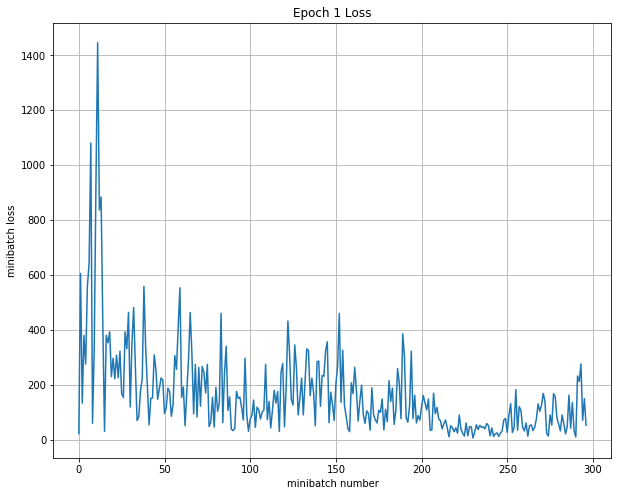

Iteration 300: with minibatch training loss = 14.8 and accuracy of 0.17
Iteration 400: with minibatch training loss = 5.43 and accuracy of 0.17
Iteration 500: with minibatch training loss = 6.8 and accuracy of 0
Epoch 2, Overall loss = 7.73 and accuracy of 0.356


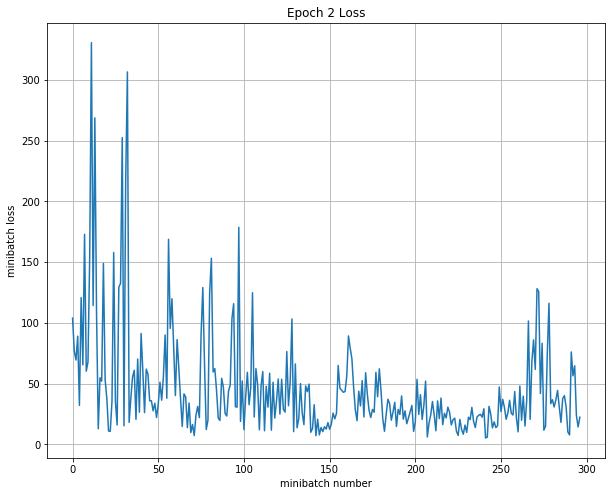

Iteration 600: with minibatch training loss = 5.98 and accuracy of 0.17
Iteration 700: with minibatch training loss = 2.25 and accuracy of 0.5
Iteration 800: with minibatch training loss = 2.79 and accuracy of 0
Epoch 3, Overall loss = 4.06 and accuracy of 0.358


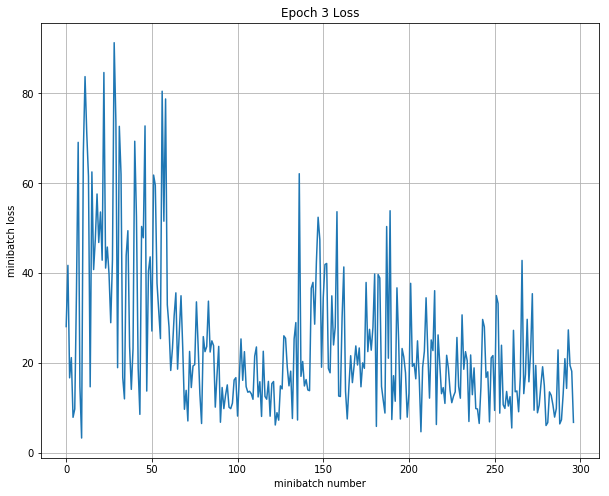

Iteration 900: with minibatch training loss = 1.18 and accuracy of 0.5
Iteration 1000: with minibatch training loss = 2.21 and accuracy of 0.17
Iteration 1100: with minibatch training loss = 0.934 and accuracy of 0.67
Epoch 4, Overall loss = 2 and accuracy of 0.348


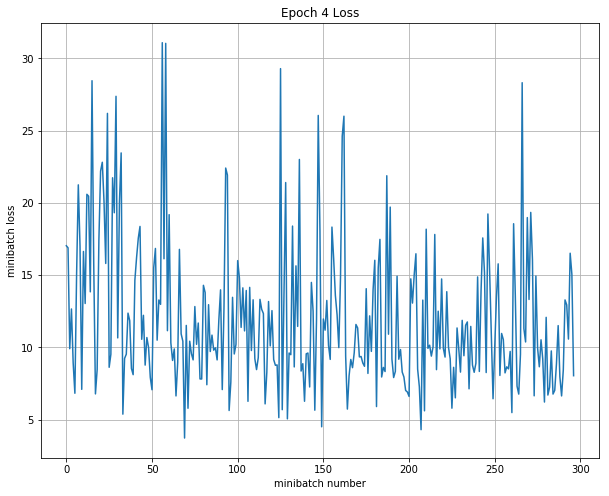

Iteration 1200: with minibatch training loss = 1.55 and accuracy of 0.33
Iteration 1300: with minibatch training loss = 1.24 and accuracy of 0.5
Iteration 1400: with minibatch training loss = 1.42 and accuracy of 0.17
Epoch 5, Overall loss = 1.57 and accuracy of 0.356


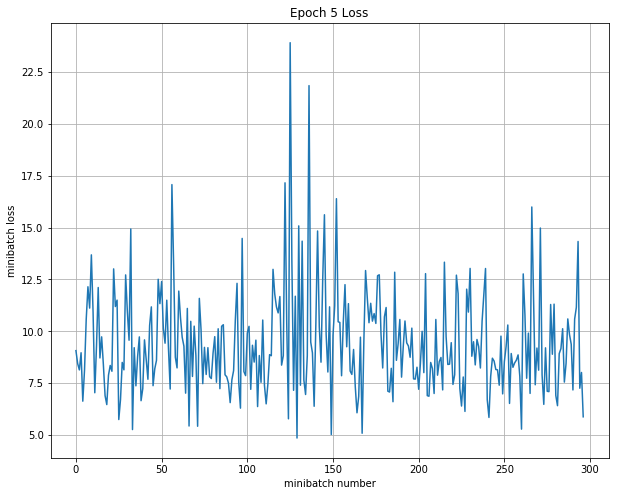

Iteration 1500: with minibatch training loss = 2.22 and accuracy of 0
Iteration 1600: with minibatch training loss = 1.66 and accuracy of 0.33
Iteration 1700: with minibatch training loss = 1.57 and accuracy of 0.33
Epoch 6, Overall loss = 1.46 and accuracy of 0.32


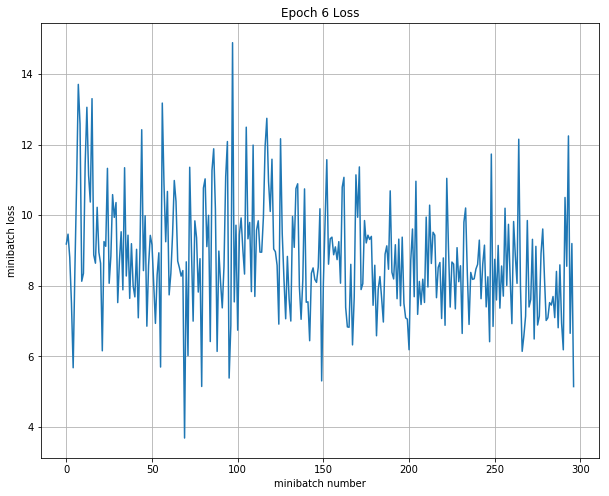

Iteration 1800: with minibatch training loss = 1.34 and accuracy of 0.33
Iteration 1900: with minibatch training loss = 1.42 and accuracy of 0.17
Iteration 2000: with minibatch training loss = 1.35 and accuracy of 0.5
Epoch 7, Overall loss = 1.42 and accuracy of 0.323


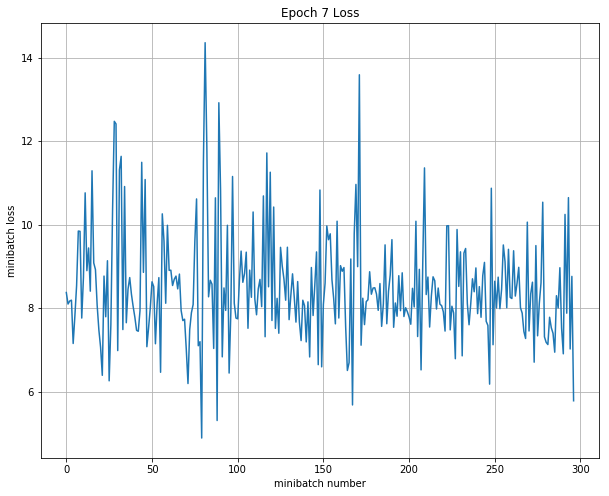

Iteration 2100: with minibatch training loss = 1.26 and accuracy of 0.33
Iteration 2200: with minibatch training loss = 1.61 and accuracy of 0
Iteration 2300: with minibatch training loss = 1.21 and accuracy of 0.5
Epoch 8, Overall loss = 1.4 and accuracy of 0.305


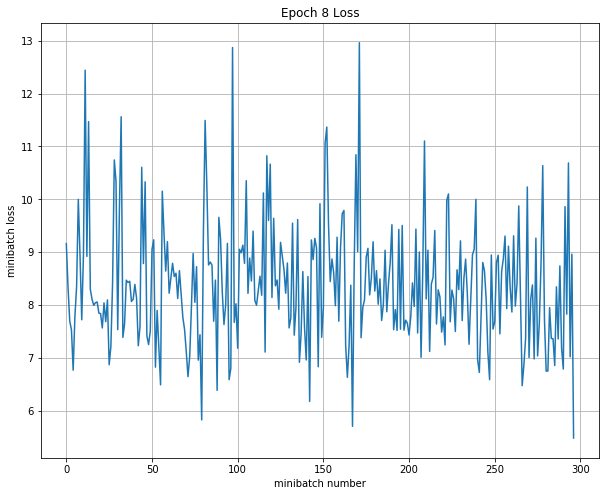

Iteration 2400: with minibatch training loss = 1.38 and accuracy of 0.33
Iteration 2500: with minibatch training loss = 1.17 and accuracy of 0.67
Iteration 2600: with minibatch training loss = 1.29 and accuracy of 0.33
Epoch 9, Overall loss = 1.39 and accuracy of 0.308


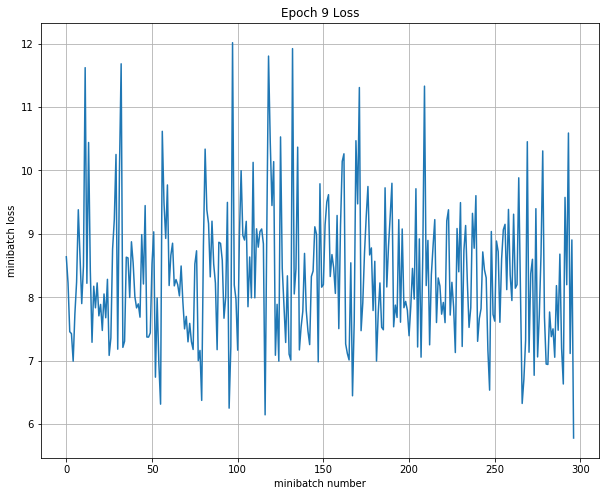

Iteration 2700: with minibatch training loss = 1.46 and accuracy of 0.5
Iteration 2800: with minibatch training loss = 1.39 and accuracy of 0.33
Iteration 2900: with minibatch training loss = 1.22 and accuracy of 0.67
Epoch 10, Overall loss = 1.39 and accuracy of 0.321


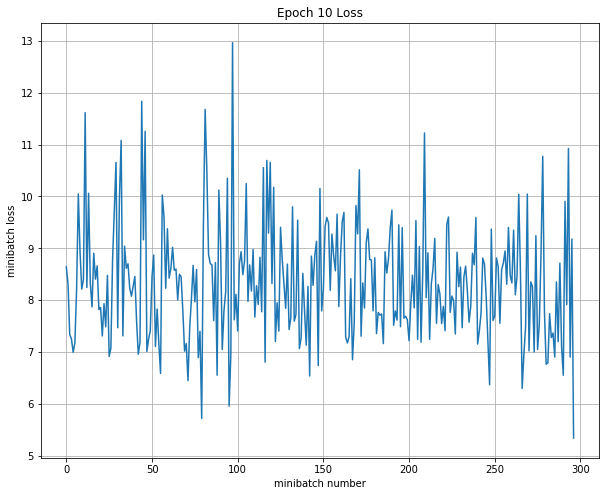

Train all layer
Iteration 0: with minibatch training loss = 1.4 and accuracy of 0.33
Iteration 100: with minibatch training loss = 1.61 and accuracy of 0.33
Iteration 200: with minibatch training loss = 1.27 and accuracy of 0.33
Epoch 1, Overall loss = 2.21 and accuracy of 0.334


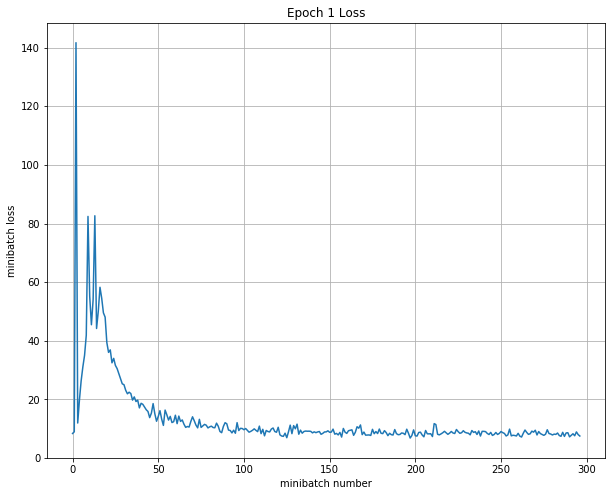

Iteration 300: with minibatch training loss = 1.61 and accuracy of 0.33
Iteration 400: with minibatch training loss = 1.22 and accuracy of 0.33
Iteration 500: with minibatch training loss = 1.43 and accuracy of 0.33
Epoch 2, Overall loss = 1.37 and accuracy of 0.331


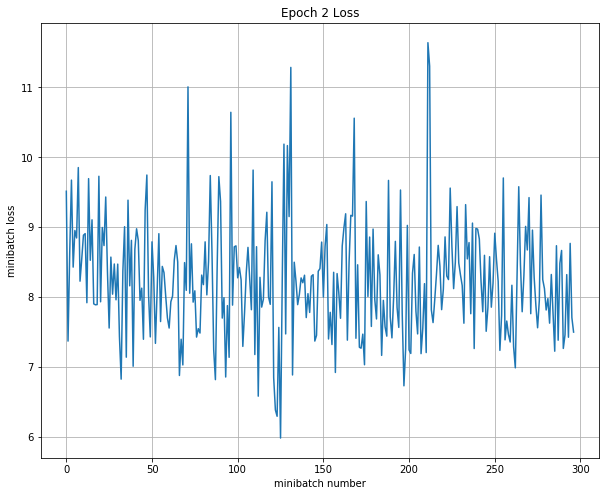

Iteration 600: with minibatch training loss = 1.47 and accuracy of 0.17
Iteration 700: with minibatch training loss = 1.46 and accuracy of 0.5
Iteration 800: with minibatch training loss = 1.42 and accuracy of 0.5
Epoch 3, Overall loss = 1.36 and accuracy of 0.331


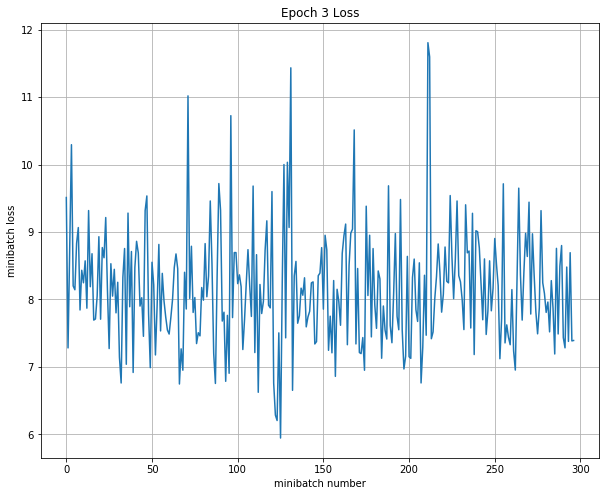

Iteration 900: with minibatch training loss = 1.4 and accuracy of 0.33
Iteration 1000: with minibatch training loss = 1.6 and accuracy of 0.17
Iteration 1100: with minibatch training loss = 1.41 and accuracy of 0.17
Epoch 4, Overall loss = 1.36 and accuracy of 0.328


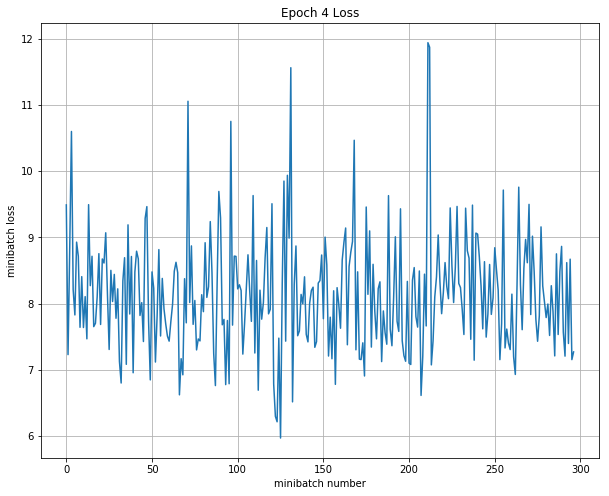

Iteration 1200: with minibatch training loss = 1.2 and accuracy of 0.33
Iteration 1300: with minibatch training loss = 1.12 and accuracy of 0.67
Iteration 1400: with minibatch training loss = 1.99 and accuracy of 0.17
Epoch 5, Overall loss = 1.35 and accuracy of 0.337


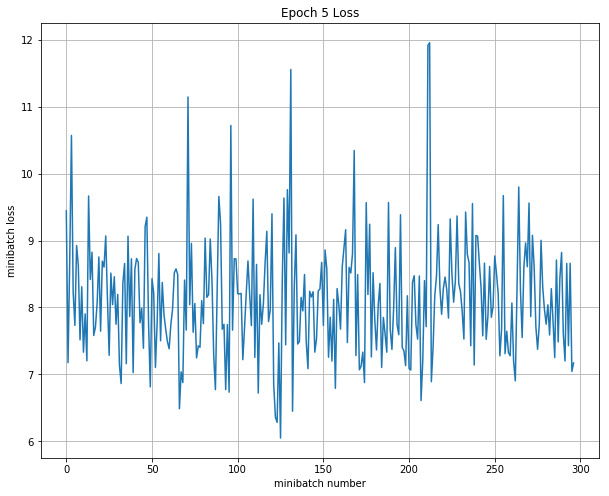

Iteration 1500: with minibatch training loss = 1.48 and accuracy of 0.17
Iteration 1600: with minibatch training loss = 1.34 and accuracy of 0.5
Iteration 1700: with minibatch training loss = 1.37 and accuracy of 0.5
Epoch 6, Overall loss = 1.35 and accuracy of 0.342


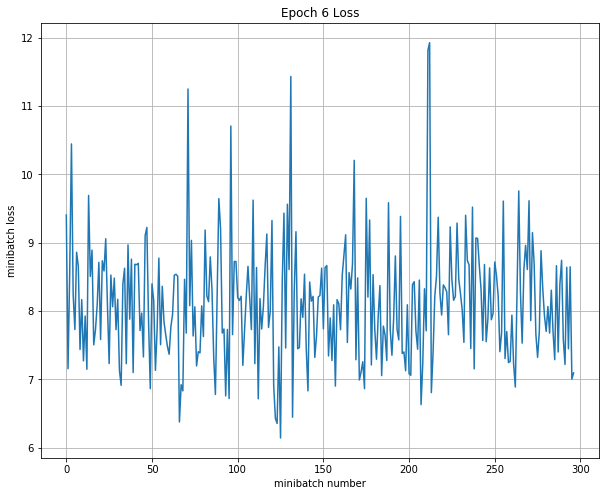

Iteration 1800: with minibatch training loss = 1.35 and accuracy of 0.5
Iteration 1900: with minibatch training loss = 1.29 and accuracy of 0.33
Iteration 2000: with minibatch training loss = 1.38 and accuracy of 0.33
Epoch 7, Overall loss = 1.35 and accuracy of 0.345


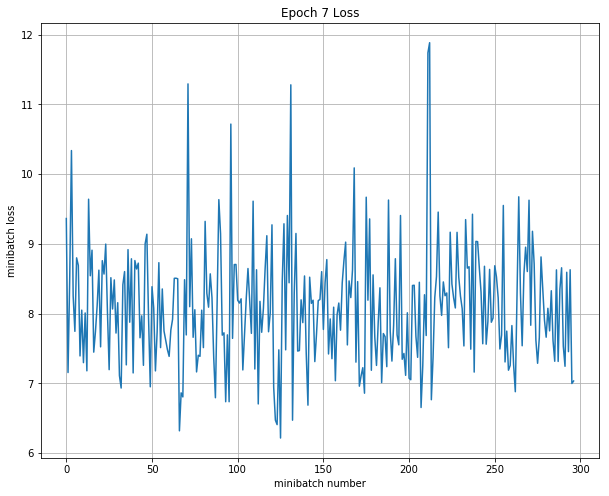

Iteration 2100: with minibatch training loss = 1.46 and accuracy of 0.33
Iteration 2200: with minibatch training loss = 1.16 and accuracy of 0.67
Iteration 2300: with minibatch training loss = 1.37 and accuracy of 0.17
Epoch 8, Overall loss = 1.35 and accuracy of 0.349


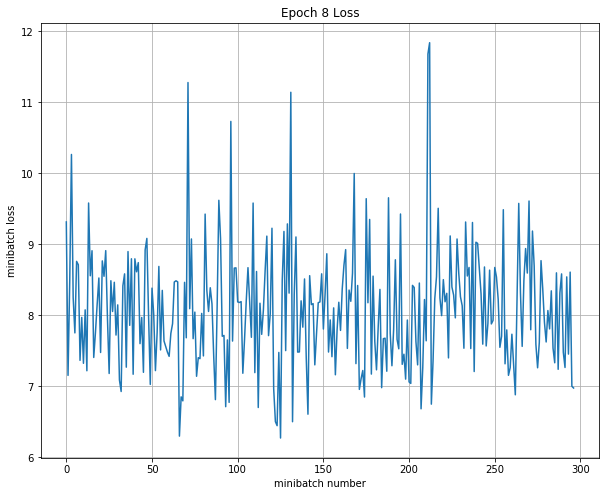

Iteration 2400: with minibatch training loss = 1.32 and accuracy of 0.33
Iteration 2500: with minibatch training loss = 1.25 and accuracy of 0.5
Iteration 2600: with minibatch training loss = 1.51 and accuracy of 0
Epoch 9, Overall loss = 1.35 and accuracy of 0.348


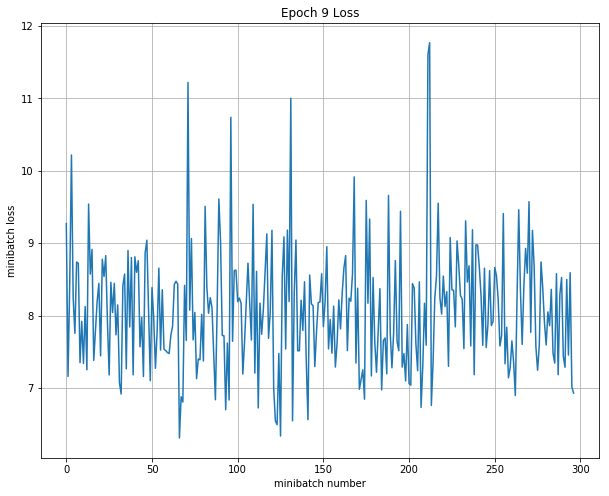

Iteration 2700: with minibatch training loss = 1.34 and accuracy of 0.5
Iteration 2800: with minibatch training loss = 1.5 and accuracy of 0.17
Iteration 2900: with minibatch training loss = 1.29 and accuracy of 0.33
Epoch 10, Overall loss = 1.34 and accuracy of 0.346


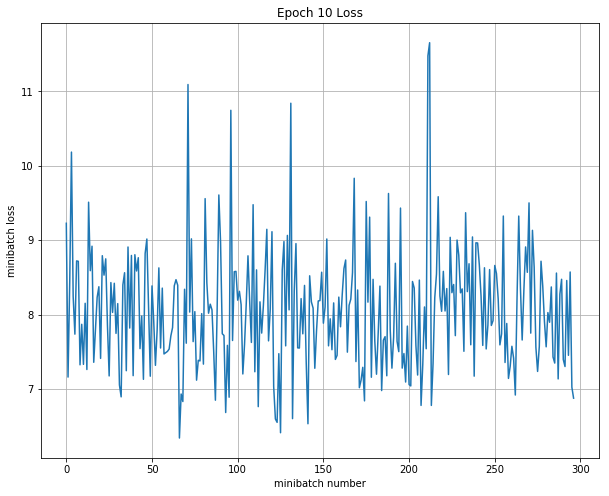

Validation
Epoch 1, Overall loss = 1.34 and accuracy of 0.28
Test
Epoch 1, Overall loss = 1.36 and accuracy of 0.26

--------------------------------------------------------------------------------
Trial number: 1
--------------------------------------------------------------------------------
reg: 0.006854, lr: 0.002168, dr: 0.871229, dc: 519, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 2.34 and accuracy of 0.17
Iteration 100: with minibatch training loss = 75.3 and accuracy of 0.17
Iteration 200: with minibatch training loss = 17.3 and accuracy of 0.33
Epoch 1, Overall loss = 43.1 and accuracy of 0.292


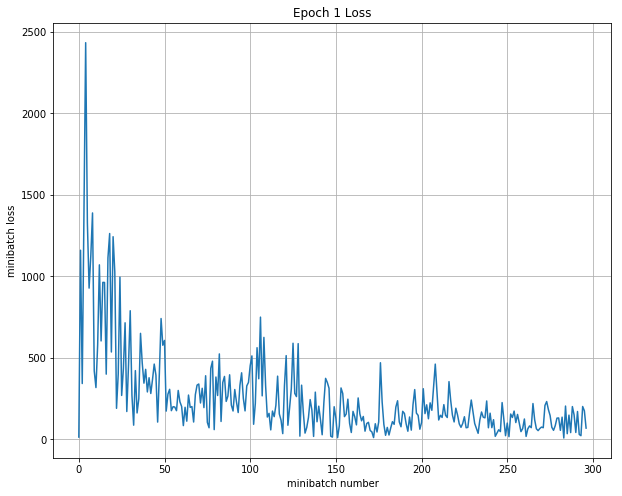

Iteration 300: with minibatch training loss = 37.4 and accuracy of 0
Iteration 400: with minibatch training loss = 8.37 and accuracy of 0.67
Iteration 500: with minibatch training loss = 4.88 and accuracy of 0.33
Epoch 2, Overall loss = 8.07 and accuracy of 0.335


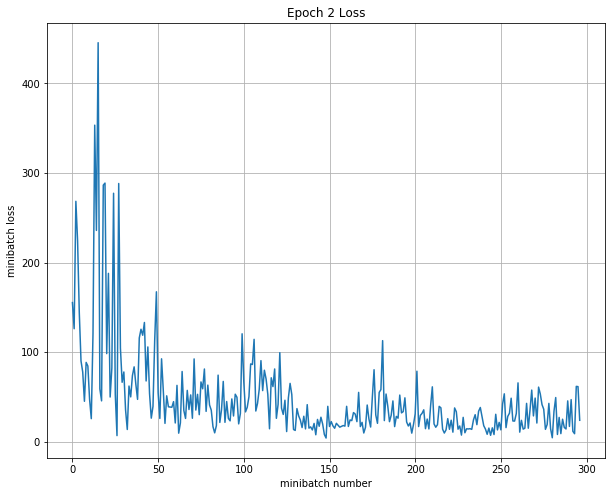

Iteration 600: with minibatch training loss = 4.63 and accuracy of 0.33
Iteration 700: with minibatch training loss = 1.22 and accuracy of 0.83
Iteration 800: with minibatch training loss = 1.8 and accuracy of 0.5
Epoch 3, Overall loss = 2.38 and accuracy of 0.348


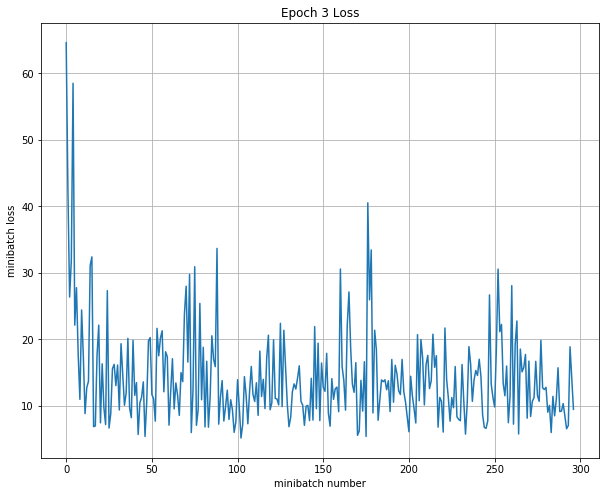

Iteration 900: with minibatch training loss = 2.45 and accuracy of 0.5
Iteration 1000: with minibatch training loss = 1.57 and accuracy of 0.5
Iteration 1100: with minibatch training loss = 1.74 and accuracy of 0.33
Epoch 4, Overall loss = 1.74 and accuracy of 0.345


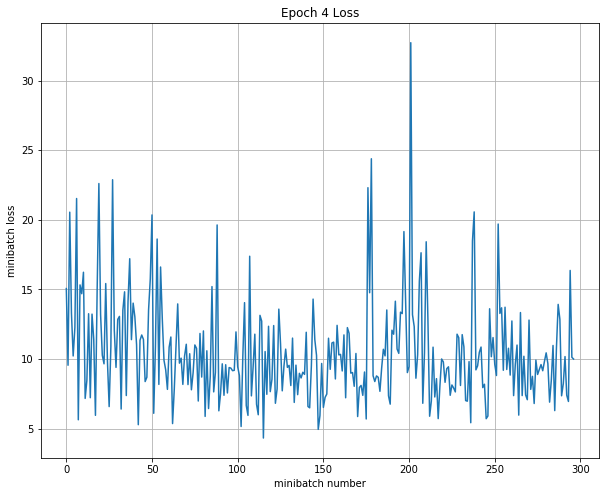

Iteration 1200: with minibatch training loss = 1.24 and accuracy of 0.5
Iteration 1300: with minibatch training loss = 0.912 and accuracy of 0.5
Iteration 1400: with minibatch training loss = 1.38 and accuracy of 0.33
Epoch 5, Overall loss = 1.57 and accuracy of 0.33


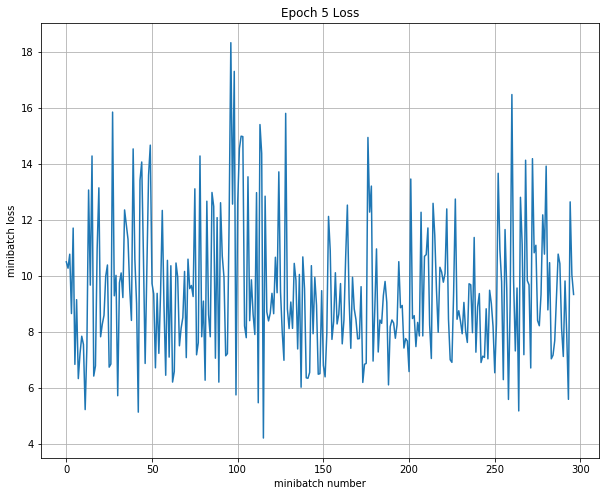

Iteration 1500: with minibatch training loss = 2.16 and accuracy of 0.5
Iteration 1600: with minibatch training loss = 1.07 and accuracy of 0.83
Iteration 1700: with minibatch training loss = 1.52 and accuracy of 0.33
Epoch 6, Overall loss = 1.46 and accuracy of 0.325


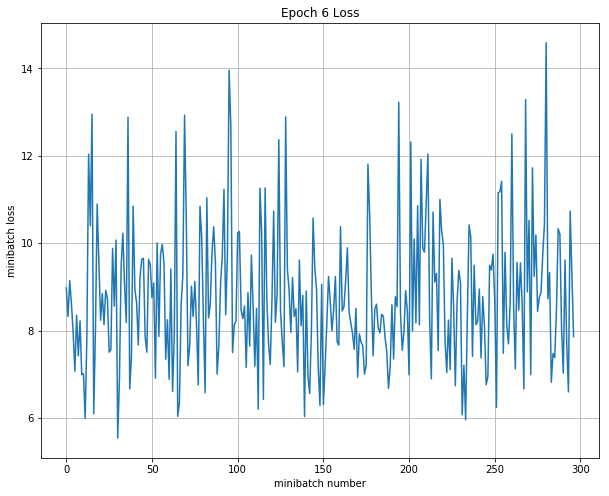

Iteration 1800: with minibatch training loss = 1.67 and accuracy of 0.33
Iteration 1900: with minibatch training loss = 1.32 and accuracy of 0.33
Iteration 2000: with minibatch training loss = 1.62 and accuracy of 0
Epoch 7, Overall loss = 1.42 and accuracy of 0.313


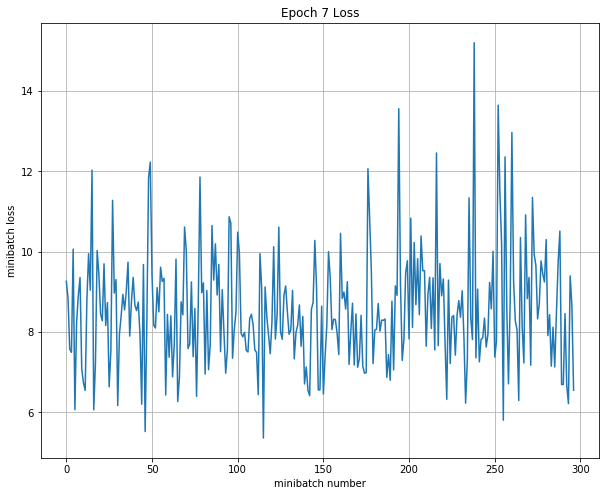

Iteration 2100: with minibatch training loss = 1.39 and accuracy of 0.33
Iteration 2200: with minibatch training loss = 2.22 and accuracy of 0.17
Iteration 2300: with minibatch training loss = 1.36 and accuracy of 0.5
Epoch 8, Overall loss = 1.44 and accuracy of 0.307


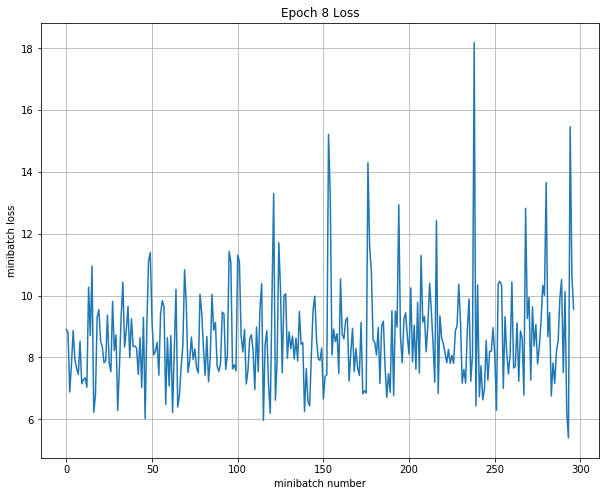

Iteration 2400: with minibatch training loss = 2.04 and accuracy of 0.33
Iteration 2500: with minibatch training loss = 1.87 and accuracy of 0.17
Iteration 2600: with minibatch training loss = 1.25 and accuracy of 0.33
Epoch 9, Overall loss = 1.48 and accuracy of 0.29


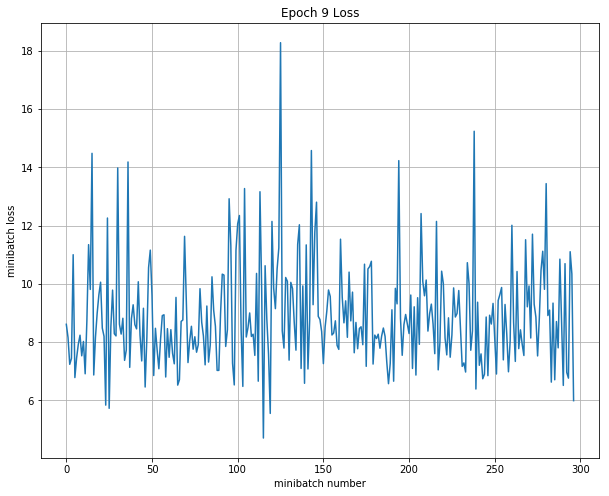

Iteration 2700: with minibatch training loss = 2.7 and accuracy of 0.33
Iteration 2800: with minibatch training loss = 1.4 and accuracy of 0.67
Iteration 2900: with minibatch training loss = 1.86 and accuracy of 0.33
Epoch 10, Overall loss = 1.55 and accuracy of 0.29


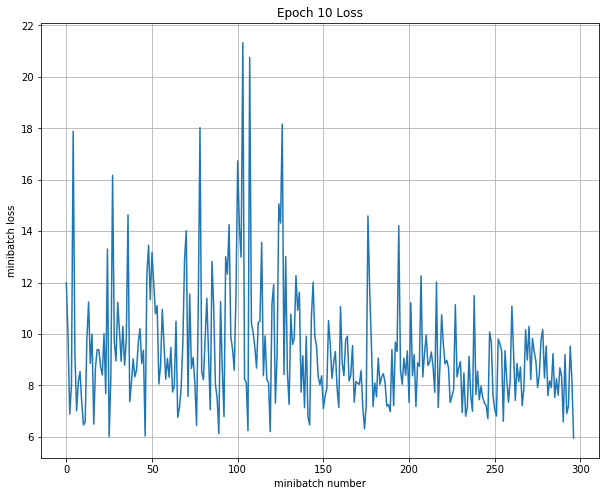

Train all layer
Iteration 0: with minibatch training loss = 1.56 and accuracy of 0.17
Iteration 100: with minibatch training loss = 30.4 and accuracy of 0.17
Iteration 200: with minibatch training loss = 16 and accuracy of 0.33
Epoch 1, Overall loss = 31.9 and accuracy of 0.265


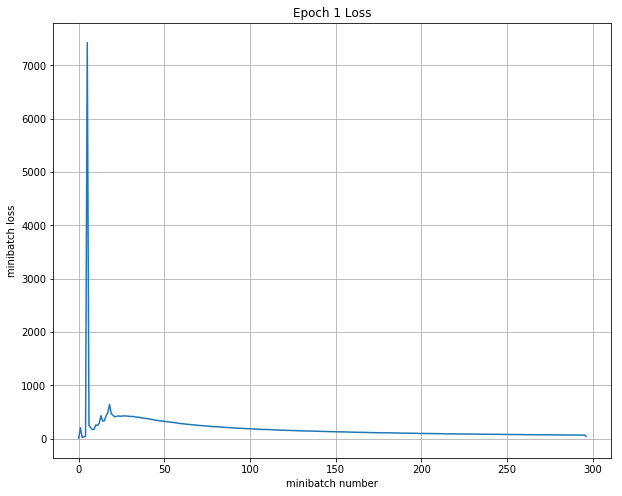

Iteration 300: with minibatch training loss = 10.5 and accuracy of 0.17
Iteration 400: with minibatch training loss = 7.75 and accuracy of 0.17
Iteration 500: with minibatch training loss = 6.01 and accuracy of 0.33
Epoch 2, Overall loss = 7.06 and accuracy of 0.327


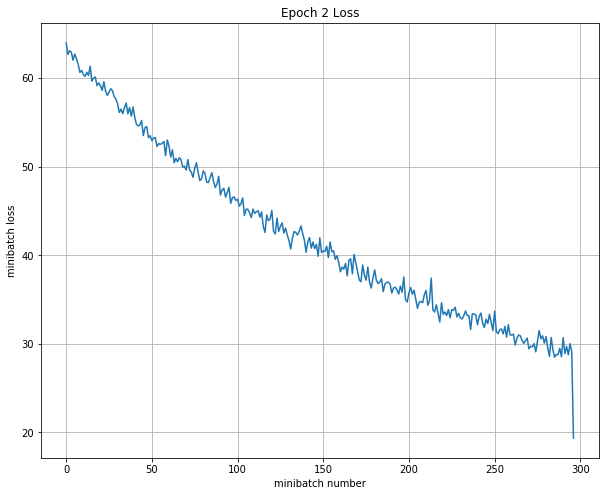

Iteration 600: with minibatch training loss = 4.7 and accuracy of 0.33
Iteration 700: with minibatch training loss = 3.97 and accuracy of 0.33
Iteration 800: with minibatch training loss = 3.3 and accuracy of 0.33
Epoch 3, Overall loss = 3.77 and accuracy of 0.329


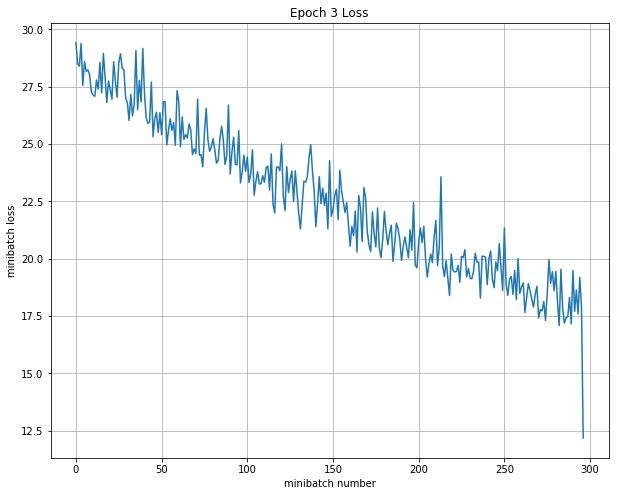

Iteration 900: with minibatch training loss = 2.76 and accuracy of 0.33
Iteration 1000: with minibatch training loss = 2.6 and accuracy of 0.17
Iteration 1100: with minibatch training loss = 2.48 and accuracy of 0.17
Epoch 4, Overall loss = 2.55 and accuracy of 0.328


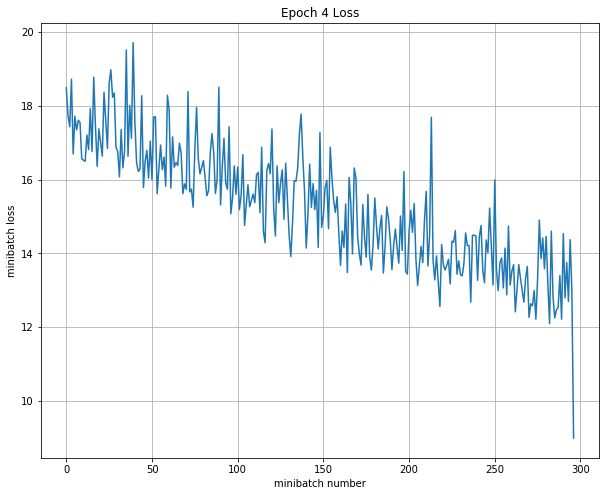

Iteration 1200: with minibatch training loss = 2.09 and accuracy of 0.17
Iteration 1300: with minibatch training loss = 2.08 and accuracy of 0.17
Iteration 1400: with minibatch training loss = 1.93 and accuracy of 0.33
Epoch 5, Overall loss = 1.97 and accuracy of 0.324


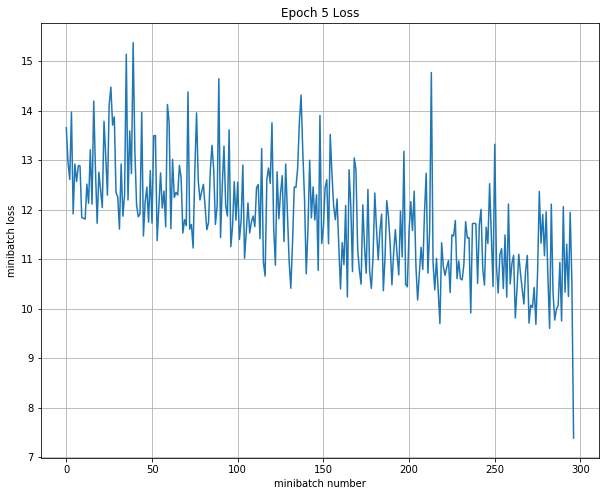

Iteration 1500: with minibatch training loss = 1.63 and accuracy of 0.33
Iteration 1600: with minibatch training loss = 1.51 and accuracy of 0.5
Iteration 1700: with minibatch training loss = 1.48 and accuracy of 0.5
Epoch 6, Overall loss = 1.67 and accuracy of 0.322


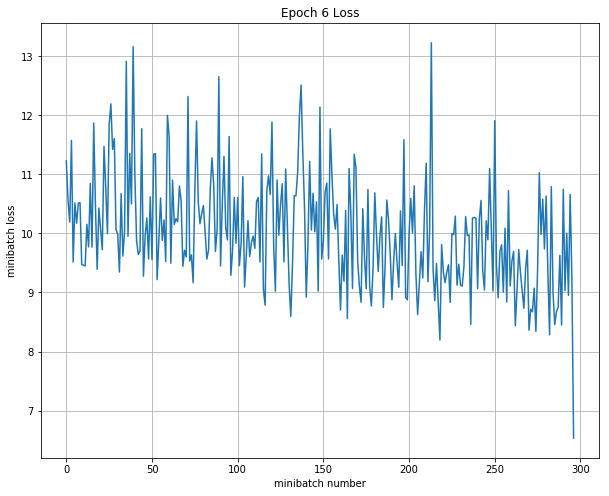

Iteration 1800: with minibatch training loss = 1.36 and accuracy of 0.17
Iteration 1900: with minibatch training loss = 1.66 and accuracy of 0.5
Iteration 2000: with minibatch training loss = 1.23 and accuracy of 0.83
Epoch 7, Overall loss = 1.51 and accuracy of 0.322


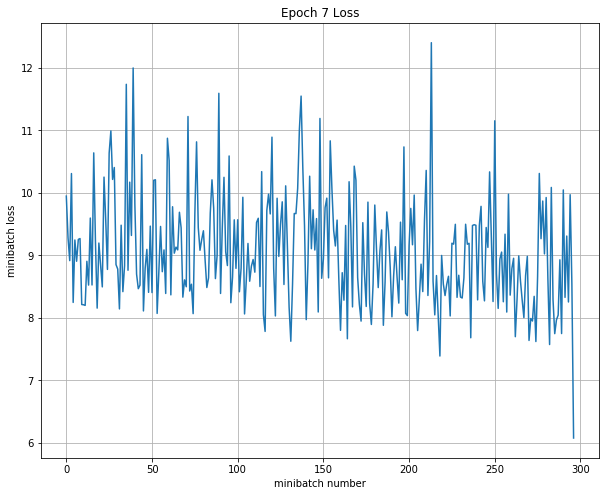

Iteration 2100: with minibatch training loss = 1.3 and accuracy of 0.33
Iteration 2200: with minibatch training loss = 1.38 and accuracy of 0.67
Iteration 2300: with minibatch training loss = 1.32 and accuracy of 0.33
Epoch 8, Overall loss = 1.43 and accuracy of 0.322


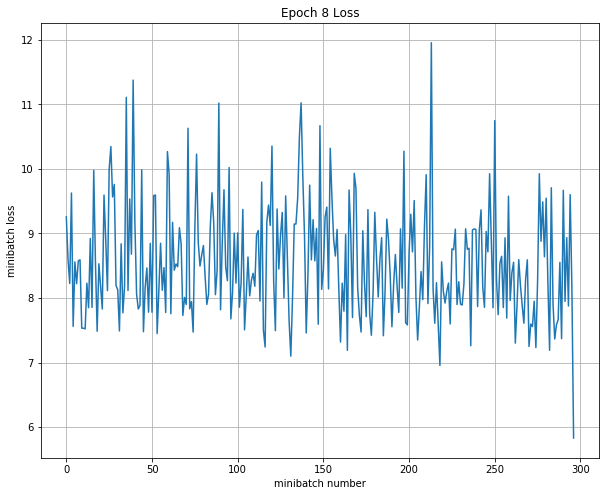

Iteration 2400: with minibatch training loss = 1.29 and accuracy of 0.5
Iteration 2500: with minibatch training loss = 1.36 and accuracy of 0.5
Iteration 2600: with minibatch training loss = 1.23 and accuracy of 0.5
Epoch 9, Overall loss = 1.38 and accuracy of 0.32


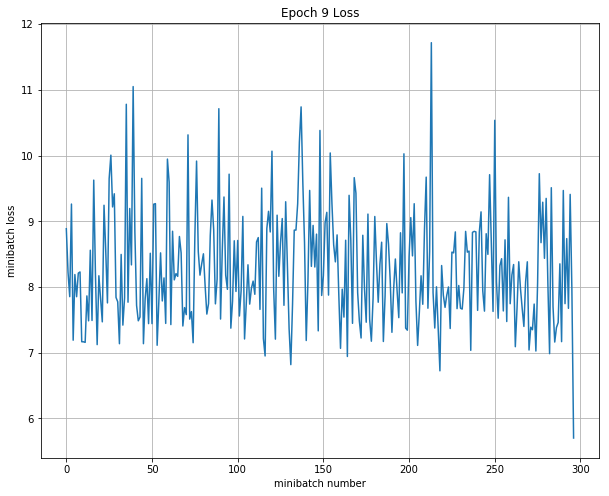

Iteration 2700: with minibatch training loss = 1.51 and accuracy of 0.17
Iteration 2800: with minibatch training loss = 1.26 and accuracy of 0.33
Iteration 2900: with minibatch training loss = 1.45 and accuracy of 0.17
Epoch 10, Overall loss = 1.36 and accuracy of 0.32


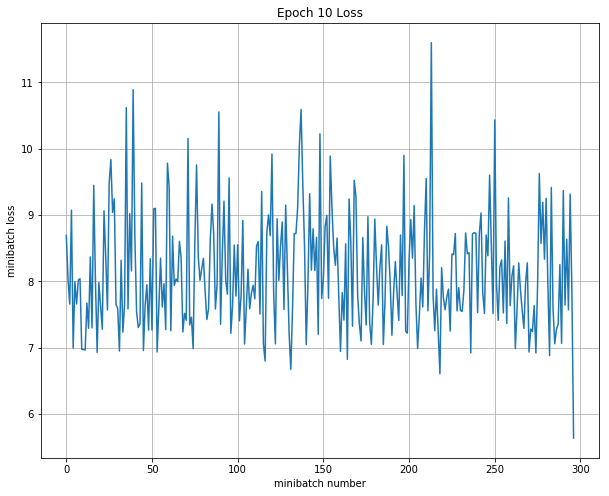

Validation
Epoch 1, Overall loss = 1.36 and accuracy of 0.3
Test
Epoch 1, Overall loss = 1.36 and accuracy of 0.36

--------------------------------------------------------------------------------
Trial number: 2
--------------------------------------------------------------------------------
reg: 0.040208, lr: 0.002862, dr: 0.822017, dc: 912, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 5.69 and accuracy of 0.17
Iteration 100: with minibatch training loss = 44.3 and accuracy of 0
Iteration 200: with minibatch training loss = 5.94 and accuracy of 0.5
Epoch 1, Overall loss = 35.1 and accuracy of 0.265


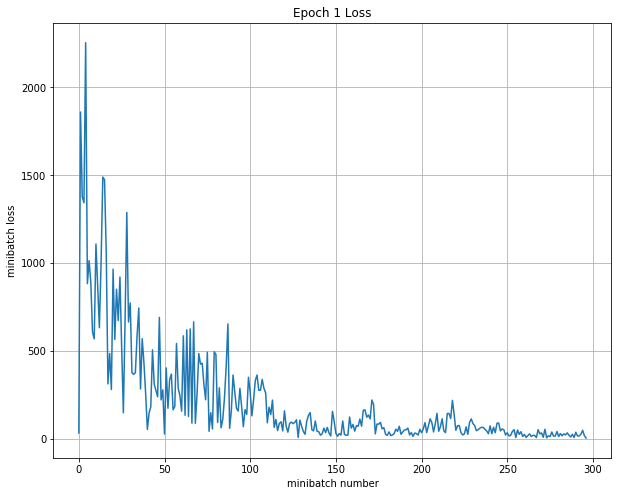

Iteration 300: with minibatch training loss = 1.39 and accuracy of 0.5
Iteration 400: with minibatch training loss = 3.15 and accuracy of 0.33
Iteration 500: with minibatch training loss = 1.19 and accuracy of 0.5
Epoch 2, Overall loss = 2.09 and accuracy of 0.287


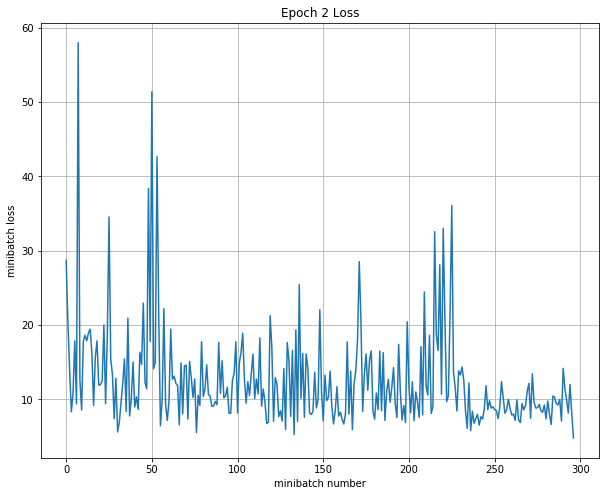

Iteration 600: with minibatch training loss = 1.82 and accuracy of 0
Iteration 700: with minibatch training loss = 2.1 and accuracy of 0.17
Iteration 800: with minibatch training loss = 1.45 and accuracy of 0.33
Epoch 3, Overall loss = 1.53 and accuracy of 0.292


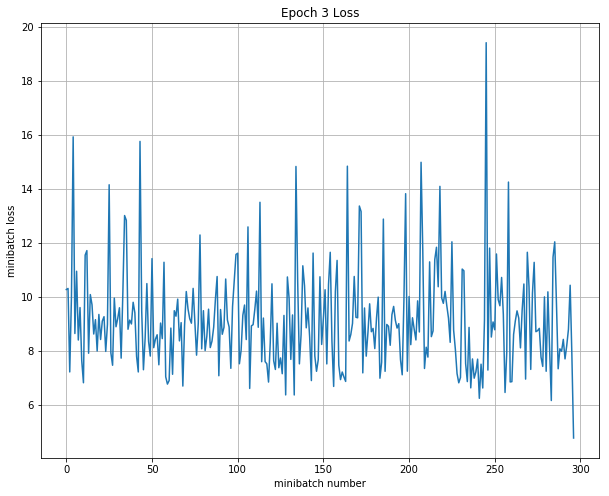

Iteration 900: with minibatch training loss = 1.62 and accuracy of 0.33
Iteration 1000: with minibatch training loss = 1.73 and accuracy of 0.17
Iteration 1100: with minibatch training loss = 1.28 and accuracy of 0.17
Epoch 4, Overall loss = 1.48 and accuracy of 0.297


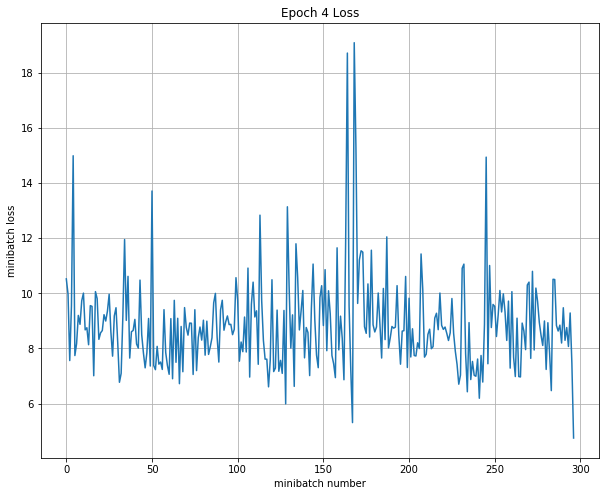

Iteration 1200: with minibatch training loss = 1.49 and accuracy of 0.33
Iteration 1300: with minibatch training loss = 1.23 and accuracy of 0.5
Iteration 1400: with minibatch training loss = 1.48 and accuracy of 0.5
Epoch 5, Overall loss = 1.5 and accuracy of 0.292


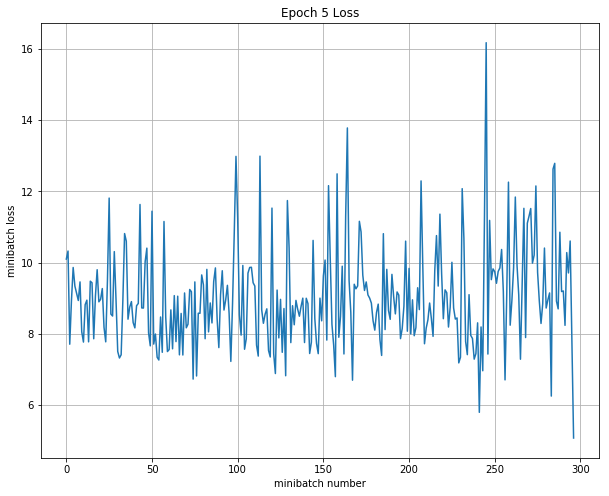

Iteration 1500: with minibatch training loss = 1.49 and accuracy of 0.17
Iteration 1600: with minibatch training loss = 1.45 and accuracy of 0.5
Iteration 1700: with minibatch training loss = 1.63 and accuracy of 0.33
Epoch 6, Overall loss = 1.62 and accuracy of 0.302


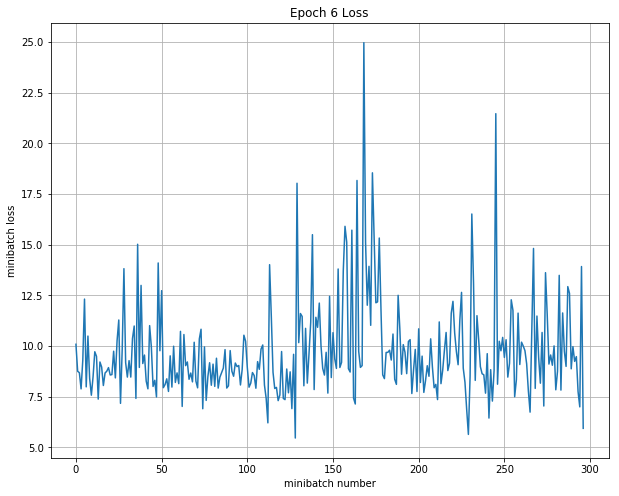

Iteration 1800: with minibatch training loss = 1.54 and accuracy of 0.17
Iteration 1900: with minibatch training loss = 1.42 and accuracy of 0
Iteration 2000: with minibatch training loss = 1.94 and accuracy of 0.17
Epoch 7, Overall loss = 1.6 and accuracy of 0.313


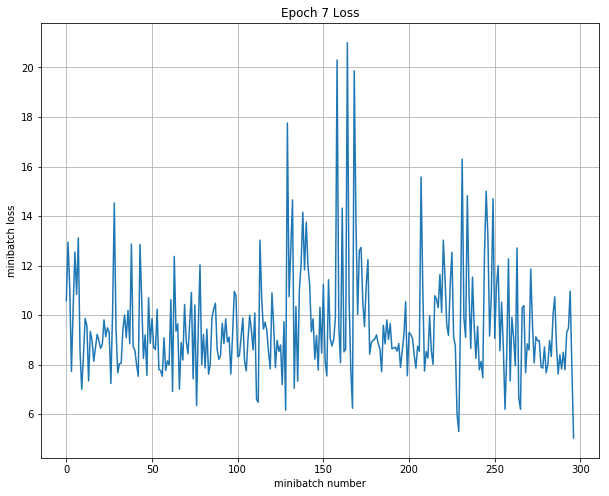

Iteration 2100: with minibatch training loss = 1.36 and accuracy of 0.5
Iteration 2200: with minibatch training loss = 1.49 and accuracy of 0.5
Iteration 2300: with minibatch training loss = 1.85 and accuracy of 0.17
Epoch 8, Overall loss = 2.01 and accuracy of 0.31


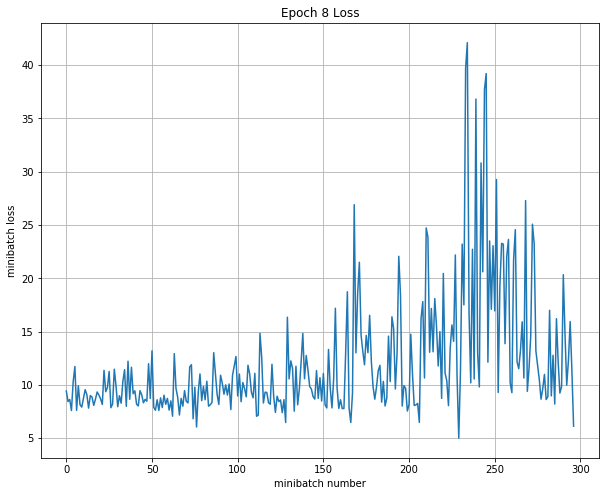

Iteration 2400: with minibatch training loss = 1.77 and accuracy of 0.17
Iteration 2500: with minibatch training loss = 1.45 and accuracy of 0.17
Iteration 2600: with minibatch training loss = 1.49 and accuracy of 0.17
Epoch 9, Overall loss = 1.71 and accuracy of 0.302


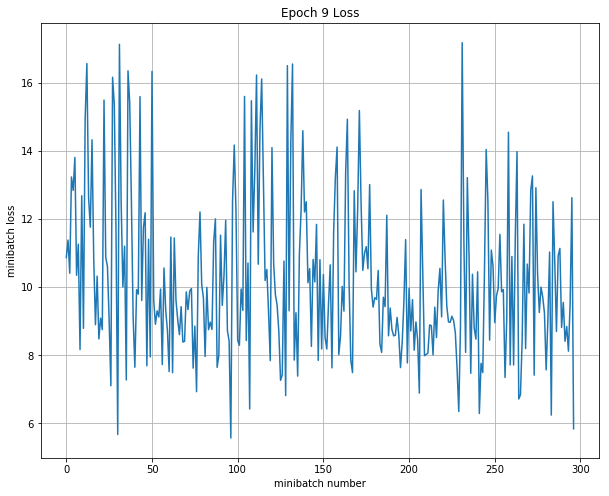

Iteration 2700: with minibatch training loss = 1.71 and accuracy of 0.33
Iteration 2800: with minibatch training loss = 1.98 and accuracy of 0.17
Iteration 2900: with minibatch training loss = 1.37 and accuracy of 0.33
Epoch 10, Overall loss = 1.69 and accuracy of 0.302


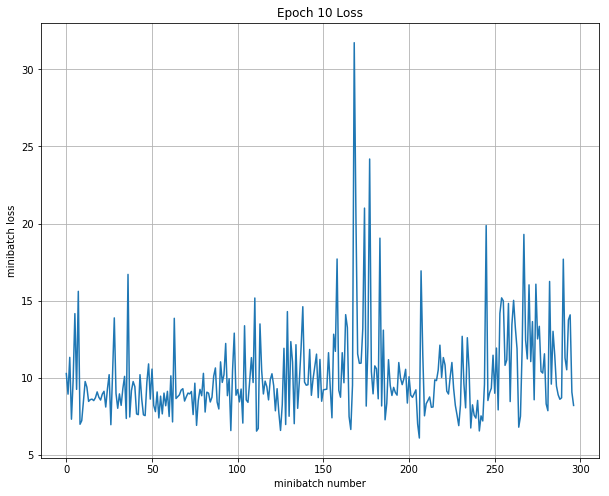

Train all layer
Iteration 0: with minibatch training loss = 1.61 and accuracy of 0.33
Iteration 100: with minibatch training loss = 1.92 and accuracy of 0
Iteration 200: with minibatch training loss = 1.32 and accuracy of 0.33
Epoch 1, Overall loss = 13 and accuracy of 0.314


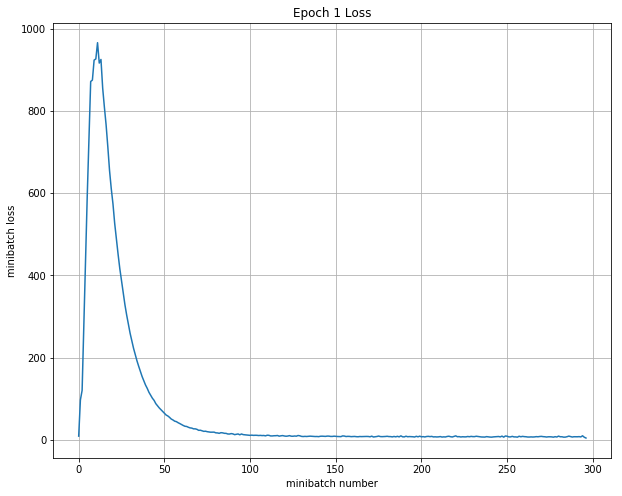

Iteration 300: with minibatch training loss = 1.16 and accuracy of 0.5
Iteration 400: with minibatch training loss = 1.35 and accuracy of 0.5
Iteration 500: with minibatch training loss = 1.43 and accuracy of 0.33
Epoch 2, Overall loss = 1.37 and accuracy of 0.333


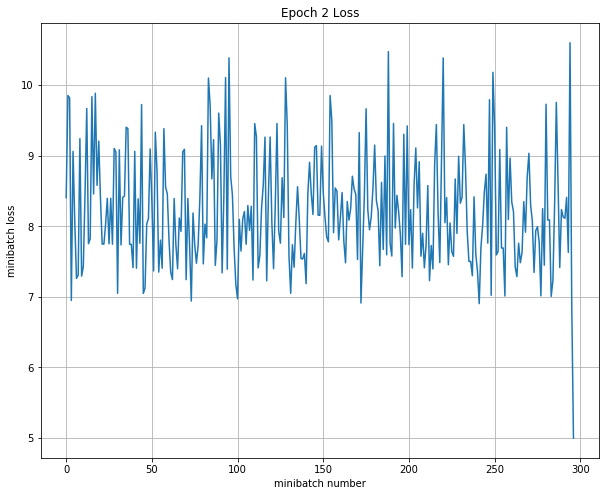

Iteration 600: with minibatch training loss = 1.21 and accuracy of 0.67
Iteration 700: with minibatch training loss = 1.38 and accuracy of 0.5
Iteration 800: with minibatch training loss = 1.48 and accuracy of 0.17
Epoch 3, Overall loss = 1.37 and accuracy of 0.332


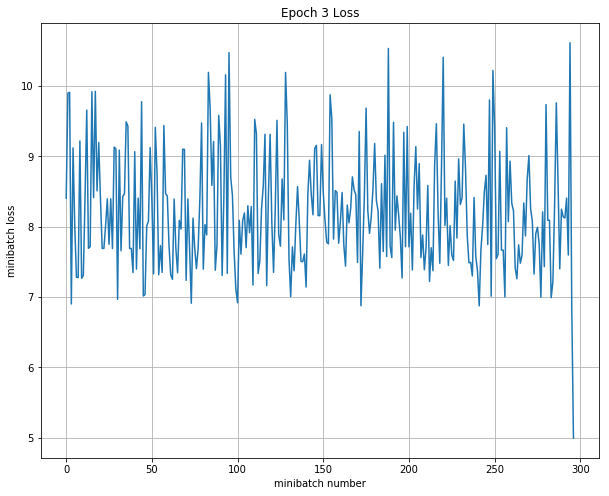

Iteration 900: with minibatch training loss = 1.21 and accuracy of 0.5
Iteration 1000: with minibatch training loss = 1.19 and accuracy of 0.5
Iteration 1100: with minibatch training loss = 1.23 and accuracy of 0.5
Epoch 4, Overall loss = 1.37 and accuracy of 0.331


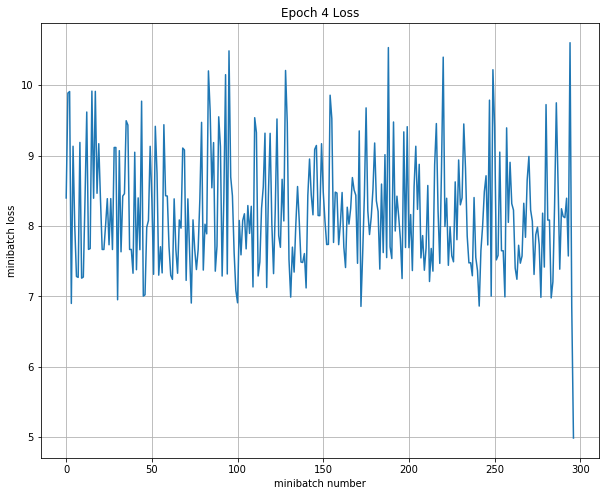

Iteration 1200: with minibatch training loss = 1.6 and accuracy of 0.17
Iteration 1300: with minibatch training loss = 1.21 and accuracy of 0.33
Iteration 1400: with minibatch training loss = 1.2 and accuracy of 0.5
Epoch 5, Overall loss = 1.37 and accuracy of 0.331


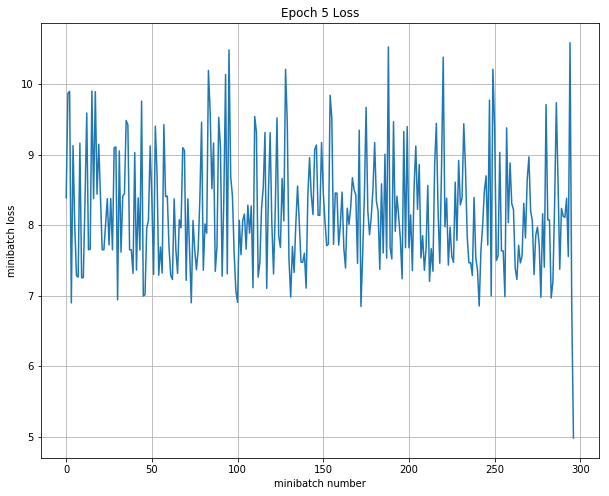

Iteration 1500: with minibatch training loss = 1.65 and accuracy of 0
Iteration 1600: with minibatch training loss = 1.42 and accuracy of 0.17
Iteration 1700: with minibatch training loss = 1.47 and accuracy of 0
Epoch 6, Overall loss = 1.36 and accuracy of 0.331


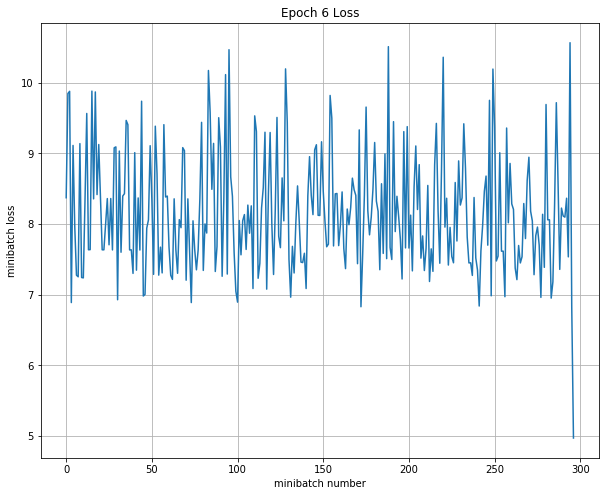

Iteration 1800: with minibatch training loss = 1.4 and accuracy of 0.17
Iteration 1900: with minibatch training loss = 1.4 and accuracy of 0.5
Iteration 2000: with minibatch training loss = 1.24 and accuracy of 0.33
Epoch 7, Overall loss = 1.36 and accuracy of 0.334


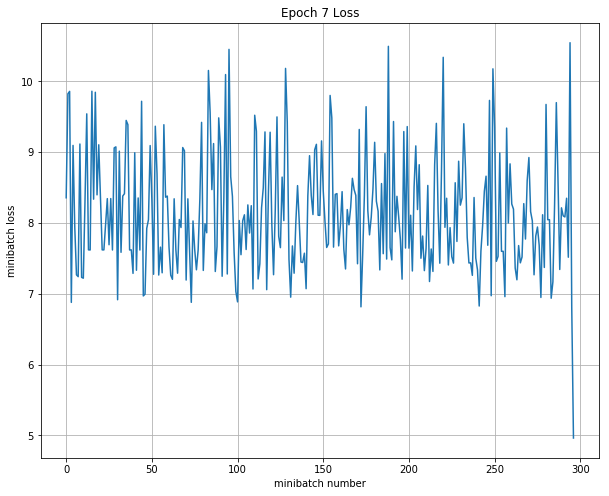

Iteration 2100: with minibatch training loss = 1.27 and accuracy of 0.33
Iteration 2200: with minibatch training loss = 1.21 and accuracy of 0.5
Iteration 2300: with minibatch training loss = 1.32 and accuracy of 0.17
Epoch 8, Overall loss = 1.36 and accuracy of 0.333


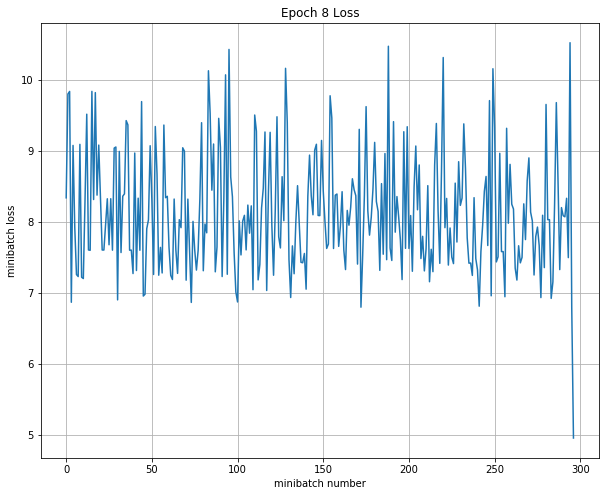

Iteration 2400: with minibatch training loss = 1.38 and accuracy of 0.33
Iteration 2500: with minibatch training loss = 1.3 and accuracy of 0.17
Iteration 2600: with minibatch training loss = 1.32 and accuracy of 0.17
Epoch 9, Overall loss = 1.35 and accuracy of 0.333


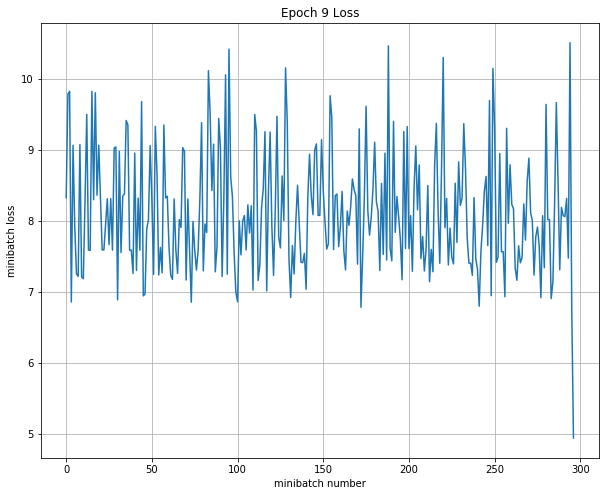

Iteration 2700: with minibatch training loss = 1.26 and accuracy of 0.33
Iteration 2800: with minibatch training loss = 1.33 and accuracy of 0.17
Iteration 2900: with minibatch training loss = 1.42 and accuracy of 0.33
Epoch 10, Overall loss = 1.35 and accuracy of 0.333


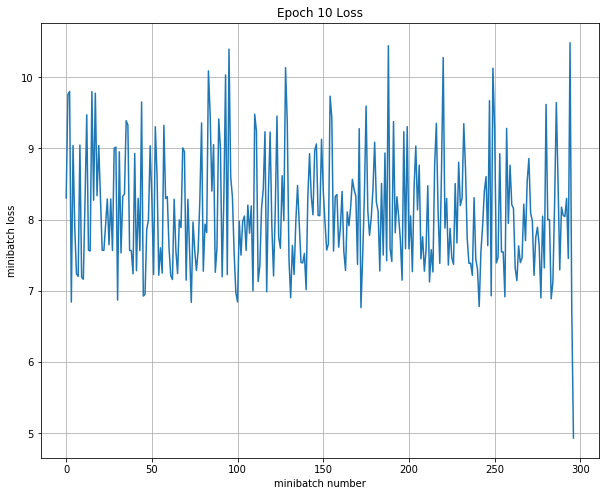

Validation
Epoch 1, Overall loss = 1.36 and accuracy of 0.28
Test
Epoch 1, Overall loss = 1.36 and accuracy of 0.26

--------------------------------------------------------------------------------
Trial number: 3
--------------------------------------------------------------------------------
reg: 0.673943, lr: 0.000001, dr: 0.786292, dc: 689, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 71.6 and accuracy of 0.33
Iteration 100: with minibatch training loss = 67.2 and accuracy of 0.33
Iteration 200: with minibatch training loss = 63.5 and accuracy of 0.67
Epoch 1, Overall loss = 65.6 and accuracy of 0.324


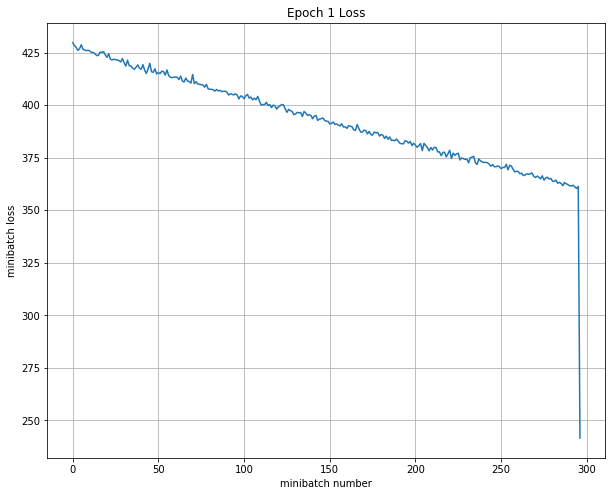

Iteration 300: with minibatch training loss = 59.9 and accuracy of 0.17
Iteration 400: with minibatch training loss = 56.7 and accuracy of 0.33
Iteration 500: with minibatch training loss = 53.8 and accuracy of 0.17
Epoch 2, Overall loss = 55.3 and accuracy of 0.335


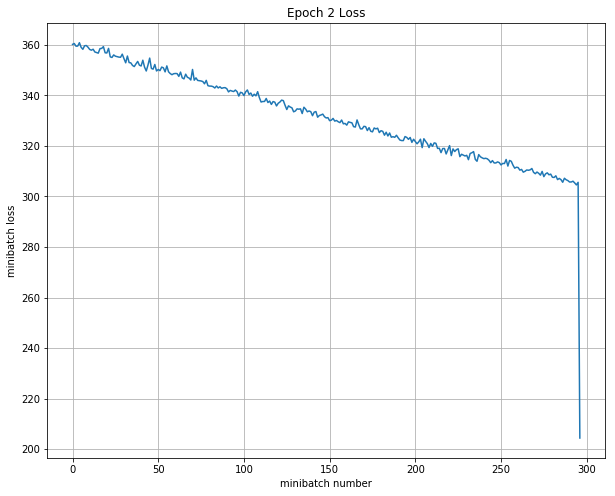

Iteration 600: with minibatch training loss = 50.5 and accuracy of 0.83
Iteration 700: with minibatch training loss = 48.1 and accuracy of 0.17
Iteration 800: with minibatch training loss = 45.5 and accuracy of 0.17
Epoch 3, Overall loss = 46.9 and accuracy of 0.347


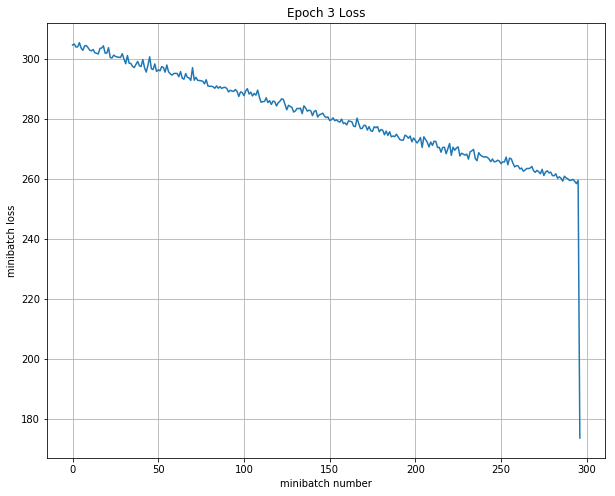

Iteration 900: with minibatch training loss = 43 and accuracy of 0.17
Iteration 1000: with minibatch training loss = 40.7 and accuracy of 0.33
Iteration 1100: with minibatch training loss = 38.6 and accuracy of 0.5
Epoch 4, Overall loss = 39.9 and accuracy of 0.356


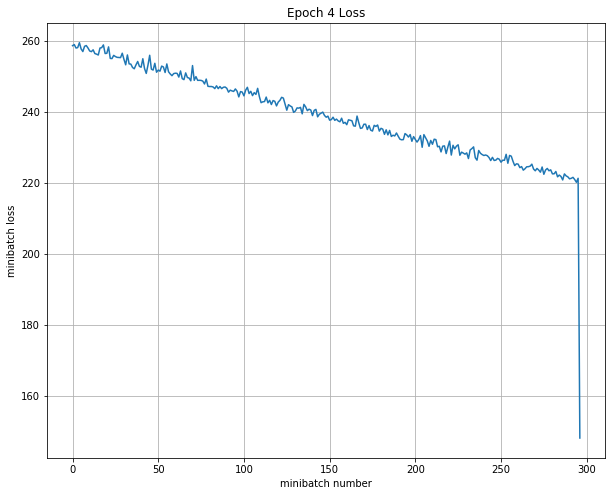

Iteration 1200: with minibatch training loss = 36.6 and accuracy of 0.5
Iteration 1300: with minibatch training loss = 34.5 and accuracy of 0.33
Iteration 1400: with minibatch training loss = 33.1 and accuracy of 0
Epoch 5, Overall loss = 34.1 and accuracy of 0.363


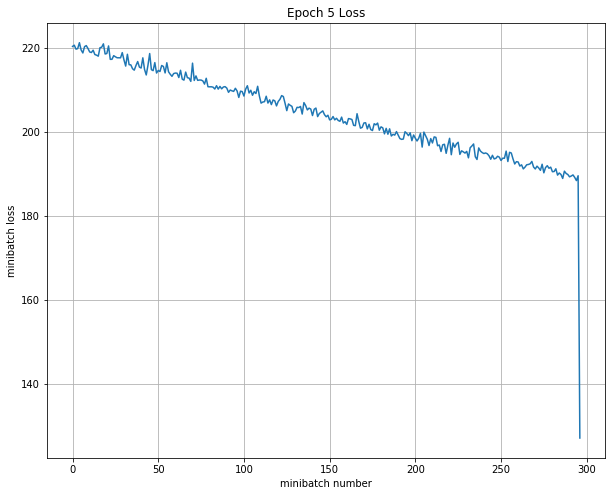

Iteration 1500: with minibatch training loss = 31.1 and accuracy of 0.5
Iteration 1600: with minibatch training loss = 29.7 and accuracy of 0.5
Iteration 1700: with minibatch training loss = 28 and accuracy of 0.67
Epoch 6, Overall loss = 29.3 and accuracy of 0.368


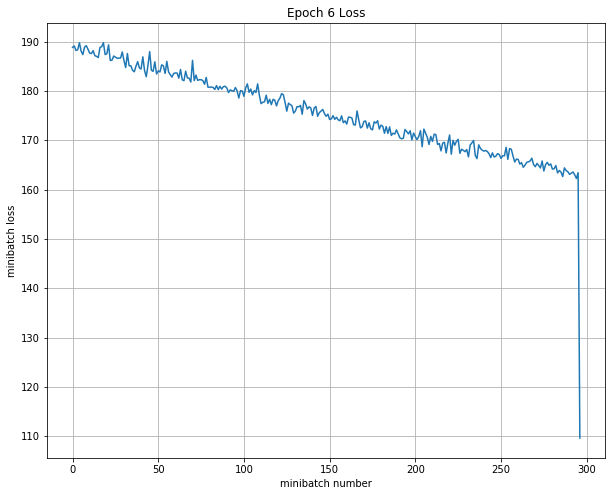

Iteration 1800: with minibatch training loss = 27.3 and accuracy of 0.17
Iteration 1900: with minibatch training loss = 25.6 and accuracy of 0.5
Iteration 2000: with minibatch training loss = 24.1 and accuracy of 1
Epoch 7, Overall loss = 25.3 and accuracy of 0.37


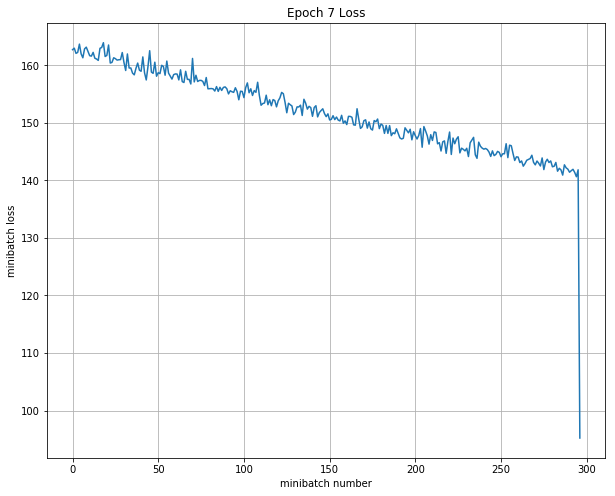

Iteration 2100: with minibatch training loss = 23.7 and accuracy of 0.17
Iteration 2200: with minibatch training loss = 22.4 and accuracy of 0.33
Iteration 2300: with minibatch training loss = 21 and accuracy of 0.67
Epoch 8, Overall loss = 22 and accuracy of 0.376


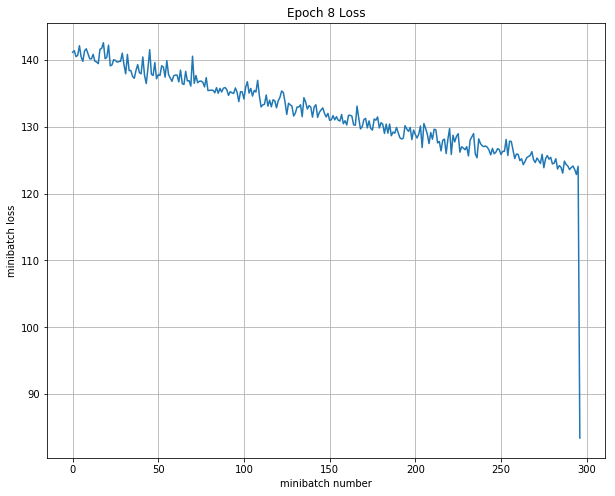

Iteration 2400: with minibatch training loss = 20.4 and accuracy of 0.17
Iteration 2500: with minibatch training loss = 19.6 and accuracy of 0
Iteration 2600: with minibatch training loss = 18.9 and accuracy of 0.33
Epoch 9, Overall loss = 19.4 and accuracy of 0.379


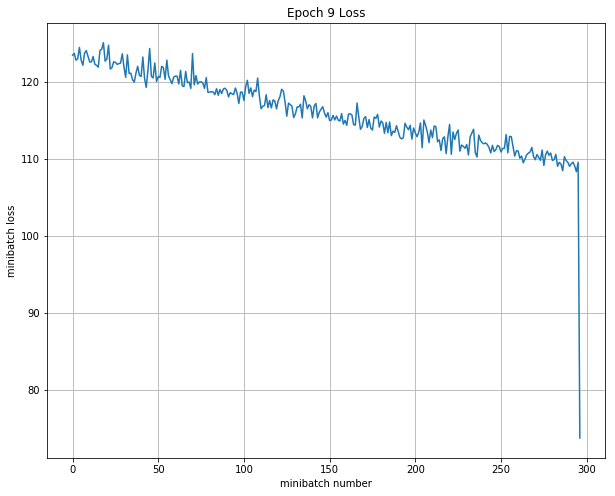

Iteration 2700: with minibatch training loss = 18 and accuracy of 0.33
Iteration 2800: with minibatch training loss = 17.3 and accuracy of 0.67
Iteration 2900: with minibatch training loss = 16.6 and accuracy of 0.17
Epoch 10, Overall loss = 17.2 and accuracy of 0.384


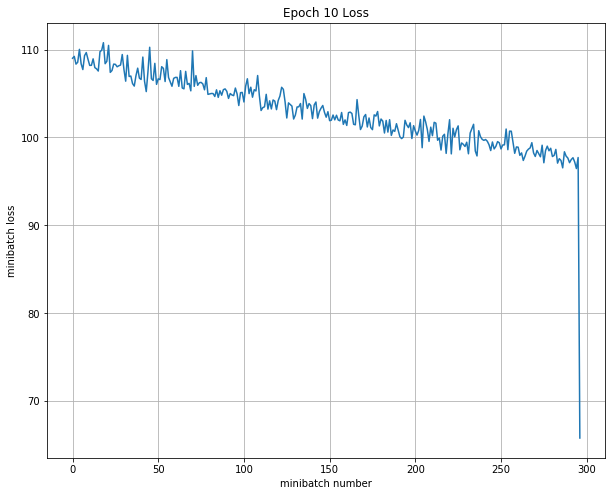

Train all layer
Iteration 0: with minibatch training loss = 16.4 and accuracy of 0.17
Iteration 100: with minibatch training loss = 15.6 and accuracy of 0.33
Iteration 200: with minibatch training loss = 15.3 and accuracy of 0.17
Epoch 1, Overall loss = 15.4 and accuracy of 0.397


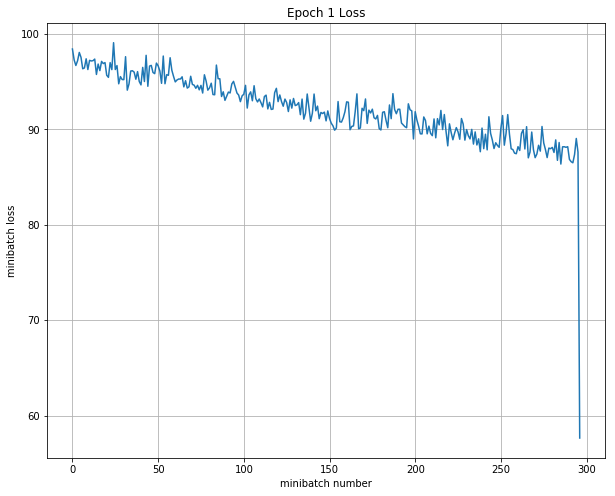

Iteration 300: with minibatch training loss = 14.4 and accuracy of 0.5
Iteration 400: with minibatch training loss = 14.1 and accuracy of 0.33
Iteration 500: with minibatch training loss = 13.5 and accuracy of 0.5
Epoch 2, Overall loss = 13.9 and accuracy of 0.46


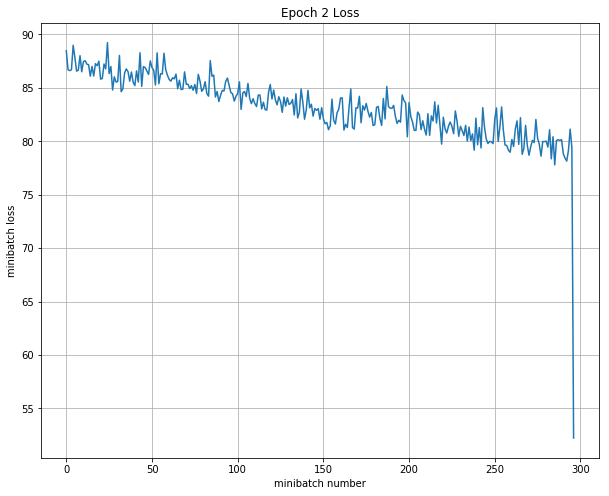

Iteration 600: with minibatch training loss = 13.1 and accuracy of 0.33
Iteration 700: with minibatch training loss = 13 and accuracy of 0.17
Iteration 800: with minibatch training loss = 12.6 and accuracy of 0.33
Epoch 3, Overall loss = 12.7 and accuracy of 0.508


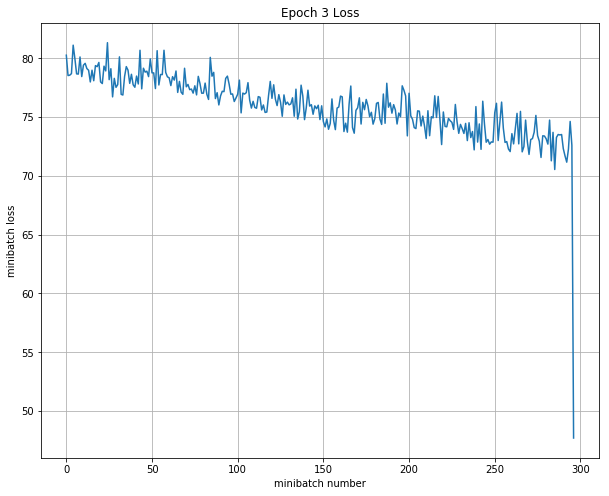

Iteration 900: with minibatch training loss = 12 and accuracy of 0.67
Iteration 1000: with minibatch training loss = 11.7 and accuracy of 0.67
Iteration 1100: with minibatch training loss = 11.4 and accuracy of 0.5
Epoch 4, Overall loss = 11.7 and accuracy of 0.561


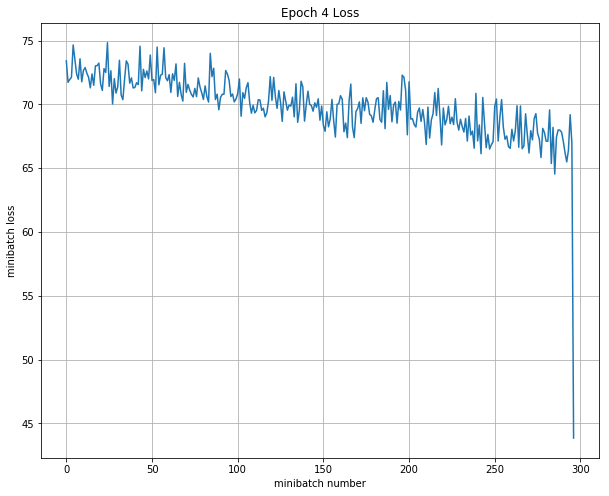

Iteration 1200: with minibatch training loss = 11.2 and accuracy of 0.5
Iteration 1300: with minibatch training loss = 10.8 and accuracy of 0.67
Iteration 1400: with minibatch training loss = 10.4 and accuracy of 0.83
Epoch 5, Overall loss = 10.8 and accuracy of 0.603


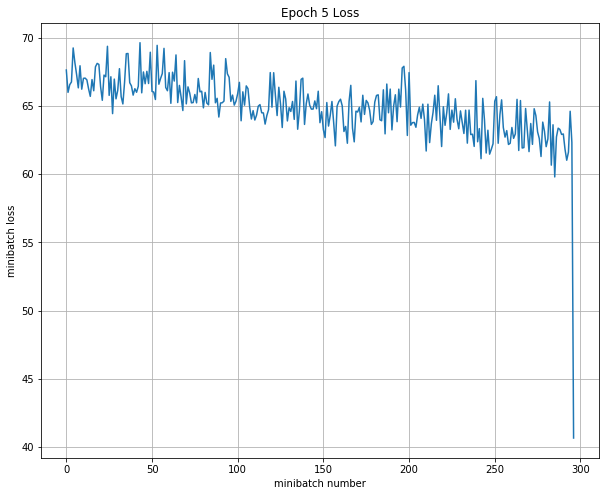

Iteration 1500: with minibatch training loss = 10.4 and accuracy of 0.67
Iteration 1600: with minibatch training loss = 10 and accuracy of 0.67
Iteration 1700: with minibatch training loss = 10.2 and accuracy of 0.33
Epoch 6, Overall loss = 10.2 and accuracy of 0.633


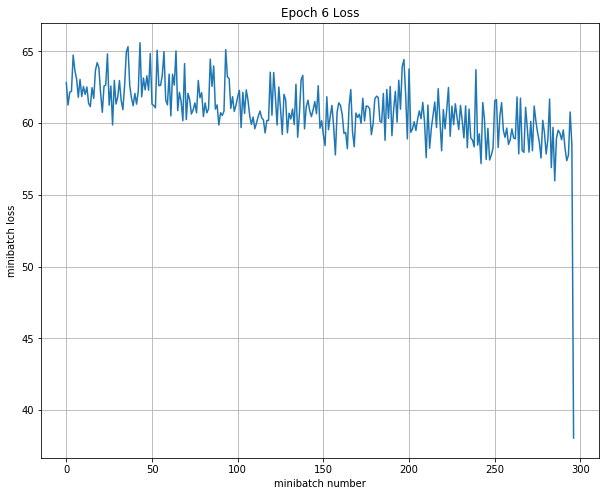

Iteration 1800: with minibatch training loss = 10.2 and accuracy of 0.33
Iteration 1900: with minibatch training loss = 9.42 and accuracy of 1
Iteration 2000: with minibatch training loss = 9.46 and accuracy of 0.67
Epoch 7, Overall loss = 9.58 and accuracy of 0.657


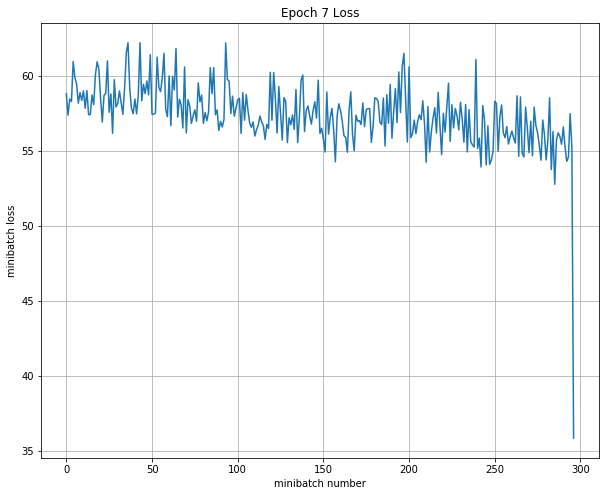

Iteration 2100: with minibatch training loss = 8.96 and accuracy of 0.83
Iteration 2200: with minibatch training loss = 9.57 and accuracy of 0.33
Iteration 2300: with minibatch training loss = 8.89 and accuracy of 0.83
Epoch 8, Overall loss = 9.09 and accuracy of 0.682


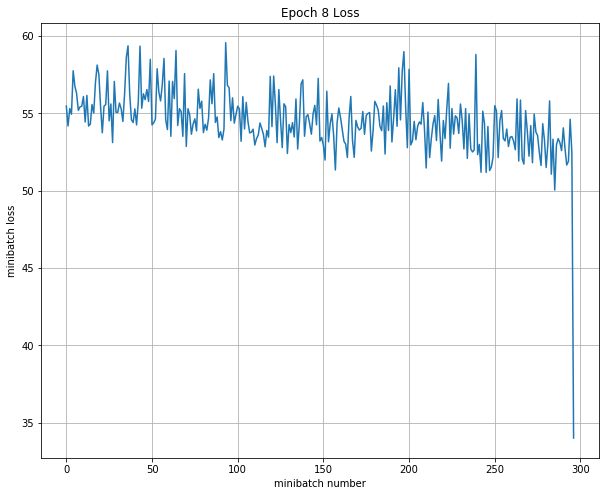

Iteration 2400: with minibatch training loss = 9.15 and accuracy of 0.5
Iteration 2500: with minibatch training loss = 9.02 and accuracy of 0.67
Iteration 2600: with minibatch training loss = 8.37 and accuracy of 0.83
Epoch 9, Overall loss = 8.67 and accuracy of 0.7


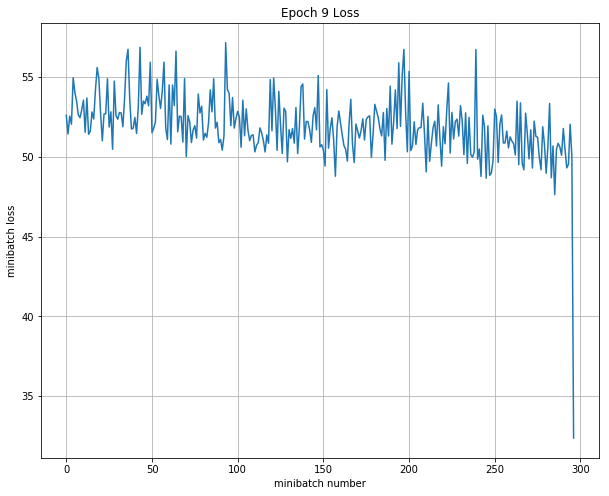

Iteration 2700: with minibatch training loss = 8.03 and accuracy of 1
Iteration 2800: with minibatch training loss = 8.46 and accuracy of 0.67
Iteration 2900: with minibatch training loss = 8.31 and accuracy of 0.5
Epoch 10, Overall loss = 8.29 and accuracy of 0.712


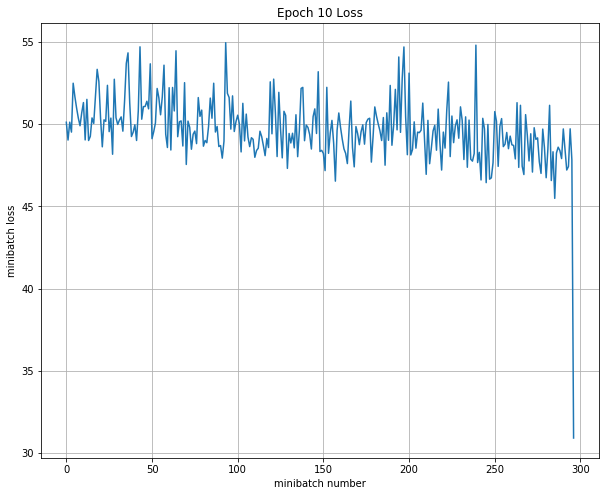

Validation
Epoch 1, Overall loss = 8.19 and accuracy of 0.68
Test
Epoch 1, Overall loss = 8.18 and accuracy of 0.72

--------------------------------------------------------------------------------
Trial number: 4
--------------------------------------------------------------------------------
reg: 0.054663, lr: 0.001087, dr: 0.858317, dc: 800, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 7.26 and accuracy of 0.17
Iteration 100: with minibatch training loss = 33 and accuracy of 0.5
Iteration 200: with minibatch training loss = 17.7 and accuracy of 0.5
Epoch 1, Overall loss = 30.2 and accuracy of 0.319


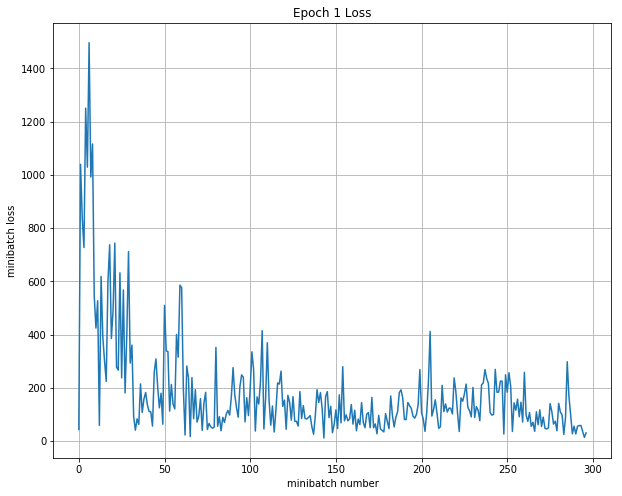

Iteration 300: with minibatch training loss = 2.36 and accuracy of 0.67
Iteration 400: with minibatch training loss = 16.3 and accuracy of 0.17
Iteration 500: with minibatch training loss = 2.18 and accuracy of 0.83
Epoch 2, Overall loss = 8.55 and accuracy of 0.346


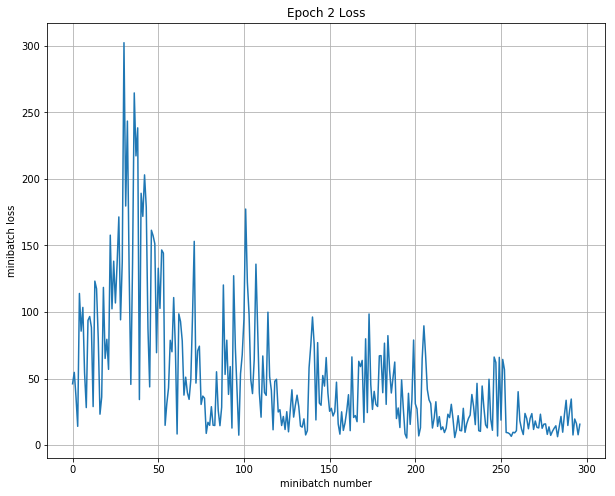

Iteration 600: with minibatch training loss = 4.18 and accuracy of 0.17
Iteration 700: with minibatch training loss = 1.96 and accuracy of 0.33
Iteration 800: with minibatch training loss = 2.74 and accuracy of 0
Epoch 3, Overall loss = 3.15 and accuracy of 0.342


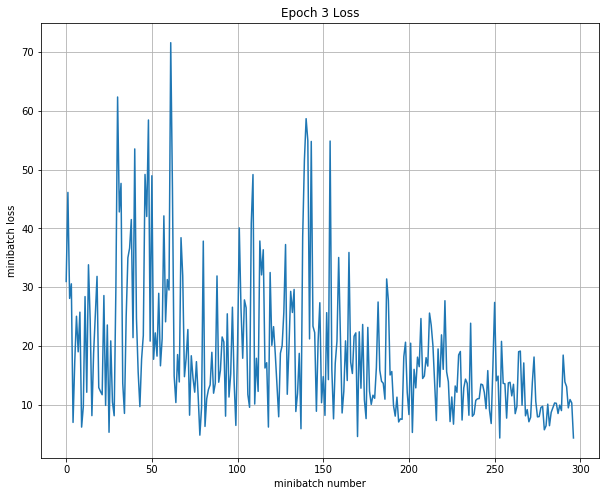

Iteration 900: with minibatch training loss = 1.66 and accuracy of 0.5
Iteration 1000: with minibatch training loss = 4.47 and accuracy of 0
Iteration 1100: with minibatch training loss = 1.59 and accuracy of 0.5
Epoch 4, Overall loss = 1.94 and accuracy of 0.321


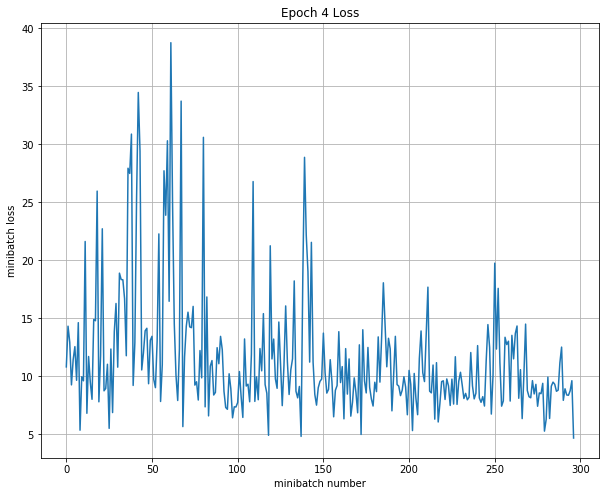

Iteration 1200: with minibatch training loss = 1.06 and accuracy of 0.67
Iteration 1300: with minibatch training loss = 1.44 and accuracy of 0.5
Iteration 1400: with minibatch training loss = 1.51 and accuracy of 0.33
Epoch 5, Overall loss = 1.5 and accuracy of 0.331


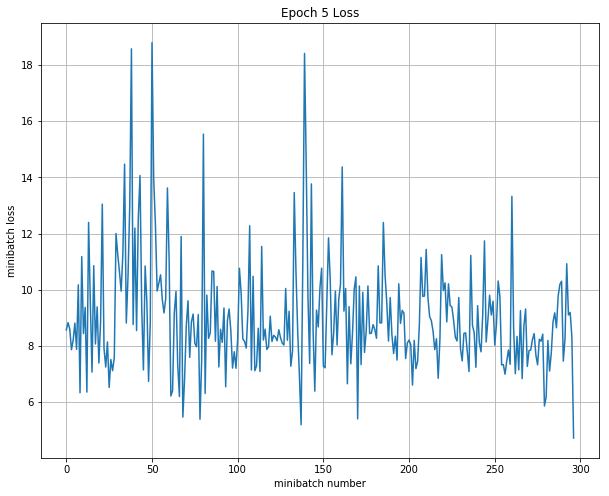

Iteration 1500: with minibatch training loss = 1.34 and accuracy of 0.33
Iteration 1600: with minibatch training loss = 1.47 and accuracy of 0.17
Iteration 1700: with minibatch training loss = 1.23 and accuracy of 0.5
Epoch 6, Overall loss = 1.44 and accuracy of 0.342


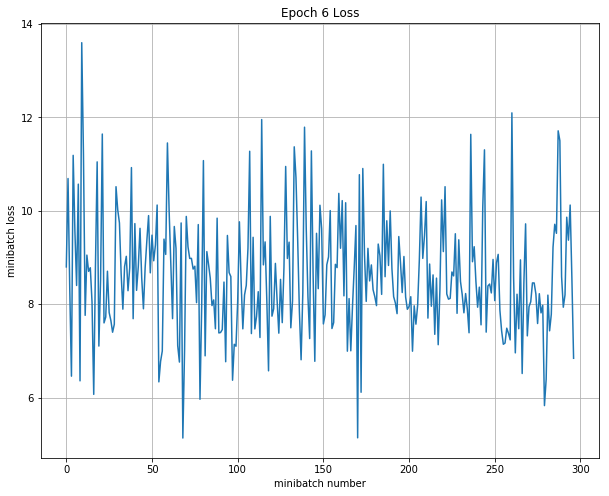

Iteration 1800: with minibatch training loss = 1.63 and accuracy of 0.33
Iteration 1900: with minibatch training loss = 1.05 and accuracy of 0.5
Iteration 2000: with minibatch training loss = 1.37 and accuracy of 0.5
Epoch 7, Overall loss = 1.41 and accuracy of 0.329


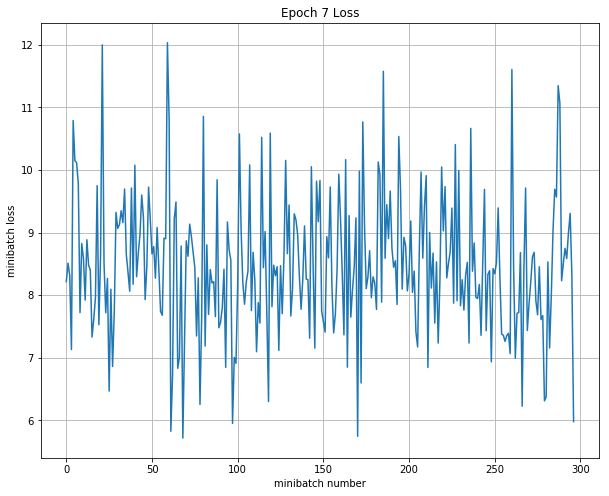

Iteration 2100: with minibatch training loss = 2.05 and accuracy of 0.17
Iteration 2200: with minibatch training loss = 1.31 and accuracy of 0.33
Iteration 2300: with minibatch training loss = 1.61 and accuracy of 0.33
Epoch 8, Overall loss = 1.42 and accuracy of 0.325


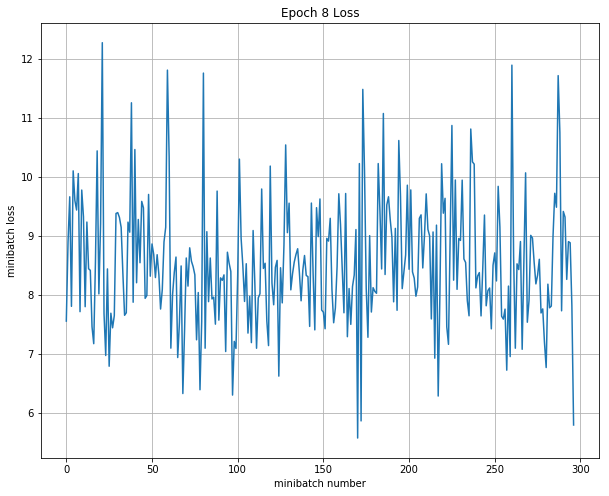

Iteration 2400: with minibatch training loss = 1.62 and accuracy of 0.33
Iteration 2500: with minibatch training loss = 1.18 and accuracy of 0.83
Iteration 2600: with minibatch training loss = 1.43 and accuracy of 0.5
Epoch 9, Overall loss = 1.43 and accuracy of 0.329


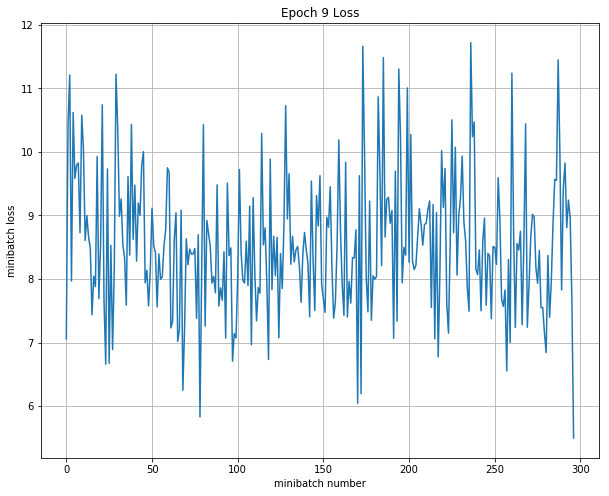

Iteration 2700: with minibatch training loss = 1.22 and accuracy of 0.5
Iteration 2800: with minibatch training loss = 1.5 and accuracy of 0.17
Iteration 2900: with minibatch training loss = 1.68 and accuracy of 0.17
Epoch 10, Overall loss = 1.43 and accuracy of 0.319


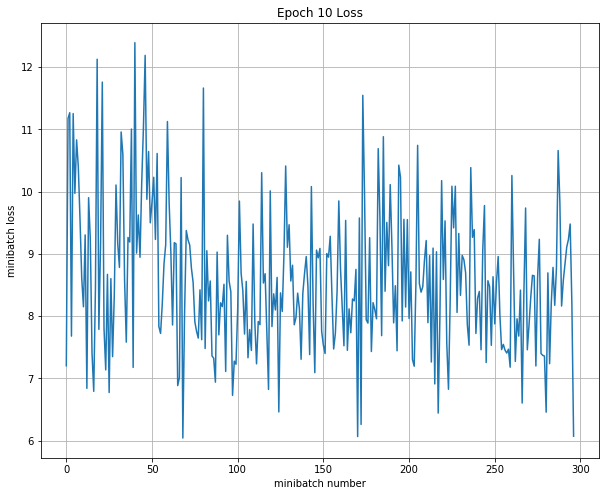

Train all layer
Iteration 0: with minibatch training loss = 1.68 and accuracy of 0.17
Iteration 100: with minibatch training loss = 1.39 and accuracy of 0.5
Iteration 200: with minibatch training loss = 1.31 and accuracy of 0.67
Epoch 1, Overall loss = 1.43 and accuracy of 0.326


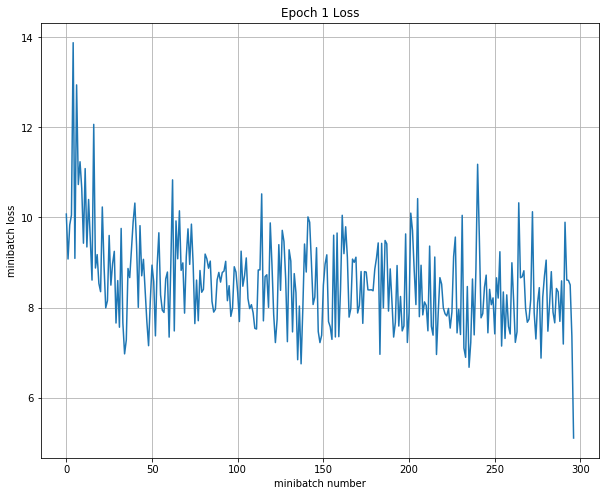

Iteration 300: with minibatch training loss = 1.55 and accuracy of 0
Iteration 400: with minibatch training loss = 1.32 and accuracy of 0.33
Iteration 500: with minibatch training loss = 1.35 and accuracy of 0.17
Epoch 2, Overall loss = 1.37 and accuracy of 0.324


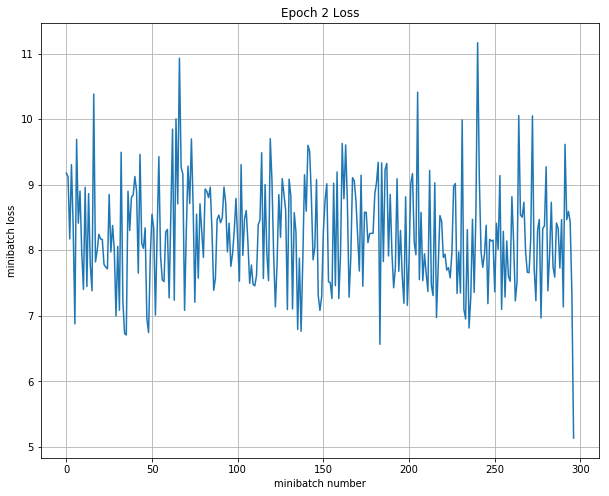

Iteration 600: with minibatch training loss = 1.58 and accuracy of 0
Iteration 700: with minibatch training loss = 1.33 and accuracy of 0.33
Iteration 800: with minibatch training loss = 1.25 and accuracy of 0.33
Epoch 3, Overall loss = 1.36 and accuracy of 0.332


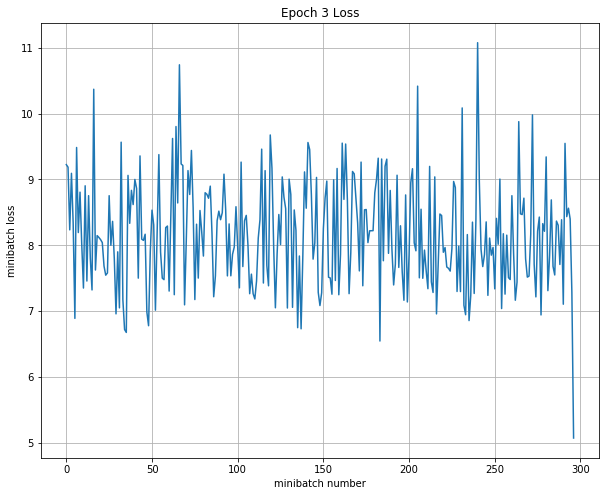

Iteration 900: with minibatch training loss = 1.33 and accuracy of 0.5
Iteration 1000: with minibatch training loss = 1.21 and accuracy of 0.5
Iteration 1100: with minibatch training loss = 1.32 and accuracy of 0.33
Epoch 4, Overall loss = 1.36 and accuracy of 0.333


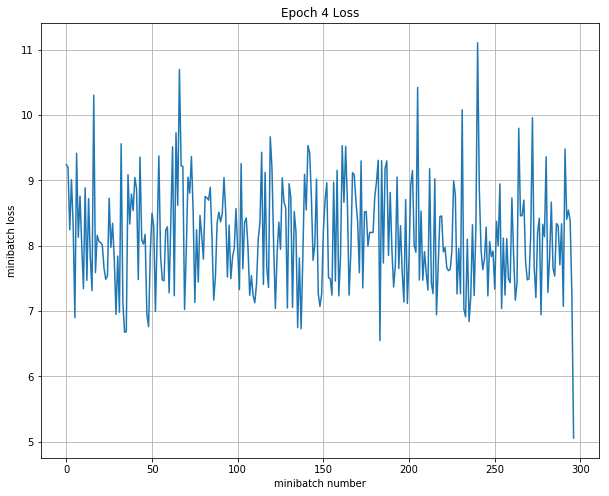

Iteration 1200: with minibatch training loss = 1.25 and accuracy of 0.5
Iteration 1300: with minibatch training loss = 1.35 and accuracy of 0.17
Iteration 1400: with minibatch training loss = 1.53 and accuracy of 0.17
Epoch 5, Overall loss = 1.35 and accuracy of 0.334


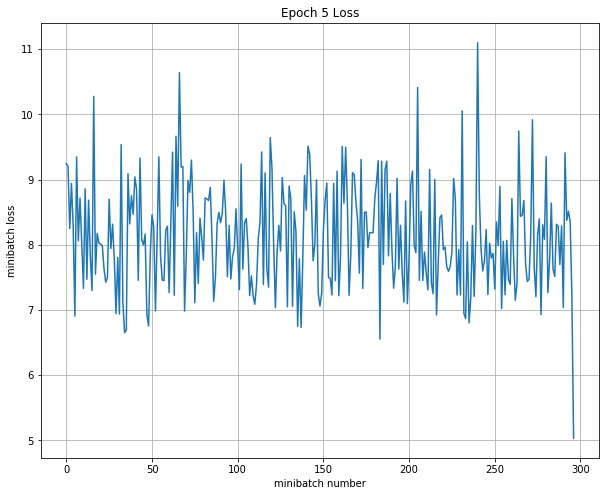

Iteration 1500: with minibatch training loss = 1.21 and accuracy of 0.5
Iteration 1600: with minibatch training loss = 1.23 and accuracy of 0.5
Iteration 1700: with minibatch training loss = 1.5 and accuracy of 0
Epoch 6, Overall loss = 1.35 and accuracy of 0.333


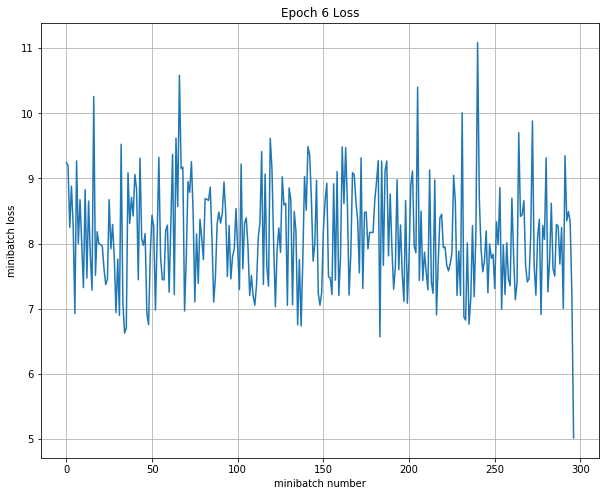

Iteration 1800: with minibatch training loss = 1.37 and accuracy of 0.5
Iteration 1900: with minibatch training loss = 1.22 and accuracy of 0.33
Iteration 2000: with minibatch training loss = 1.4 and accuracy of 0.5
Epoch 7, Overall loss = 1.35 and accuracy of 0.337


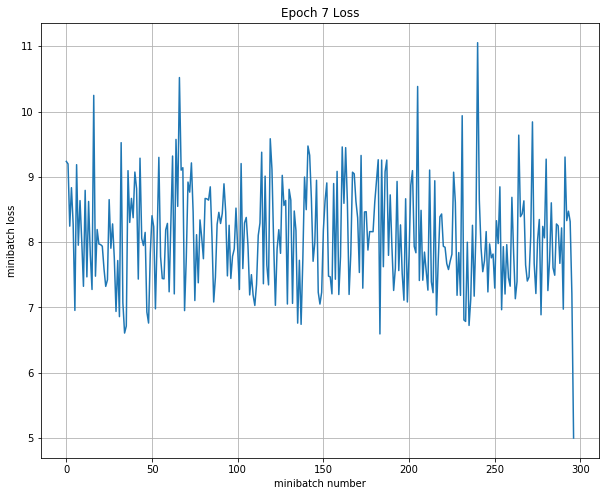

Iteration 2100: with minibatch training loss = 1.32 and accuracy of 0.17
Iteration 2200: with minibatch training loss = 1.32 and accuracy of 0.5
Iteration 2300: with minibatch training loss = 1.31 and accuracy of 0.17
Epoch 8, Overall loss = 1.34 and accuracy of 0.339


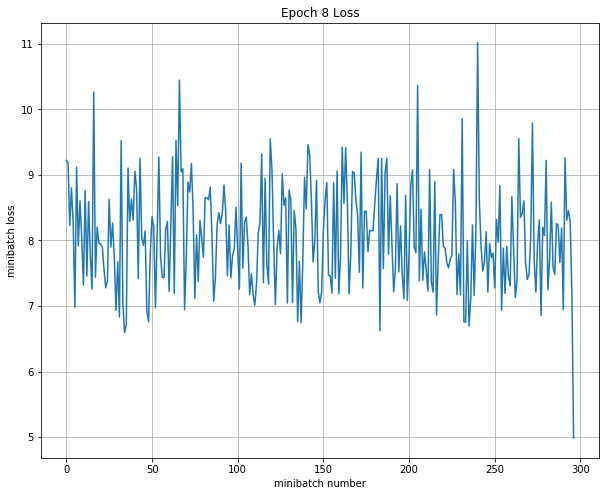

Iteration 2400: with minibatch training loss = 1.23 and accuracy of 0.33
Iteration 2500: with minibatch training loss = 1.36 and accuracy of 0.17
Iteration 2600: with minibatch training loss = 1.28 and accuracy of 0.17
Epoch 9, Overall loss = 1.34 and accuracy of 0.339


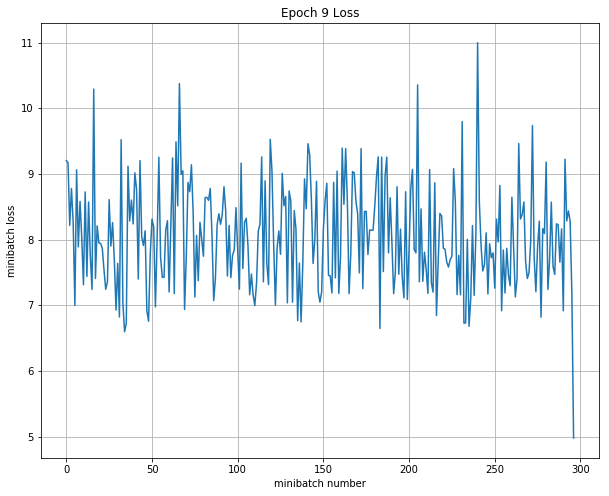

Iteration 2700: with minibatch training loss = 1.37 and accuracy of 0.33
Iteration 2800: with minibatch training loss = 1.41 and accuracy of 0
Iteration 2900: with minibatch training loss = 1.43 and accuracy of 0.5
Epoch 10, Overall loss = 1.34 and accuracy of 0.339


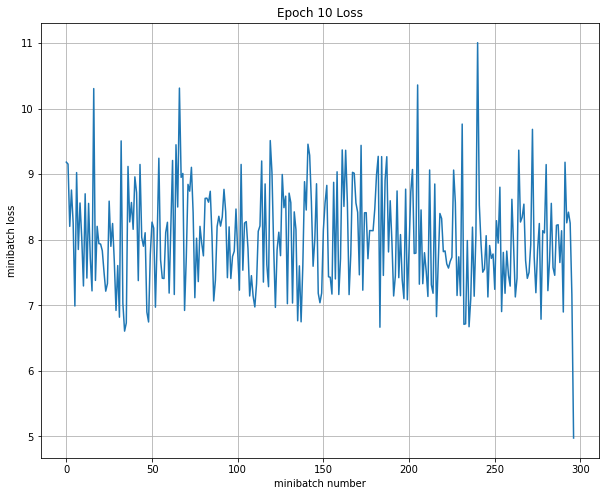

Validation
Epoch 1, Overall loss = 1.34 and accuracy of 0.28
Test
Epoch 1, Overall loss = 1.36 and accuracy of 0.26

--------------------------------------------------------------------------------
Trial number: 5
--------------------------------------------------------------------------------
reg: 0.884752, lr: 0.000530, dr: 0.983841, dc: 843, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 93 and accuracy of 0.67
Iteration 100: with minibatch training loss = 16.3 and accuracy of 0.33
Iteration 200: with minibatch training loss = 12.3 and accuracy of 0.17
Epoch 1, Overall loss = 22.9 and accuracy of 0.312


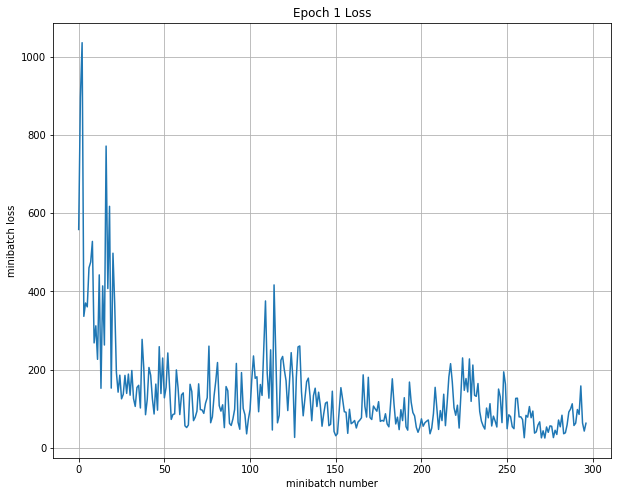

Iteration 300: with minibatch training loss = 9.07 and accuracy of 0.17
Iteration 400: with minibatch training loss = 4.74 and accuracy of 0.17
Iteration 500: with minibatch training loss = 6.79 and accuracy of 0.33
Epoch 2, Overall loss = 7.4 and accuracy of 0.308


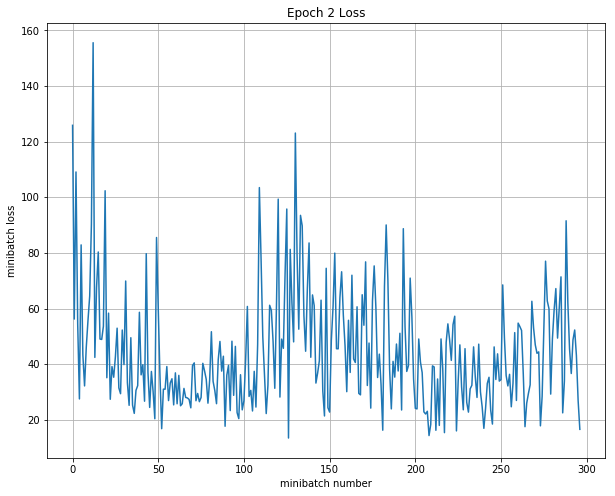

Iteration 600: with minibatch training loss = 8.84 and accuracy of 0
Iteration 700: with minibatch training loss = 3.8 and accuracy of 0.33
Iteration 800: with minibatch training loss = 2.73 and accuracy of 0.17
Epoch 3, Overall loss = 3.57 and accuracy of 0.308


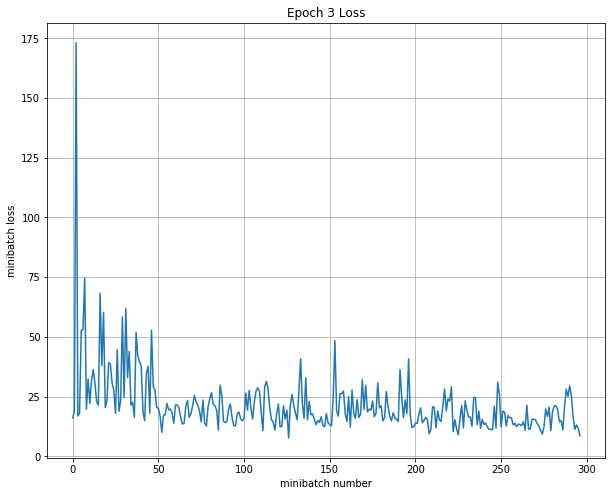

Iteration 900: with minibatch training loss = 4.82 and accuracy of 0
Iteration 1000: with minibatch training loss = 3.52 and accuracy of 0.33
Iteration 1100: with minibatch training loss = 1.46 and accuracy of 0.17
Epoch 4, Overall loss = 2.42 and accuracy of 0.294


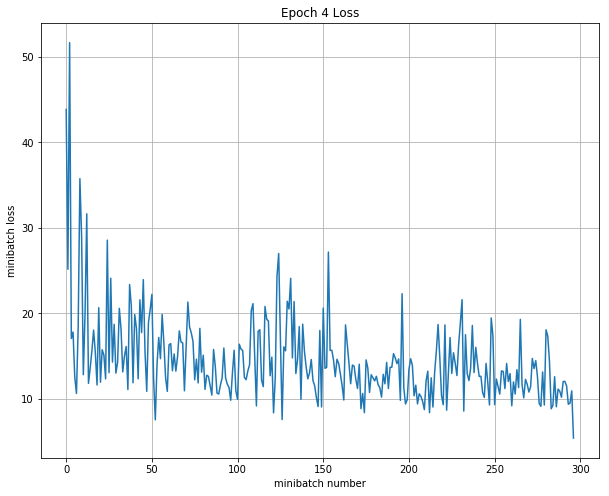

Iteration 1200: with minibatch training loss = 2.13 and accuracy of 0.17
Iteration 1300: with minibatch training loss = 1.54 and accuracy of 0.17
Iteration 1400: with minibatch training loss = 1.4 and accuracy of 0.67
Epoch 5, Overall loss = 1.8 and accuracy of 0.278


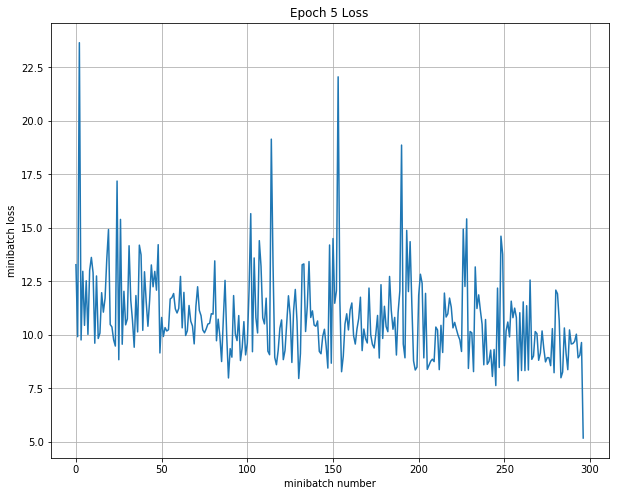

Iteration 1500: with minibatch training loss = 1.56 and accuracy of 0
Iteration 1600: with minibatch training loss = 1.73 and accuracy of 0.5
Iteration 1700: with minibatch training loss = 2.09 and accuracy of 0
Epoch 6, Overall loss = 1.57 and accuracy of 0.284


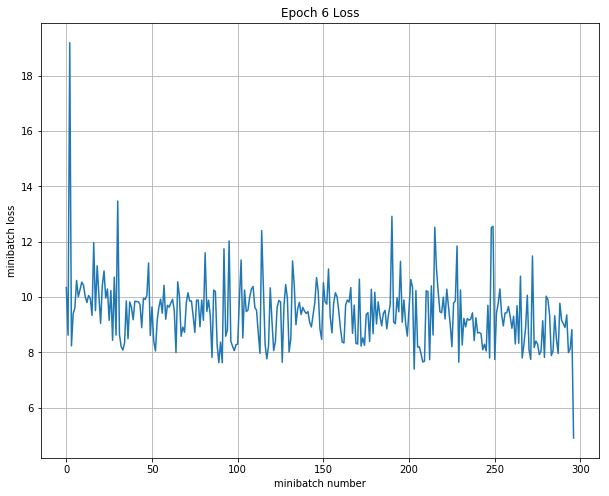

Iteration 1800: with minibatch training loss = 1.68 and accuracy of 0
Iteration 1900: with minibatch training loss = 1.34 and accuracy of 0.33
Iteration 2000: with minibatch training loss = 1.55 and accuracy of 0.17
Epoch 7, Overall loss = 1.48 and accuracy of 0.306


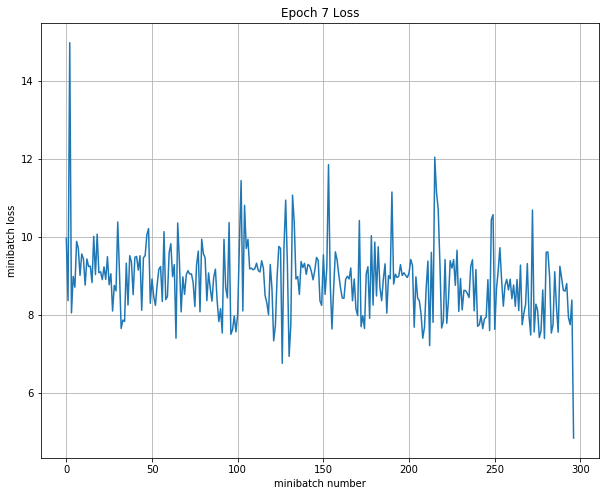

Iteration 2100: with minibatch training loss = 1.43 and accuracy of 0.17
Iteration 2200: with minibatch training loss = 1.21 and accuracy of 0.33
Iteration 2300: with minibatch training loss = 1.52 and accuracy of 0.33
Epoch 8, Overall loss = 1.43 and accuracy of 0.311


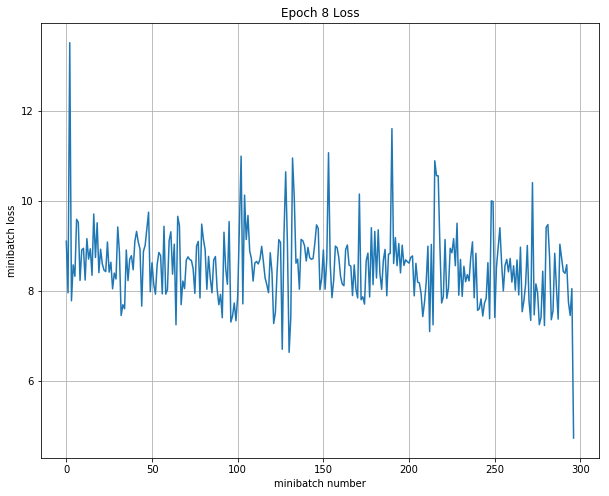

Iteration 2400: with minibatch training loss = 1.51 and accuracy of 0
Iteration 2500: with minibatch training loss = 1.48 and accuracy of 0
Iteration 2600: with minibatch training loss = 1.46 and accuracy of 0
Epoch 9, Overall loss = 1.4 and accuracy of 0.31


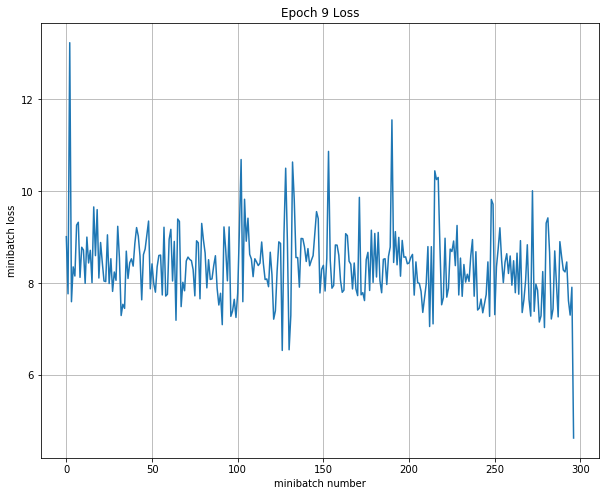

Iteration 2700: with minibatch training loss = 1.28 and accuracy of 0.5
Iteration 2800: with minibatch training loss = 1.49 and accuracy of 0.33
Iteration 2900: with minibatch training loss = 1.39 and accuracy of 0.5
Epoch 10, Overall loss = 1.38 and accuracy of 0.307


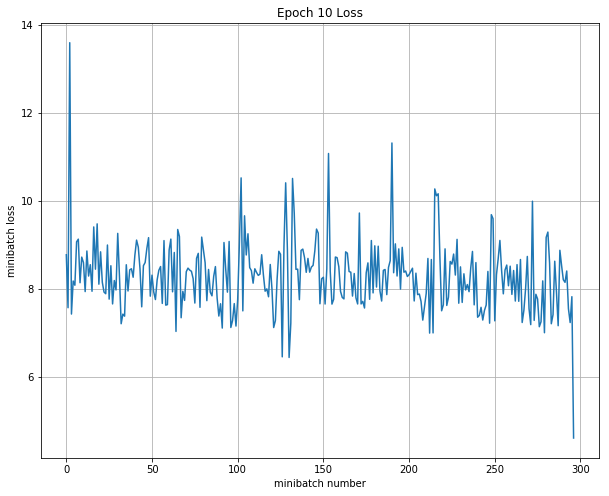

Train all layer
Iteration 0: with minibatch training loss = 1.62 and accuracy of 0.33
Iteration 100: with minibatch training loss = 1.41 and accuracy of 0.33
Iteration 200: with minibatch training loss = 1.46 and accuracy of 0.5
Epoch 1, Overall loss = 1.39 and accuracy of 0.291


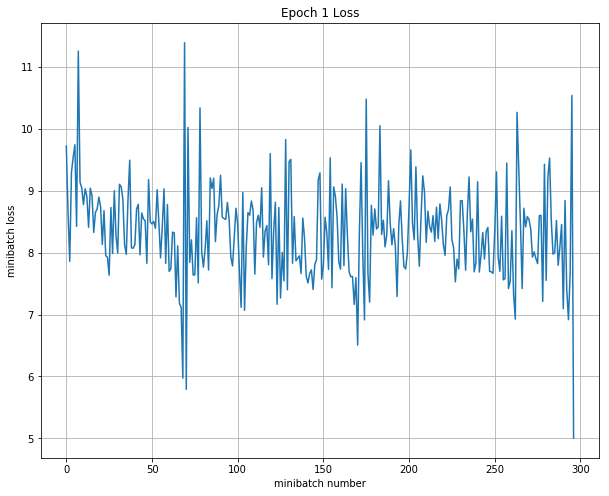

Iteration 300: with minibatch training loss = 1.45 and accuracy of 0
Iteration 400: with minibatch training loss = 1.47 and accuracy of 0.5
Iteration 500: with minibatch training loss = 1.36 and accuracy of 0.5
Epoch 2, Overall loss = 1.42 and accuracy of 0.31


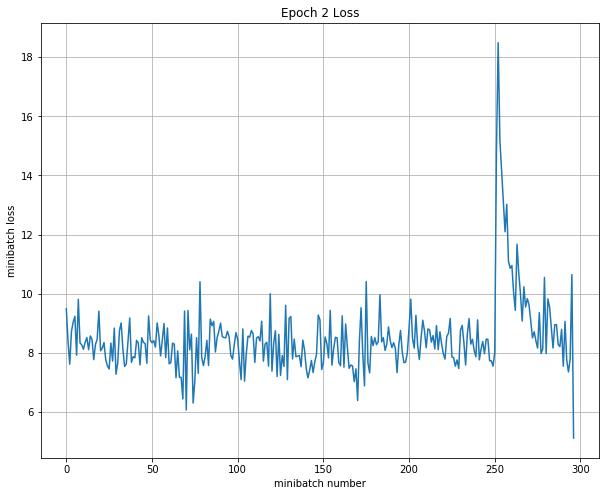

Iteration 600: with minibatch training loss = 1.39 and accuracy of 0.17
Iteration 700: with minibatch training loss = 1.43 and accuracy of 0.17
Iteration 800: with minibatch training loss = 1.31 and accuracy of 0.33
Epoch 3, Overall loss = 1.39 and accuracy of 0.308


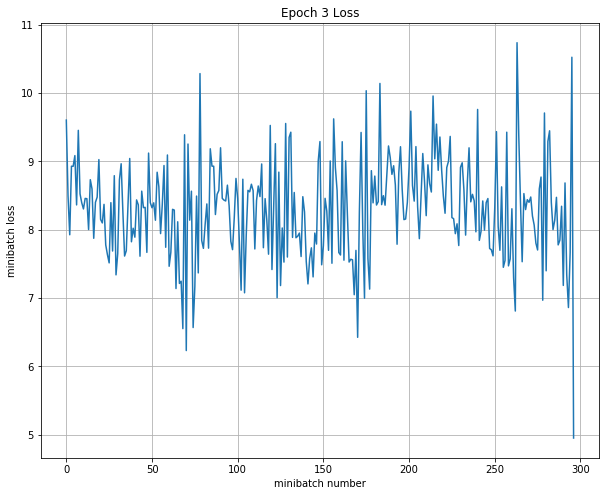

Iteration 900: with minibatch training loss = 1.37 and accuracy of 0.33
Iteration 1000: with minibatch training loss = 1.42 and accuracy of 0.17
Iteration 1100: with minibatch training loss = 1.47 and accuracy of 0.5
Epoch 4, Overall loss = 1.36 and accuracy of 0.313


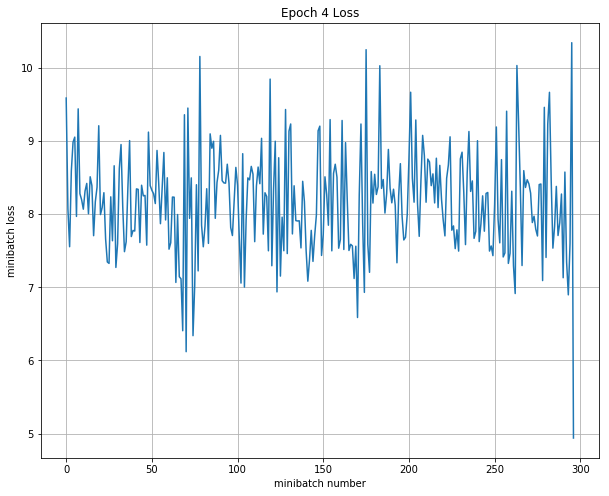

Iteration 1200: with minibatch training loss = 1.4 and accuracy of 0.17
Iteration 1300: with minibatch training loss = 1.42 and accuracy of 0
Iteration 1400: with minibatch training loss = 1.49 and accuracy of 0.17
Epoch 5, Overall loss = 1.36 and accuracy of 0.309


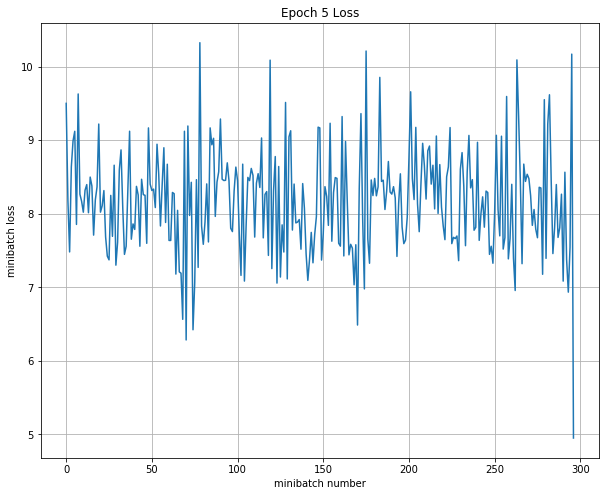

Iteration 1500: with minibatch training loss = 1.4 and accuracy of 0.17
Iteration 1600: with minibatch training loss = 1.28 and accuracy of 0.5
Iteration 1700: with minibatch training loss = 1.35 and accuracy of 0.33
Epoch 6, Overall loss = 1.36 and accuracy of 0.313


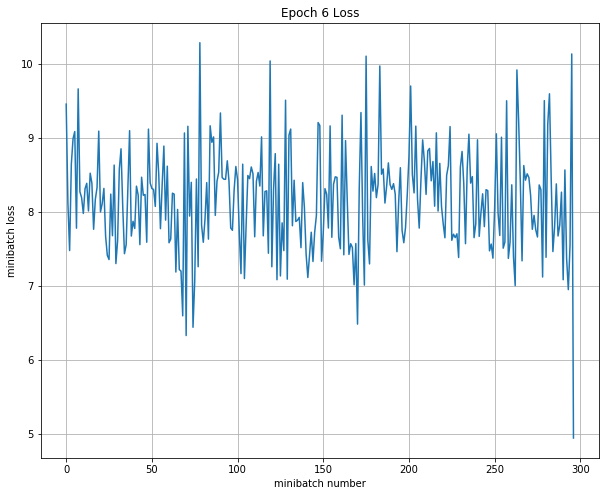

Iteration 1800: with minibatch training loss = 1.39 and accuracy of 0.33
Iteration 1900: with minibatch training loss = 1.24 and accuracy of 0.33
Iteration 2000: with minibatch training loss = 1.44 and accuracy of 0.17
Epoch 7, Overall loss = 1.36 and accuracy of 0.308


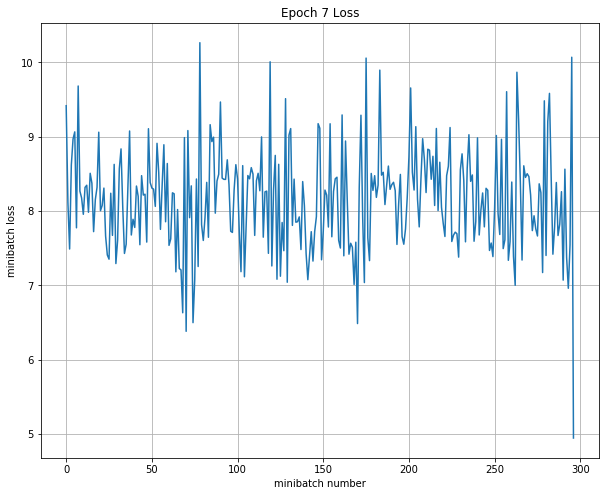

Iteration 2100: with minibatch training loss = 1.34 and accuracy of 0.17
Iteration 2200: with minibatch training loss = 1.38 and accuracy of 0.33
Iteration 2300: with minibatch training loss = 1.28 and accuracy of 0.5
Epoch 8, Overall loss = 1.36 and accuracy of 0.315


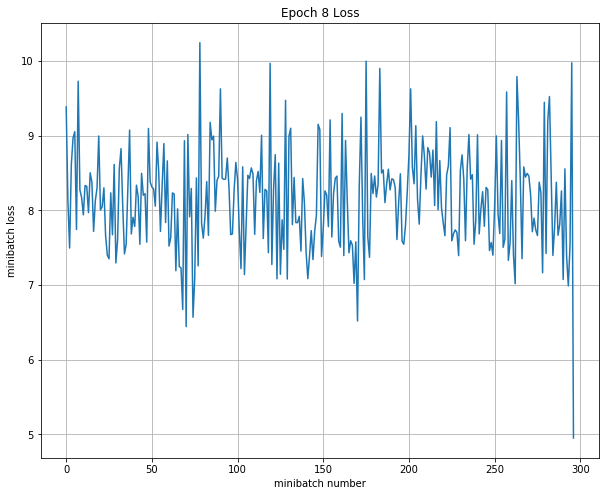

Iteration 2400: with minibatch training loss = 1.24 and accuracy of 0
Iteration 2500: with minibatch training loss = 1.44 and accuracy of 0.17
Iteration 2600: with minibatch training loss = 1.52 and accuracy of 0.5
Epoch 9, Overall loss = 1.36 and accuracy of 0.326


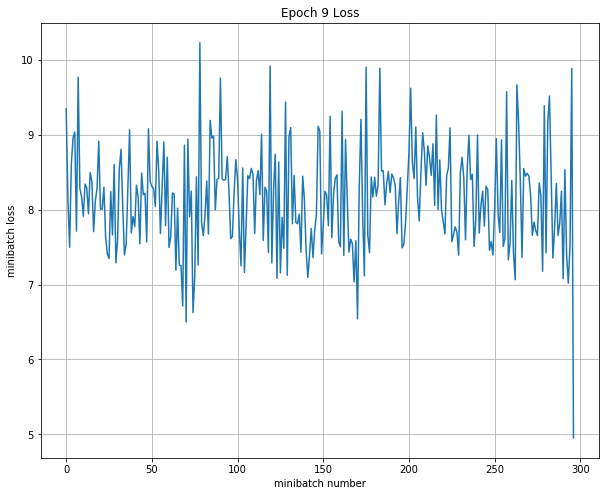

Iteration 2700: with minibatch training loss = 1.28 and accuracy of 0.33
Iteration 2800: with minibatch training loss = 1.25 and accuracy of 0.5
Iteration 2900: with minibatch training loss = 1.3 and accuracy of 0.5
Epoch 10, Overall loss = 1.36 and accuracy of 0.33


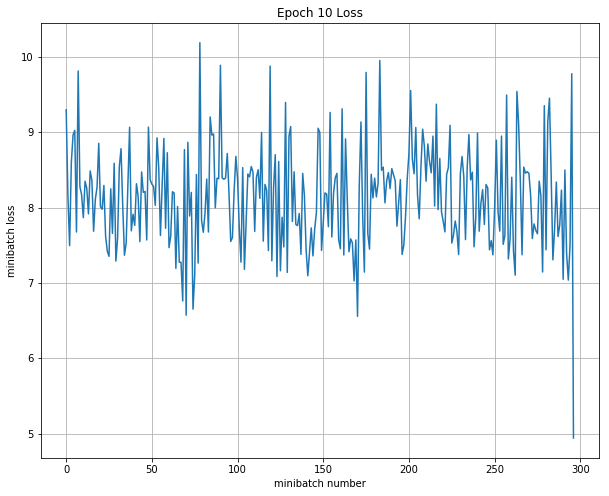

Validation
Epoch 1, Overall loss = 1.35 and accuracy of 0.28
Test
Epoch 1, Overall loss = 1.36 and accuracy of 0.26

--------------------------------------------------------------------------------
Trial number: 6
--------------------------------------------------------------------------------
reg: 0.595027, lr: 0.000014, dr: 0.767819, dc: 614, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 63.1 and accuracy of 0.5
Iteration 100: with minibatch training loss = 30.4 and accuracy of 0.67
Iteration 200: with minibatch training loss = 18.2 and accuracy of 0
Epoch 1, Overall loss = 28 and accuracy of 0.298


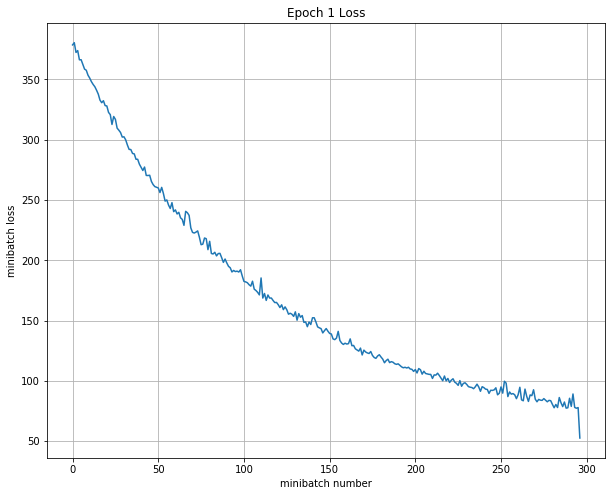

Iteration 300: with minibatch training loss = 12.8 and accuracy of 0.5
Iteration 400: with minibatch training loss = 10.1 and accuracy of 0.17
Iteration 500: with minibatch training loss = 9 and accuracy of 0.17
Epoch 2, Overall loss = 9.84 and accuracy of 0.308


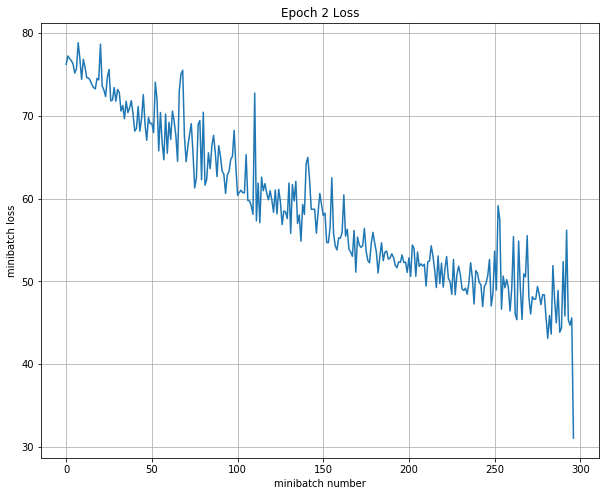

Iteration 600: with minibatch training loss = 7.43 and accuracy of 0.5
Iteration 700: with minibatch training loss = 6.49 and accuracy of 0.33
Iteration 800: with minibatch training loss = 6.09 and accuracy of 0.33
Epoch 3, Overall loss = 6.62 and accuracy of 0.313


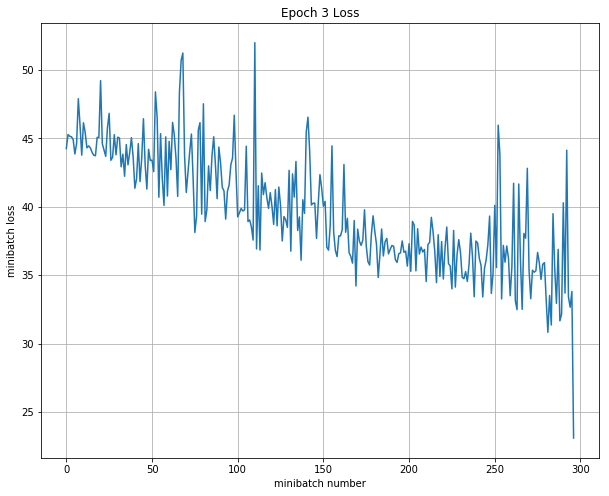

Iteration 900: with minibatch training loss = 5.37 and accuracy of 0.33
Iteration 1000: with minibatch training loss = 4.74 and accuracy of 0.67
Iteration 1100: with minibatch training loss = 4.91 and accuracy of 0.33
Epoch 4, Overall loss = 5.19 and accuracy of 0.317


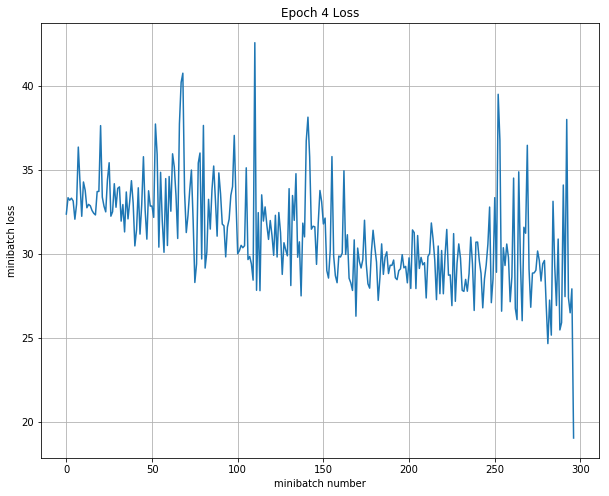

Iteration 1200: with minibatch training loss = 4.47 and accuracy of 0.5
Iteration 1300: with minibatch training loss = 4.6 and accuracy of 0.33
Iteration 1400: with minibatch training loss = 4.31 and accuracy of 0.5
Epoch 5, Overall loss = 4.41 and accuracy of 0.322


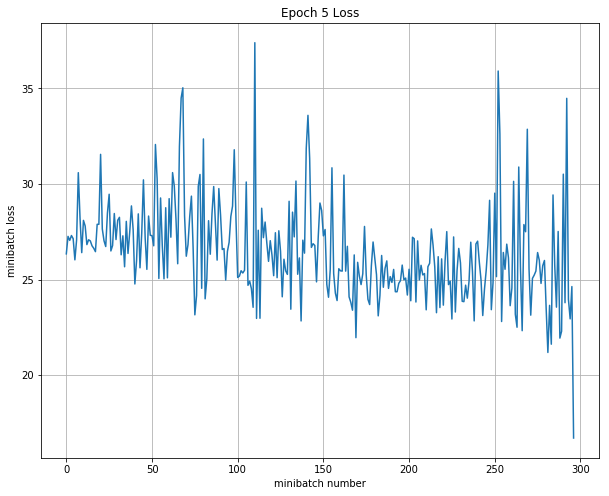

Iteration 1500: with minibatch training loss = 3.9 and accuracy of 0.5
Iteration 1600: with minibatch training loss = 4.06 and accuracy of 0.17
Iteration 1700: with minibatch training loss = 3.86 and accuracy of 0.33
Epoch 6, Overall loss = 3.94 and accuracy of 0.321


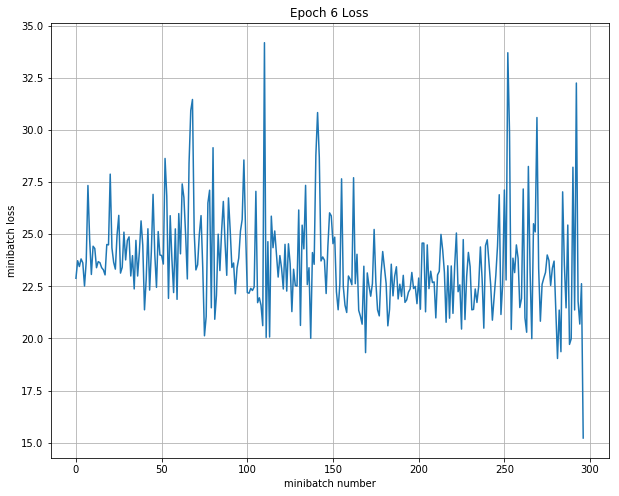

Iteration 1800: with minibatch training loss = 3.72 and accuracy of 0.33
Iteration 1900: with minibatch training loss = 3.49 and accuracy of 0.33
Iteration 2000: with minibatch training loss = 3.21 and accuracy of 0.33
Epoch 7, Overall loss = 3.63 and accuracy of 0.322


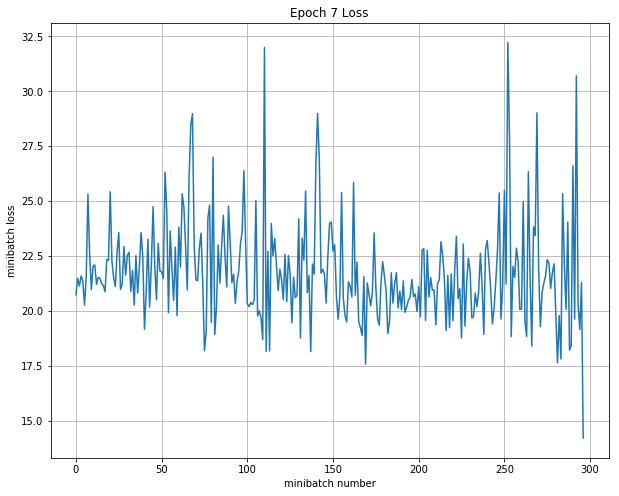

Iteration 2100: with minibatch training loss = 3.47 and accuracy of 0.33
Iteration 2200: with minibatch training loss = 3.2 and accuracy of 0.17
Iteration 2300: with minibatch training loss = 3.44 and accuracy of 0.5
Epoch 8, Overall loss = 3.41 and accuracy of 0.328


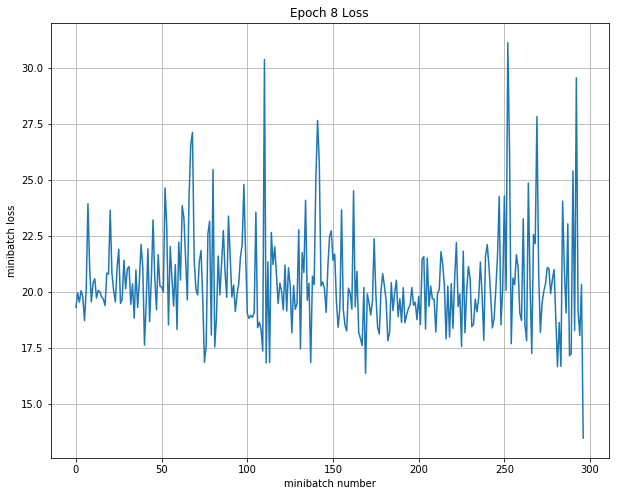

Iteration 2400: with minibatch training loss = 3.31 and accuracy of 0.17
Iteration 2500: with minibatch training loss = 3.33 and accuracy of 0.33
Iteration 2600: with minibatch training loss = 3.18 and accuracy of 0.33
Epoch 9, Overall loss = 3.24 and accuracy of 0.324


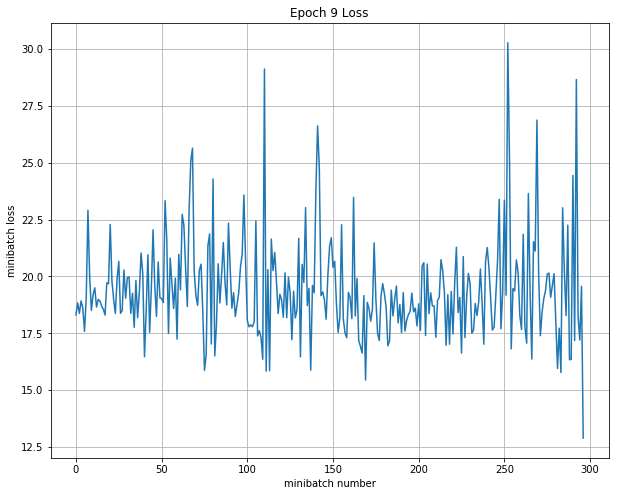

Iteration 2700: with minibatch training loss = 2.92 and accuracy of 0.5
Iteration 2800: with minibatch training loss = 3.1 and accuracy of 0.17
Iteration 2900: with minibatch training loss = 2.77 and accuracy of 0.5
Epoch 10, Overall loss = 3.1 and accuracy of 0.325


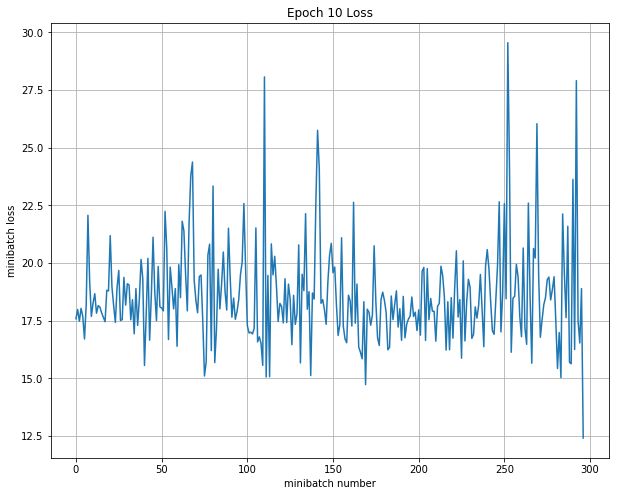

Train all layer
Iteration 0: with minibatch training loss = 2.95 and accuracy of 0.33
Iteration 100: with minibatch training loss = 2.93 and accuracy of 0.33
Iteration 200: with minibatch training loss = 2.3 and accuracy of 0.67
Epoch 1, Overall loss = 2.78 and accuracy of 0.453


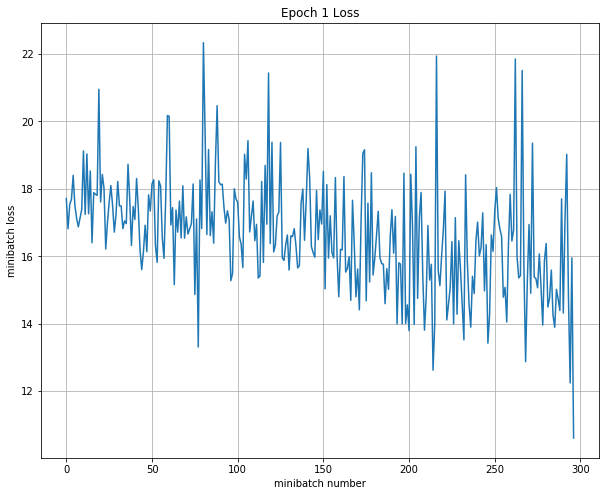

Iteration 300: with minibatch training loss = 2.58 and accuracy of 0.67
Iteration 400: with minibatch training loss = 2.03 and accuracy of 0.83
Iteration 500: with minibatch training loss = 1.86 and accuracy of 0.83
Epoch 2, Overall loss = 2.43 and accuracy of 0.655


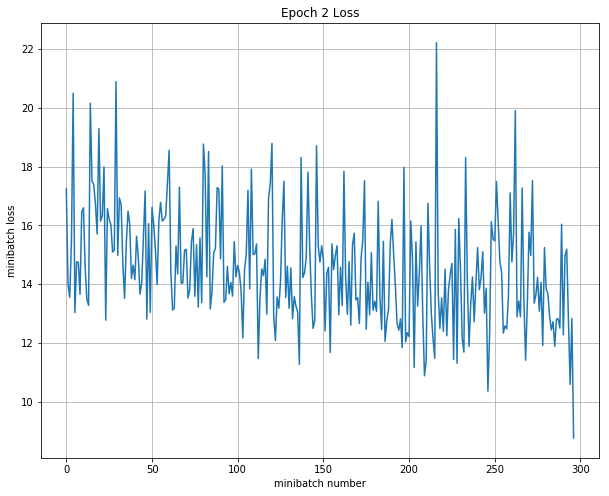

Iteration 600: with minibatch training loss = 2.07 and accuracy of 0.83
Iteration 700: with minibatch training loss = 2.79 and accuracy of 0.67
Iteration 800: with minibatch training loss = 1.94 and accuracy of 0.67
Epoch 3, Overall loss = 2.18 and accuracy of 0.74


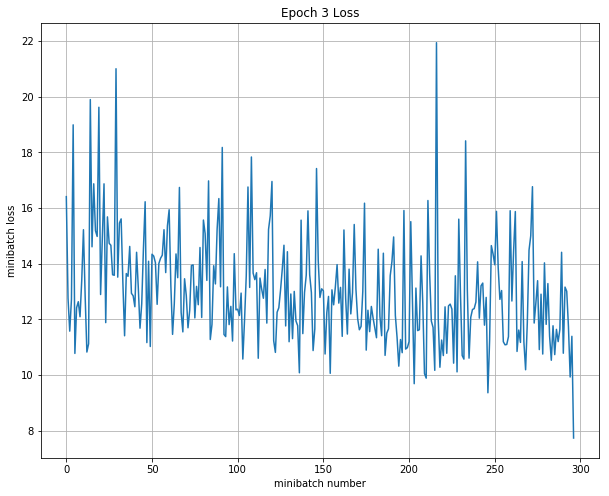

Iteration 900: with minibatch training loss = 1.93 and accuracy of 1
Iteration 1000: with minibatch training loss = 2.15 and accuracy of 0.67
Iteration 1100: with minibatch training loss = 1.64 and accuracy of 0.83
Epoch 4, Overall loss = 1.97 and accuracy of 0.804


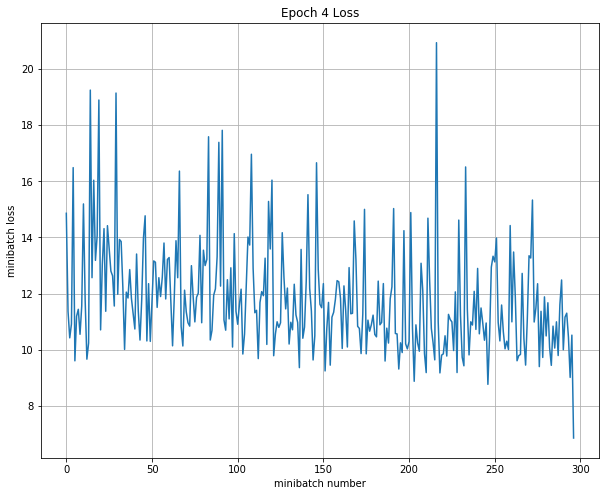

Iteration 1200: with minibatch training loss = 1.48 and accuracy of 1
Iteration 1300: with minibatch training loss = 1.52 and accuracy of 1
Iteration 1400: with minibatch training loss = 2.07 and accuracy of 0.67
Epoch 5, Overall loss = 1.81 and accuracy of 0.84


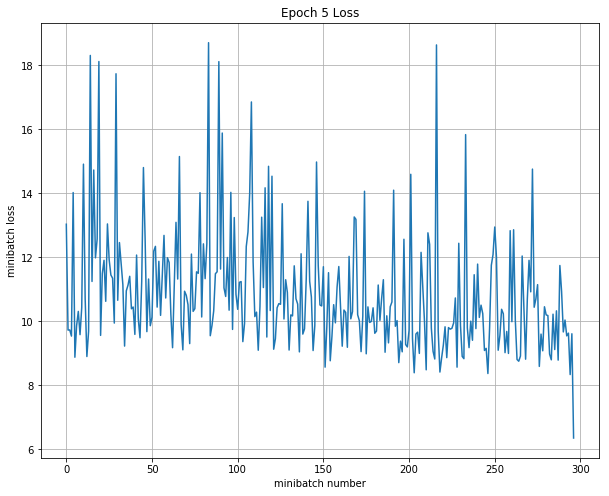

Iteration 1500: with minibatch training loss = 1.66 and accuracy of 0.83
Iteration 1600: with minibatch training loss = 1.65 and accuracy of 0.83
Iteration 1700: with minibatch training loss = 1.35 and accuracy of 1
Epoch 6, Overall loss = 1.68 and accuracy of 0.871


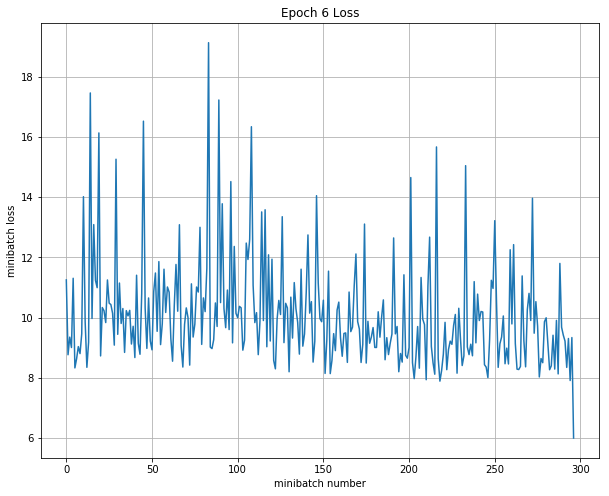

Iteration 1800: with minibatch training loss = 1.62 and accuracy of 0.83
Iteration 1900: with minibatch training loss = 1.58 and accuracy of 0.83
Iteration 2000: with minibatch training loss = 1.24 and accuracy of 1
Epoch 7, Overall loss = 1.56 and accuracy of 0.893


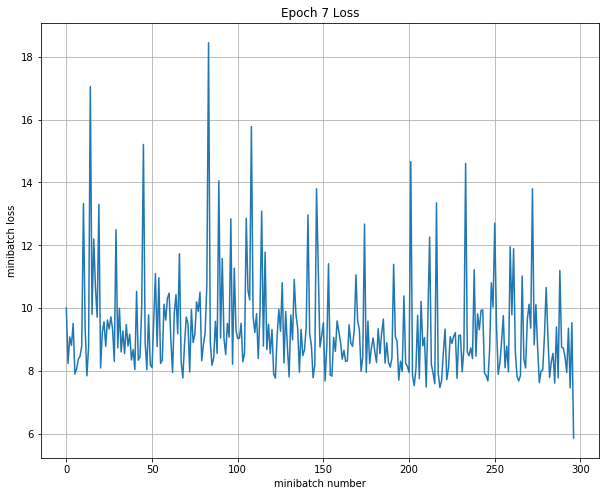

Iteration 2100: with minibatch training loss = 1.41 and accuracy of 1
Iteration 2200: with minibatch training loss = 1.25 and accuracy of 1
Iteration 2300: with minibatch training loss = 1.3 and accuracy of 1
Epoch 8, Overall loss = 1.45 and accuracy of 0.908


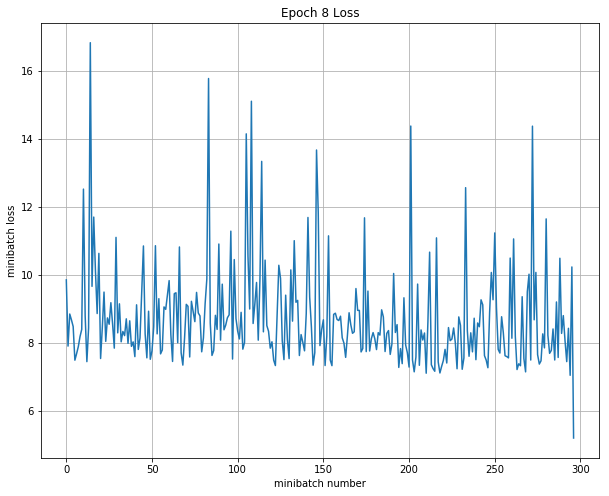

Iteration 2400: with minibatch training loss = 1.32 and accuracy of 1
Iteration 2500: with minibatch training loss = 1.69 and accuracy of 0.83
Iteration 2600: with minibatch training loss = 1.3 and accuracy of 1
Epoch 9, Overall loss = 1.38 and accuracy of 0.917


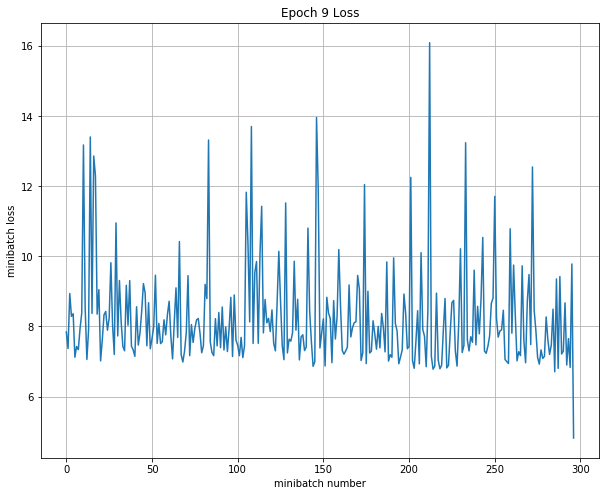

Iteration 2700: with minibatch training loss = 1.16 and accuracy of 1
Iteration 2800: with minibatch training loss = 1.1 and accuracy of 1
Iteration 2900: with minibatch training loss = 1.16 and accuracy of 1
Epoch 10, Overall loss = 1.27 and accuracy of 0.94


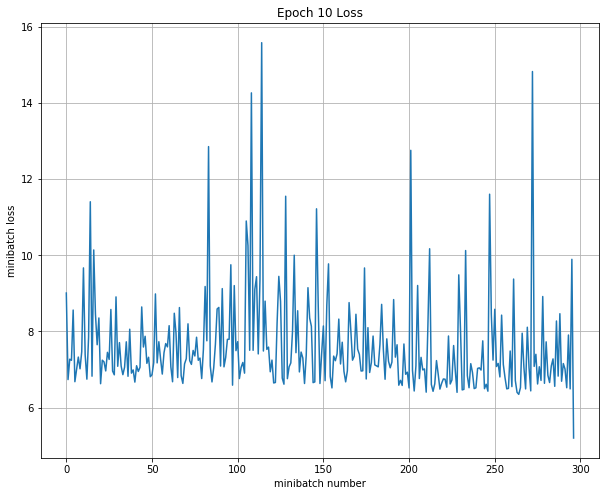

Validation
Epoch 1, Overall loss = 1.42 and accuracy of 0.94
Test
Epoch 1, Overall loss = 1.37 and accuracy of 0.84

--------------------------------------------------------------------------------
Trial number: 7
--------------------------------------------------------------------------------
reg: 9.937893, lr: 0.000260, dr: 0.771217, dc: 816, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 1.03e+03 and accuracy of 0
Iteration 100: with minibatch training loss = 28.8 and accuracy of 0.33
Iteration 200: with minibatch training loss = 18.8 and accuracy of 0.17
Epoch 1, Overall loss = 41.9 and accuracy of 0.281


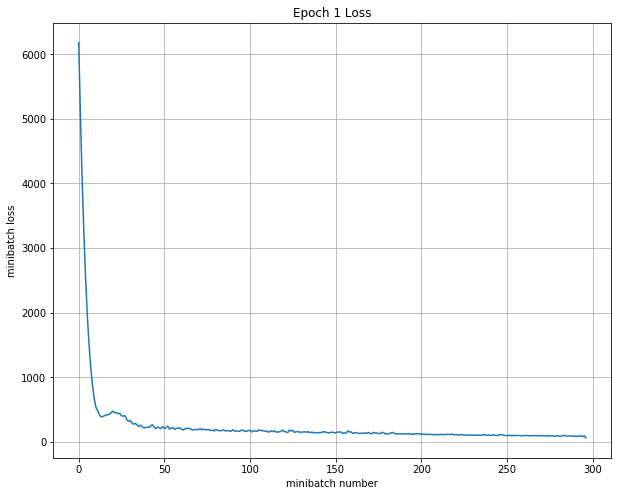

Iteration 300: with minibatch training loss = 14.5 and accuracy of 0.17
Iteration 400: with minibatch training loss = 10.7 and accuracy of 0.17
Iteration 500: with minibatch training loss = 7.3 and accuracy of 0.5
Epoch 2, Overall loss = 9.46 and accuracy of 0.282


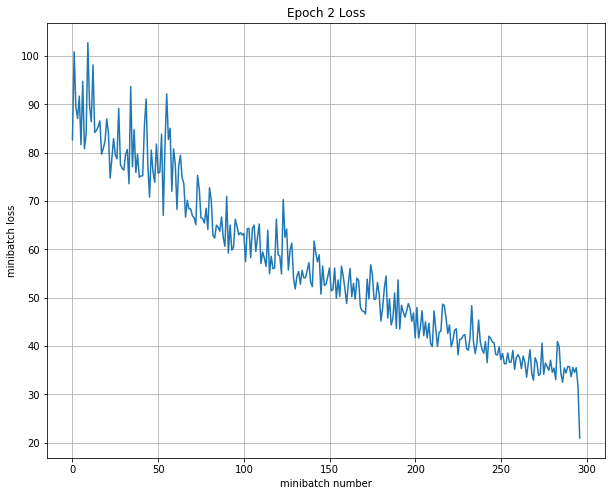

Iteration 600: with minibatch training loss = 5.21 and accuracy of 0.33
Iteration 700: with minibatch training loss = 4.61 and accuracy of 0
Iteration 800: with minibatch training loss = 3.24 and accuracy of 0.33
Epoch 3, Overall loss = 3.84 and accuracy of 0.285


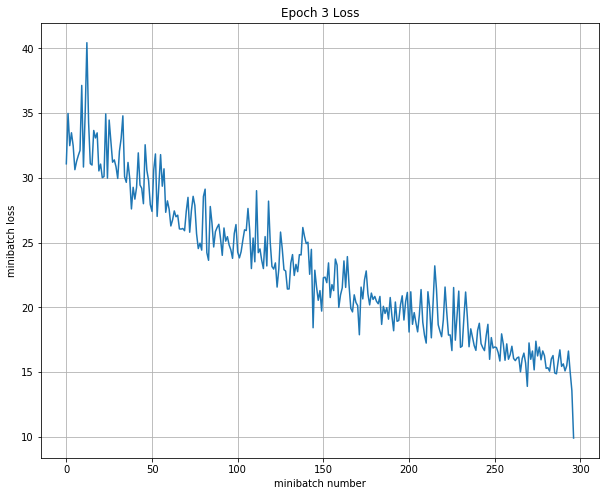

Iteration 900: with minibatch training loss = 2.77 and accuracy of 0
Iteration 1000: with minibatch training loss = 2.12 and accuracy of 0
Iteration 1100: with minibatch training loss = 1.83 and accuracy of 0.67
Epoch 4, Overall loss = 2.04 and accuracy of 0.282


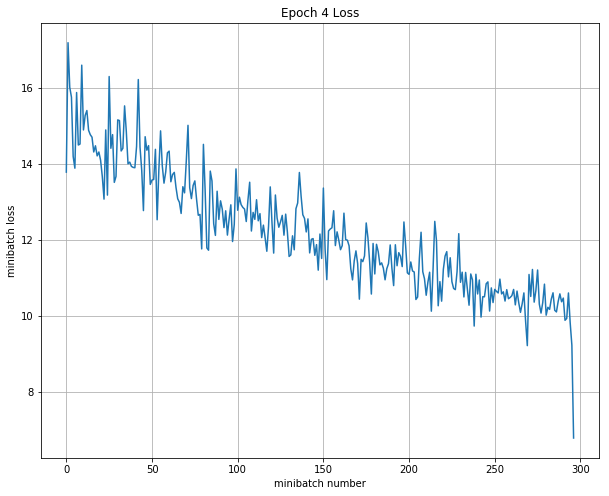

Iteration 1200: with minibatch training loss = 1.75 and accuracy of 0.17
Iteration 1300: with minibatch training loss = 1.6 and accuracy of 0.33
Iteration 1400: with minibatch training loss = 1.53 and accuracy of 0.33
Epoch 5, Overall loss = 1.56 and accuracy of 0.287


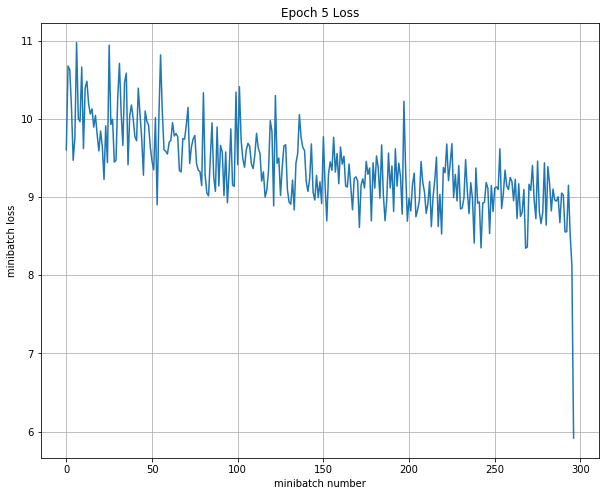

Iteration 1500: with minibatch training loss = 1.5 and accuracy of 0.17
Iteration 1600: with minibatch training loss = 1.43 and accuracy of 0.17
Iteration 1700: with minibatch training loss = 1.4 and accuracy of 0
Epoch 6, Overall loss = 1.44 and accuracy of 0.27


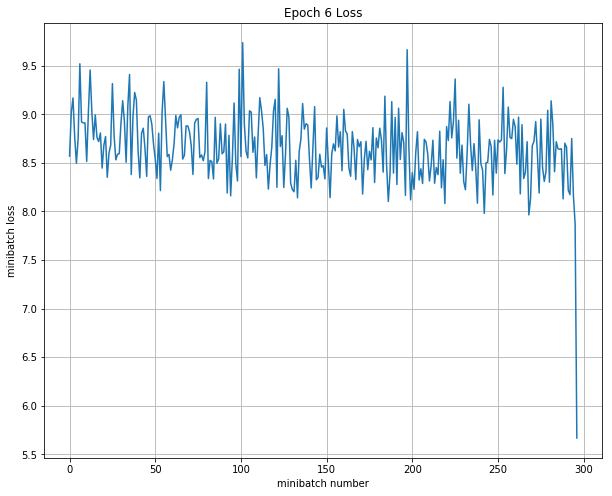

Iteration 1800: with minibatch training loss = 1.42 and accuracy of 0
Iteration 1900: with minibatch training loss = 1.41 and accuracy of 0.67
Iteration 2000: with minibatch training loss = 1.39 and accuracy of 0.33
Epoch 7, Overall loss = 1.41 and accuracy of 0.304


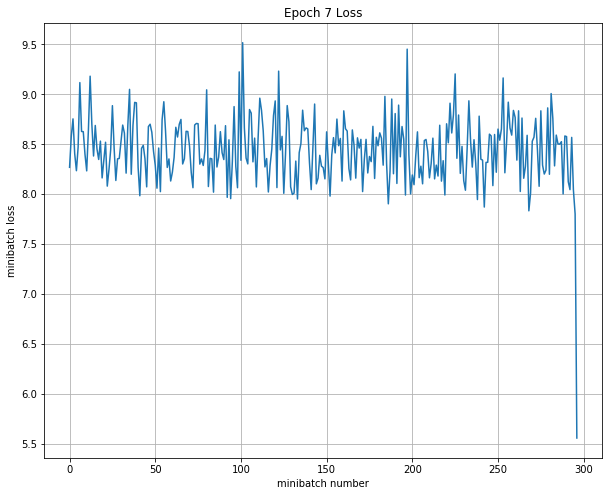

Iteration 2100: with minibatch training loss = 1.4 and accuracy of 0
Iteration 2200: with minibatch training loss = 1.33 and accuracy of 0.33
Iteration 2300: with minibatch training loss = 1.4 and accuracy of 0.5
Epoch 8, Overall loss = 1.39 and accuracy of 0.306


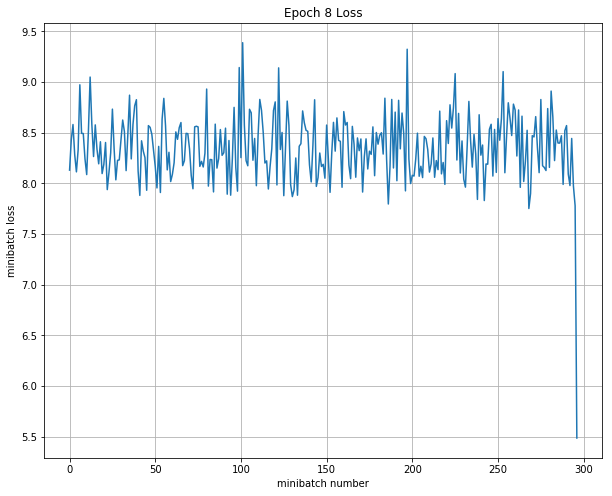

Iteration 2400: with minibatch training loss = 1.36 and accuracy of 0.17
Iteration 2500: with minibatch training loss = 1.41 and accuracy of 0.33
Iteration 2600: with minibatch training loss = 1.45 and accuracy of 0.33
Epoch 9, Overall loss = 1.38 and accuracy of 0.306


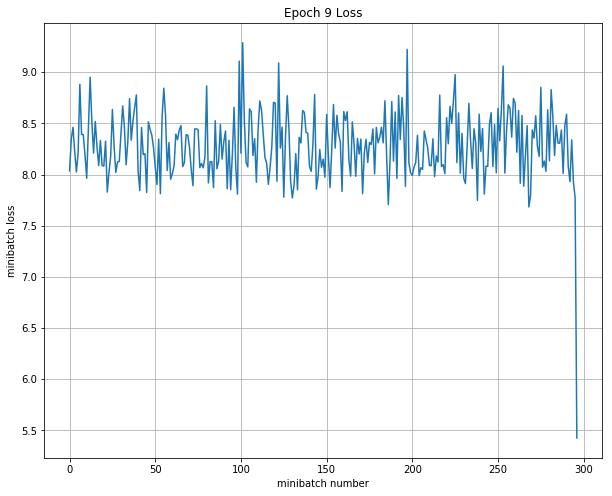

Iteration 2700: with minibatch training loss = 1.34 and accuracy of 0.5
Iteration 2800: with minibatch training loss = 1.46 and accuracy of 0.17
Iteration 2900: with minibatch training loss = 1.42 and accuracy of 0.33
Epoch 10, Overall loss = 1.37 and accuracy of 0.306


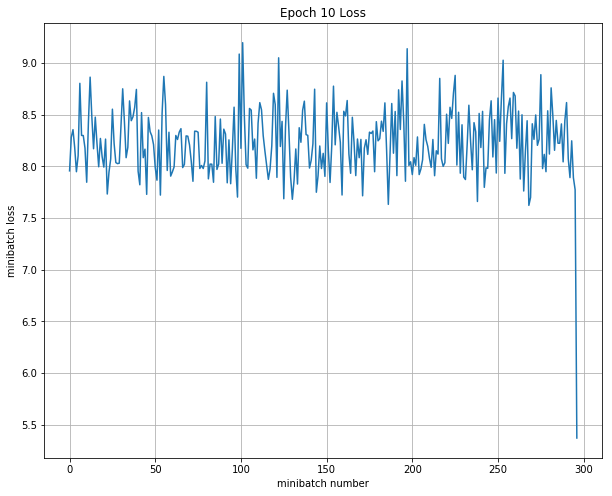

Train all layer
Iteration 0: with minibatch training loss = 1.36 and accuracy of 0.67
Iteration 100: with minibatch training loss = 1.53 and accuracy of 0.17
Iteration 200: with minibatch training loss = 1.53 and accuracy of 0.17
Epoch 1, Overall loss = 1.59 and accuracy of 0.303


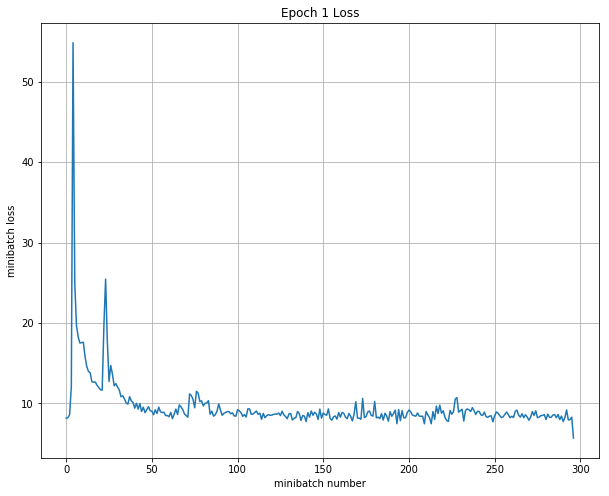

Iteration 300: with minibatch training loss = 1.37 and accuracy of 0
Iteration 400: with minibatch training loss = 1.52 and accuracy of 0.17
Iteration 500: with minibatch training loss = 1.39 and accuracy of 0.5
Epoch 2, Overall loss = 1.4 and accuracy of 0.325


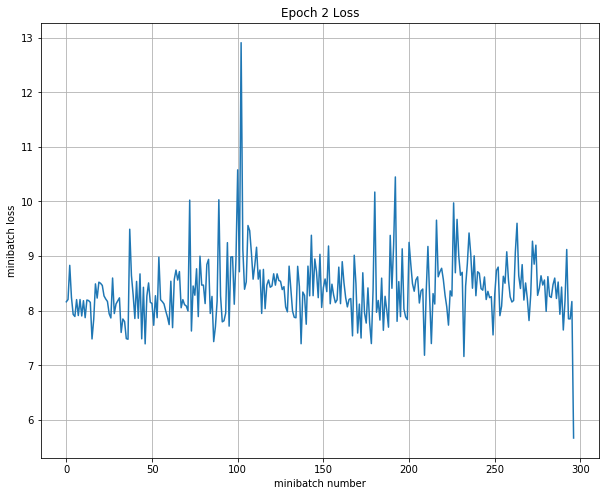

Iteration 600: with minibatch training loss = 1.35 and accuracy of 0.33
Iteration 700: with minibatch training loss = 1.54 and accuracy of 0.5
Iteration 800: with minibatch training loss = 1.35 and accuracy of 0.33
Epoch 3, Overall loss = 1.4 and accuracy of 0.339


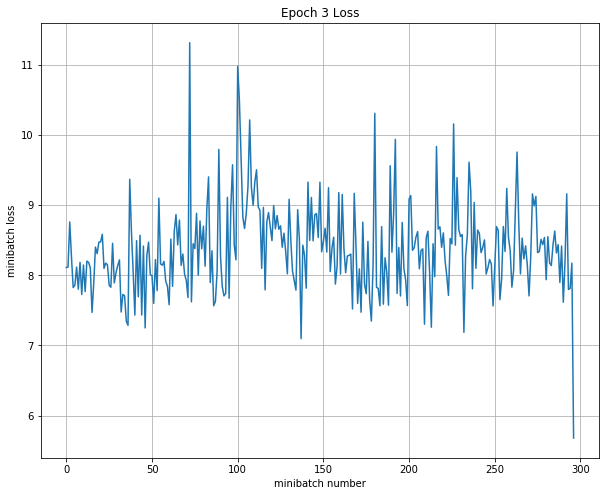

Iteration 900: with minibatch training loss = 1.25 and accuracy of 0.67
Iteration 1000: with minibatch training loss = 1.43 and accuracy of 0.33
Iteration 1100: with minibatch training loss = 1.24 and accuracy of 0.67
Epoch 4, Overall loss = 1.4 and accuracy of 0.324


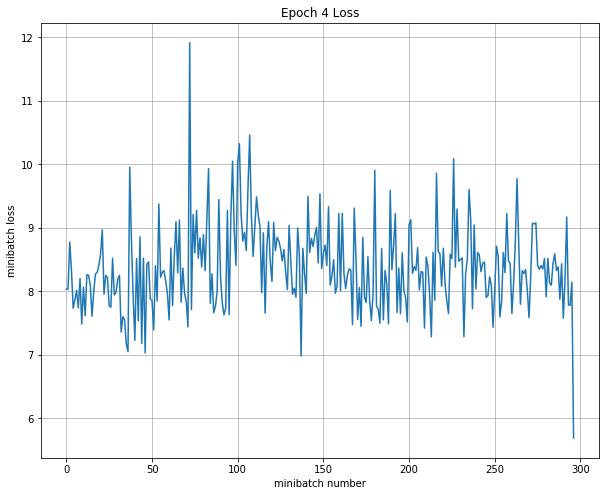

Iteration 1200: with minibatch training loss = 1.38 and accuracy of 0.33
Iteration 1300: with minibatch training loss = 1.56 and accuracy of 0
Iteration 1400: with minibatch training loss = 1.31 and accuracy of 0.33
Epoch 5, Overall loss = 1.39 and accuracy of 0.327


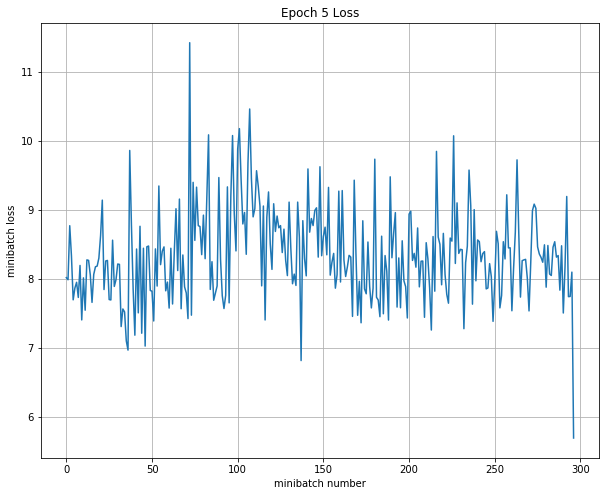

Iteration 1500: with minibatch training loss = 1.27 and accuracy of 0
Iteration 1600: with minibatch training loss = 1.5 and accuracy of 0.33
Iteration 1700: with minibatch training loss = 1.3 and accuracy of 0.33
Epoch 6, Overall loss = 1.39 and accuracy of 0.329


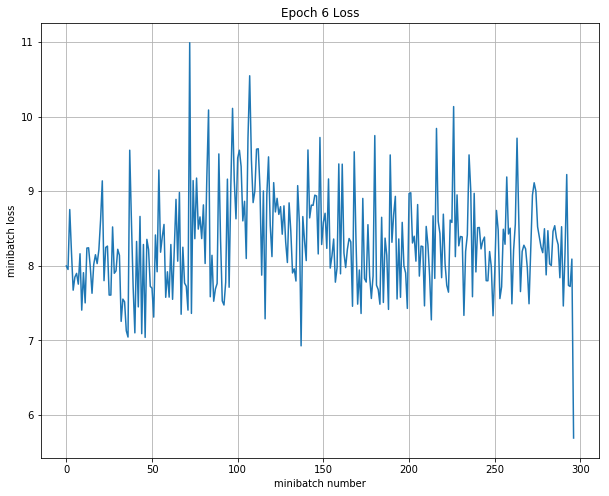

Iteration 1800: with minibatch training loss = 1.33 and accuracy of 0.17
Iteration 1900: with minibatch training loss = 1.61 and accuracy of 0.33
Iteration 2000: with minibatch training loss = 1.39 and accuracy of 0.17
Epoch 7, Overall loss = 1.38 and accuracy of 0.33


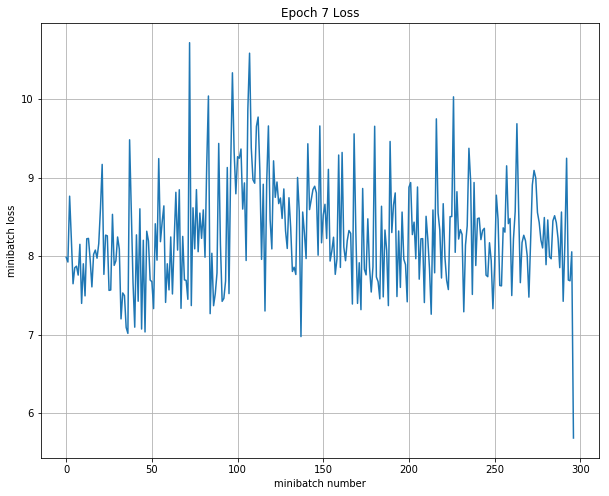

Iteration 2100: with minibatch training loss = 1.52 and accuracy of 0.33
Iteration 2200: with minibatch training loss = 1.54 and accuracy of 0.17
Iteration 2300: with minibatch training loss = 1.33 and accuracy of 0.17
Epoch 8, Overall loss = 1.38 and accuracy of 0.331


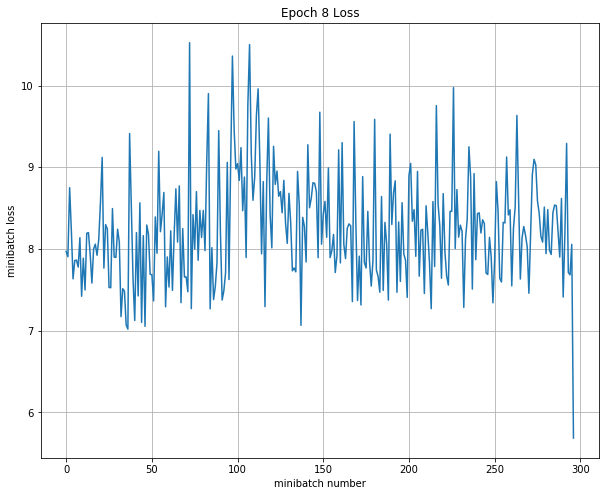

Iteration 2400: with minibatch training loss = 1.38 and accuracy of 0.17
Iteration 2500: with minibatch training loss = 1.45 and accuracy of 0.17
Iteration 2600: with minibatch training loss = 1.44 and accuracy of 0.5
Epoch 9, Overall loss = 1.38 and accuracy of 0.334


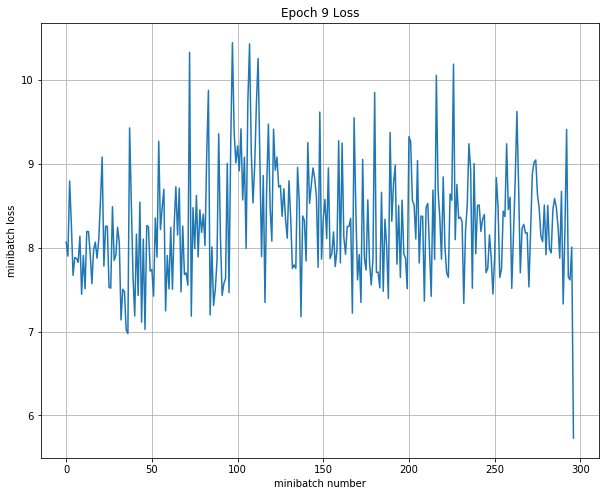

Iteration 2700: with minibatch training loss = 1.41 and accuracy of 0.17
Iteration 2800: with minibatch training loss = 1.41 and accuracy of 0.17
Iteration 2900: with minibatch training loss = 1.32 and accuracy of 0.33
Epoch 10, Overall loss = 1.38 and accuracy of 0.327


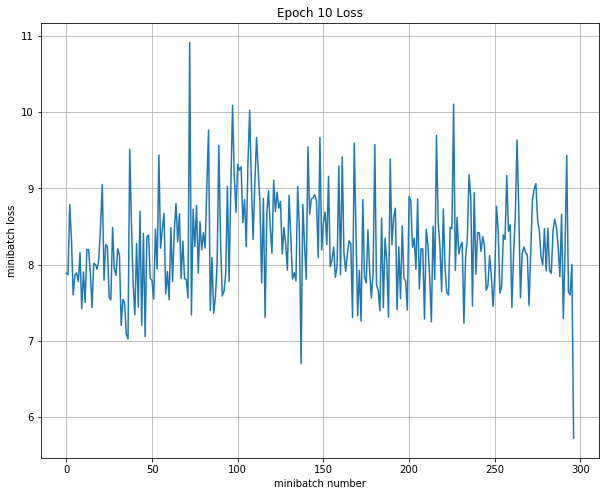

Validation
Epoch 1, Overall loss = 1.37 and accuracy of 0.28
Test
Epoch 1, Overall loss = 1.36 and accuracy of 0.26

--------------------------------------------------------------------------------
Trial number: 8
--------------------------------------------------------------------------------
reg: 0.002214, lr: 0.000984, dr: 0.979539, dc: 976, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 1.59 and accuracy of 0.33
Iteration 100: with minibatch training loss = 16.6 and accuracy of 0.33
Iteration 200: with minibatch training loss = 8.13 and accuracy of 0.33
Epoch 1, Overall loss = 15.7 and accuracy of 0.365


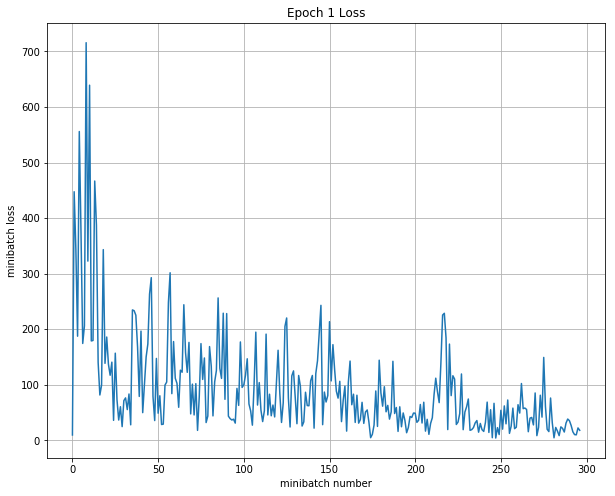

Iteration 300: with minibatch training loss = 8.29 and accuracy of 0.33
Iteration 400: with minibatch training loss = 22.7 and accuracy of 0.17
Iteration 500: with minibatch training loss = 2.36 and accuracy of 0.5
Epoch 2, Overall loss = 7.97 and accuracy of 0.44


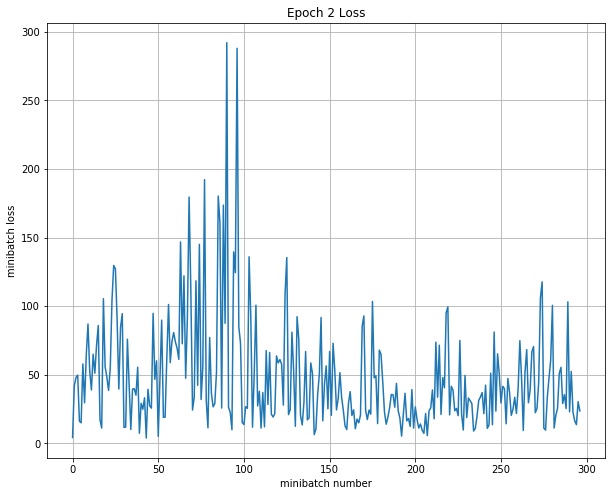

Iteration 600: with minibatch training loss = 6.15 and accuracy of 0.17
Iteration 700: with minibatch training loss = 6.68 and accuracy of 0.33
Iteration 800: with minibatch training loss = 5.66 and accuracy of 0.33
Epoch 3, Overall loss = 3.87 and accuracy of 0.483


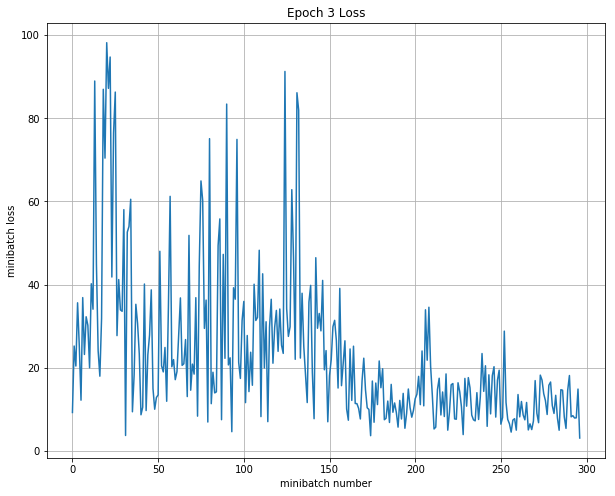

Iteration 900: with minibatch training loss = 1.26 and accuracy of 0.67
Iteration 1000: with minibatch training loss = 5.76 and accuracy of 0
Iteration 1100: with minibatch training loss = 2.12 and accuracy of 0.67
Epoch 4, Overall loss = 2.2 and accuracy of 0.512


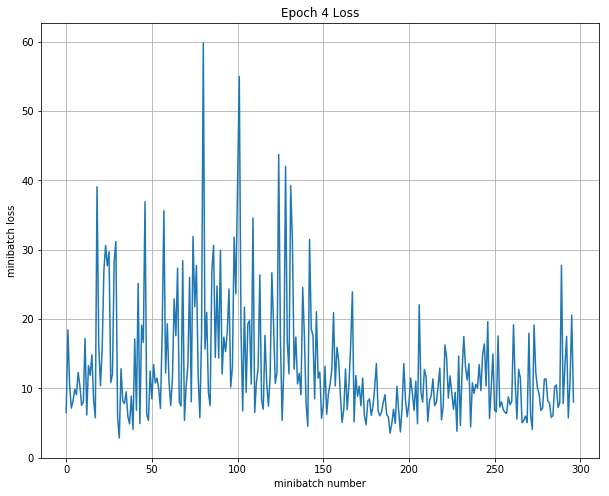

Iteration 1200: with minibatch training loss = 1.3 and accuracy of 0.5
Iteration 1300: with minibatch training loss = 1.76 and accuracy of 0.5
Iteration 1400: with minibatch training loss = 2.6 and accuracy of 0.5
Epoch 5, Overall loss = 1.76 and accuracy of 0.538


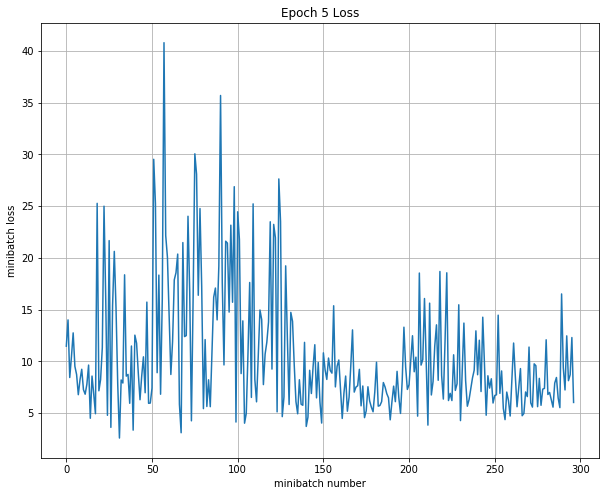

Iteration 1500: with minibatch training loss = 1.48 and accuracy of 0.5
Iteration 1600: with minibatch training loss = 1.85 and accuracy of 0.67
Iteration 1700: with minibatch training loss = 1.63 and accuracy of 0.5
Epoch 6, Overall loss = 1.47 and accuracy of 0.538


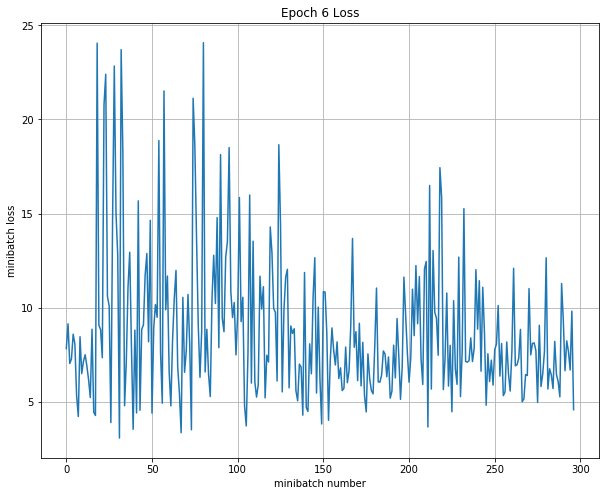

Iteration 1800: with minibatch training loss = 3.1 and accuracy of 0.17
Iteration 1900: with minibatch training loss = 1.32 and accuracy of 0.67
Iteration 2000: with minibatch training loss = 2.48 and accuracy of 0.33
Epoch 7, Overall loss = 1.38 and accuracy of 0.52


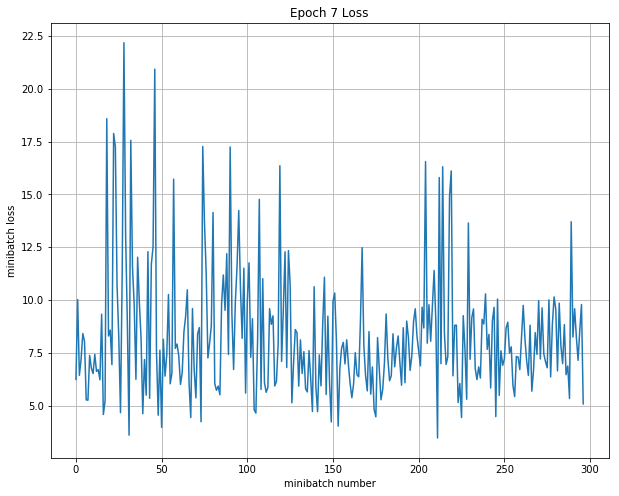

Iteration 2100: with minibatch training loss = 1.08 and accuracy of 0.67
Iteration 2200: with minibatch training loss = 1.16 and accuracy of 0.67
Iteration 2300: with minibatch training loss = 1.63 and accuracy of 0.5
Epoch 8, Overall loss = 1.32 and accuracy of 0.521


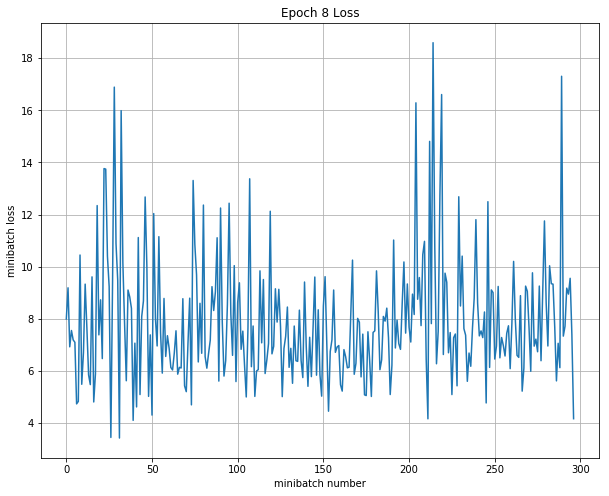

Iteration 2400: with minibatch training loss = 2.37 and accuracy of 0
Iteration 2500: with minibatch training loss = 1.64 and accuracy of 0.5
Iteration 2600: with minibatch training loss = 1.62 and accuracy of 0.5
Epoch 9, Overall loss = 1.33 and accuracy of 0.503


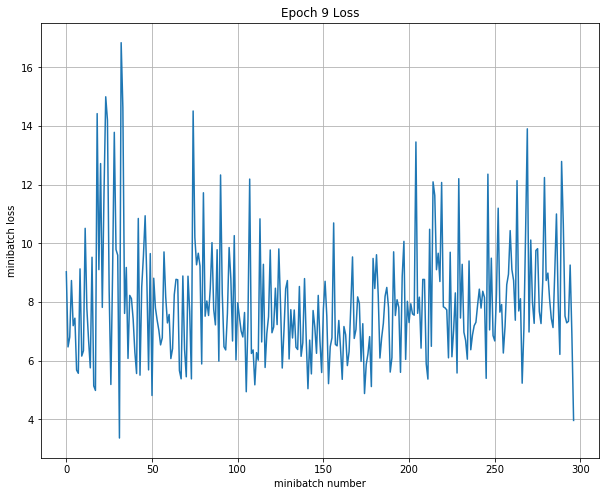

Iteration 2700: with minibatch training loss = 1.23 and accuracy of 0.5
Iteration 2800: with minibatch training loss = 1.28 and accuracy of 0.33
Iteration 2900: with minibatch training loss = 1.63 and accuracy of 0.33
Epoch 10, Overall loss = 1.32 and accuracy of 0.497


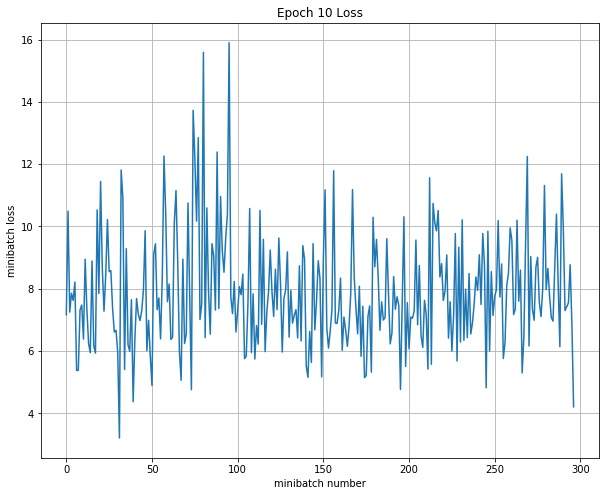

Train all layer
Iteration 0: with minibatch training loss = 1.02 and accuracy of 0.67
Iteration 100: with minibatch training loss = 2.46 and accuracy of 0
Iteration 200: with minibatch training loss = 2.11 and accuracy of 0.5
Epoch 1, Overall loss = 2.75 and accuracy of 0.308


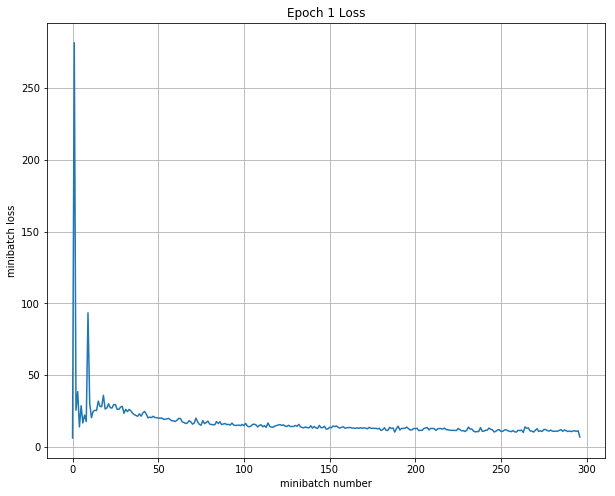

Iteration 300: with minibatch training loss = 1.92 and accuracy of 0.17
Iteration 400: with minibatch training loss = 1.54 and accuracy of 0.5
Iteration 500: with minibatch training loss = 1.56 and accuracy of 0.67
Epoch 2, Overall loss = 1.68 and accuracy of 0.313


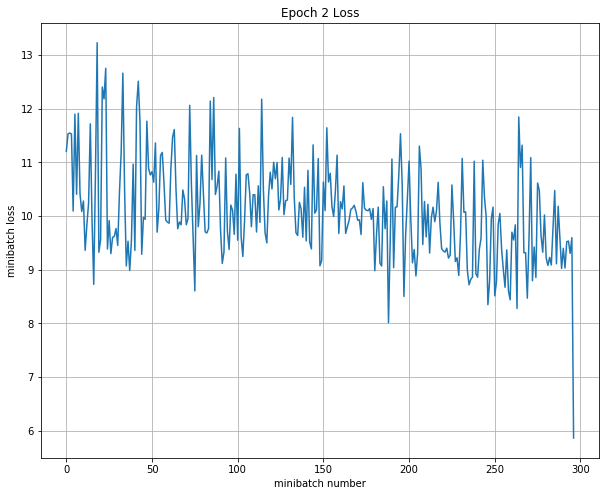

Iteration 600: with minibatch training loss = 1.48 and accuracy of 0.33
Iteration 700: with minibatch training loss = 1.63 and accuracy of 0
Iteration 800: with minibatch training loss = 1.8 and accuracy of 0.17
Epoch 3, Overall loss = 1.51 and accuracy of 0.313


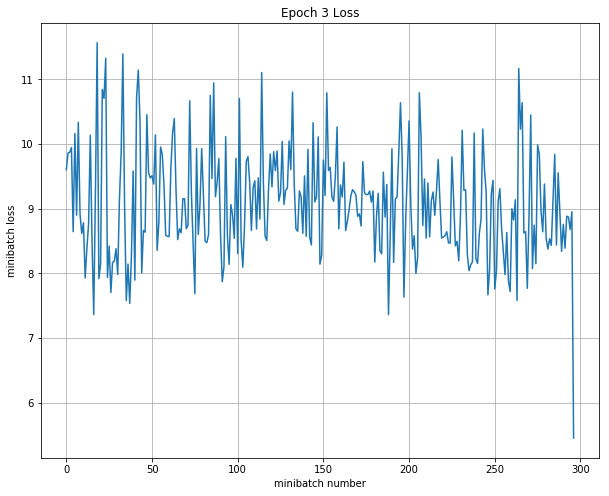

Iteration 900: with minibatch training loss = 1.34 and accuracy of 0.5
Iteration 1000: with minibatch training loss = 1.47 and accuracy of 0.33
Iteration 1100: with minibatch training loss = 1.51 and accuracy of 0.17
Epoch 4, Overall loss = 1.44 and accuracy of 0.315


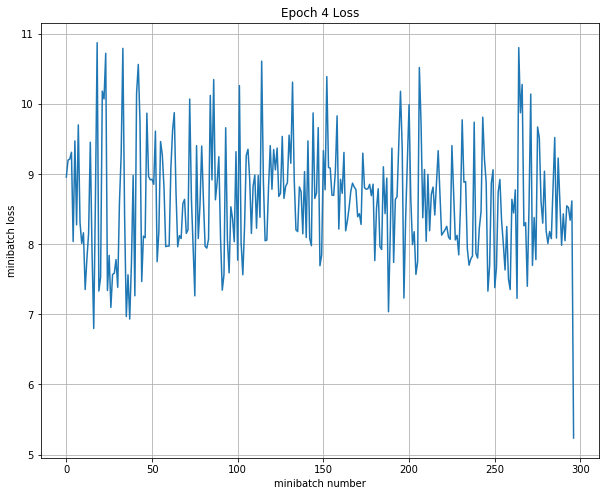

Iteration 1200: with minibatch training loss = 1.25 and accuracy of 0.5
Iteration 1300: with minibatch training loss = 1.45 and accuracy of 0.33
Iteration 1400: with minibatch training loss = 1.33 and accuracy of 0.67
Epoch 5, Overall loss = 1.39 and accuracy of 0.313


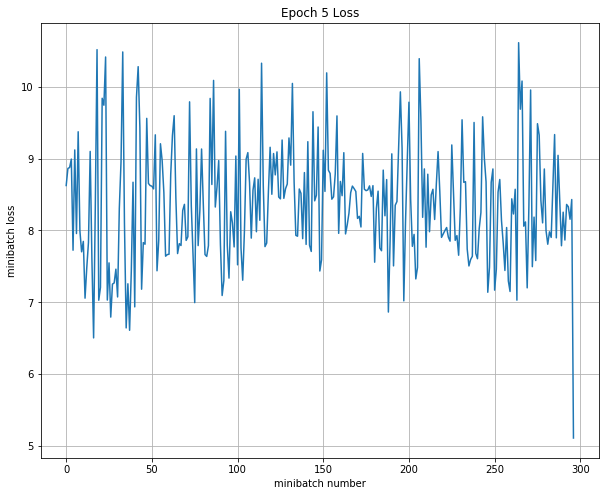

Iteration 1500: with minibatch training loss = 1.24 and accuracy of 0.5
Iteration 1600: with minibatch training loss = 1.41 and accuracy of 0.33
Iteration 1700: with minibatch training loss = 1.33 and accuracy of 0
Epoch 6, Overall loss = 1.37 and accuracy of 0.313


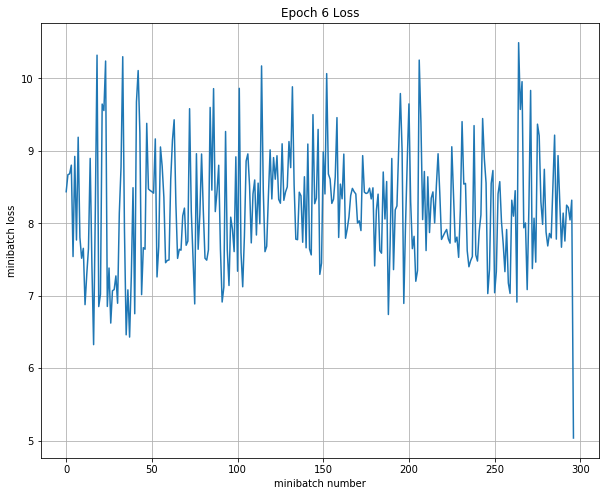

Iteration 1800: with minibatch training loss = 1.71 and accuracy of 0.17
Iteration 1900: with minibatch training loss = 1.38 and accuracy of 0.33
Iteration 2000: with minibatch training loss = 1.39 and accuracy of 0.33
Epoch 7, Overall loss = 1.36 and accuracy of 0.314


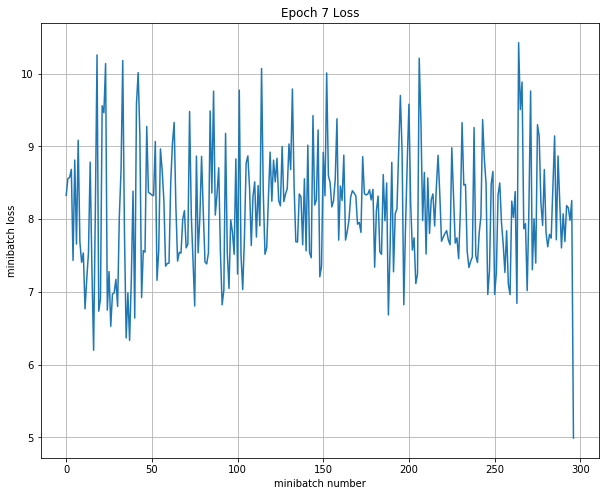

Iteration 2100: with minibatch training loss = 1.58 and accuracy of 0.33
Iteration 2200: with minibatch training loss = 1.46 and accuracy of 0
Iteration 2300: with minibatch training loss = 1.29 and accuracy of 0.33
Epoch 8, Overall loss = 1.35 and accuracy of 0.314


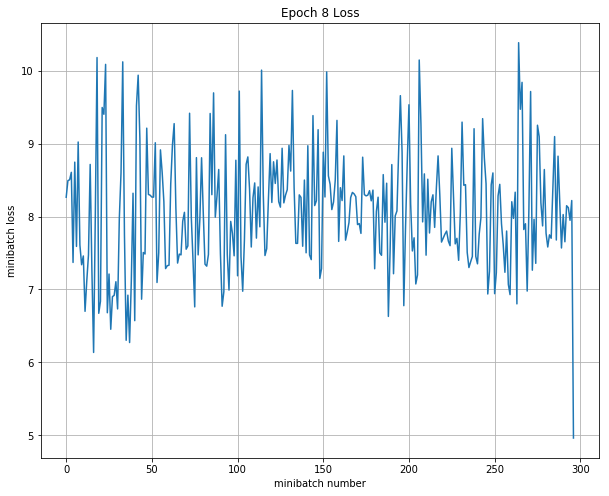

Iteration 2400: with minibatch training loss = 1.11 and accuracy of 0.5
Iteration 2500: with minibatch training loss = 1.36 and accuracy of 0.17
Iteration 2600: with minibatch training loss = 1.26 and accuracy of 0.67
Epoch 9, Overall loss = 1.34 and accuracy of 0.314


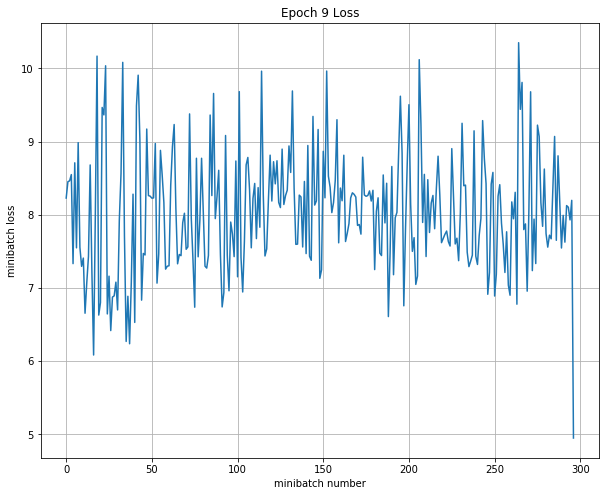

Iteration 2700: with minibatch training loss = 1.15 and accuracy of 0.33
Iteration 2800: with minibatch training loss = 1.35 and accuracy of 0.17
Iteration 2900: with minibatch training loss = 1.26 and accuracy of 0.33
Epoch 10, Overall loss = 1.34 and accuracy of 0.315


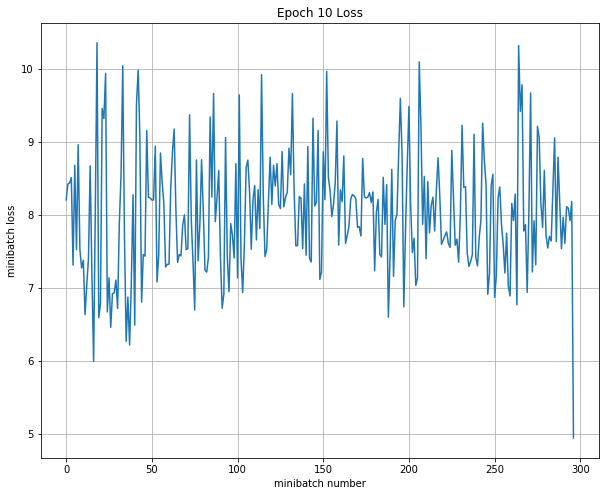

Validation
Epoch 1, Overall loss = 1.33 and accuracy of 0.28
Test
Epoch 1, Overall loss = 1.35 and accuracy of 0.26

--------------------------------------------------------------------------------
Trial number: 9
--------------------------------------------------------------------------------
reg: 0.858461, lr: 0.000002, dr: 0.998058, dc: 502, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 91 and accuracy of 0.17
Iteration 100: with minibatch training loss = 81.5 and accuracy of 0.17
Iteration 200: with minibatch training loss = 73.3 and accuracy of 0.5
Epoch 1, Overall loss = 77.8 and accuracy of 0.325


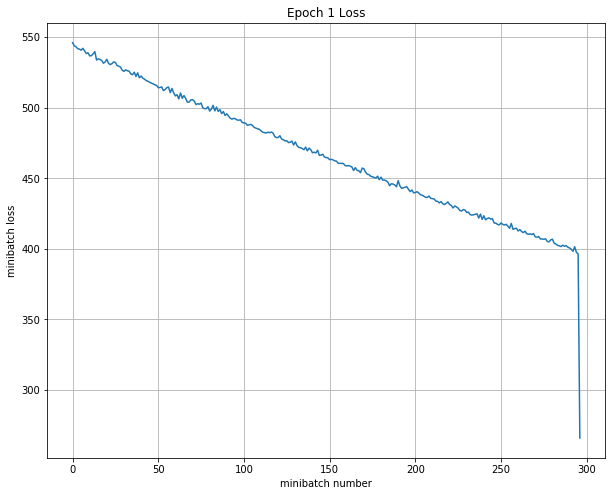

Iteration 300: with minibatch training loss = 65.8 and accuracy of 0.5
Iteration 400: with minibatch training loss = 59.6 and accuracy of 0.33
Iteration 500: with minibatch training loss = 53.7 and accuracy of 0
Epoch 2, Overall loss = 57.1 and accuracy of 0.347


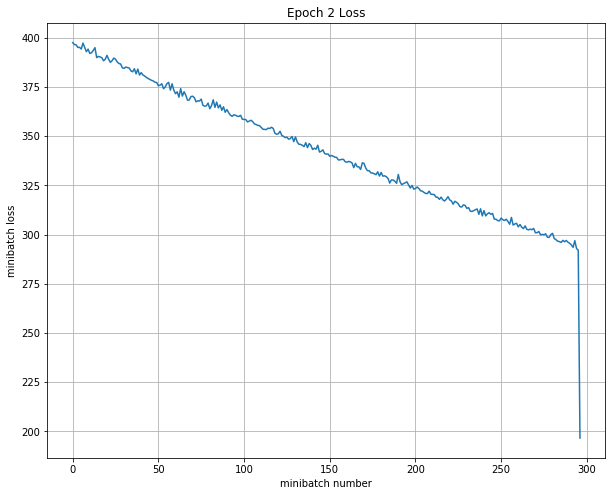

Iteration 600: with minibatch training loss = 49 and accuracy of 0
Iteration 700: with minibatch training loss = 44 and accuracy of 0.17
Iteration 800: with minibatch training loss = 39.8 and accuracy of 0.5
Epoch 3, Overall loss = 42.4 and accuracy of 0.358


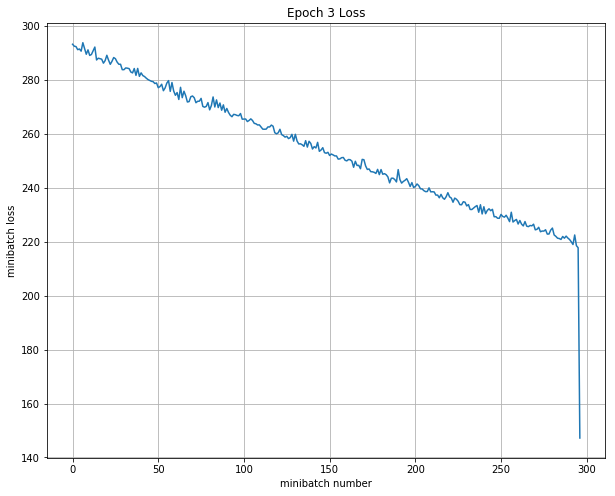

Iteration 900: with minibatch training loss = 36.3 and accuracy of 0.5
Iteration 1000: with minibatch training loss = 33 and accuracy of 0.17
Iteration 1100: with minibatch training loss = 30.1 and accuracy of 0.5
Epoch 4, Overall loss = 31.9 and accuracy of 0.371


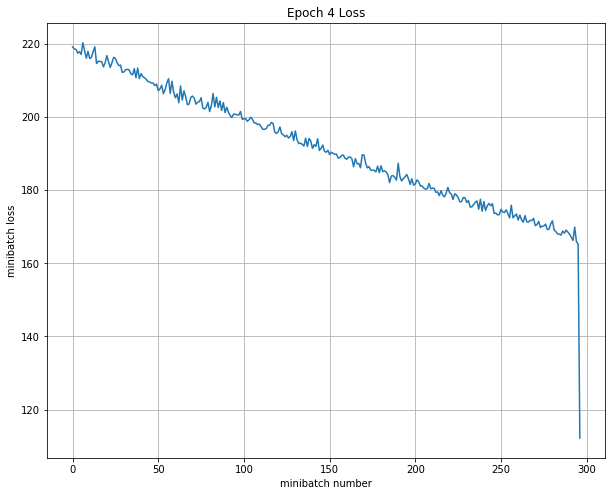

Iteration 1200: with minibatch training loss = 27.7 and accuracy of 0.17
Iteration 1300: with minibatch training loss = 25.1 and accuracy of 0.67
Iteration 1400: with minibatch training loss = 23.1 and accuracy of 0.67
Epoch 5, Overall loss = 24.6 and accuracy of 0.376


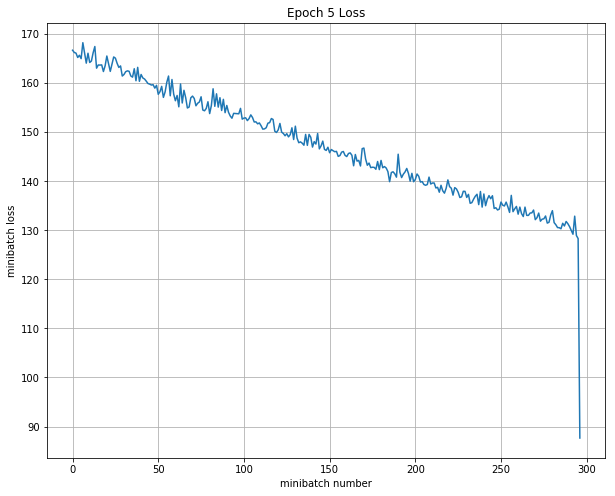

Iteration 1500: with minibatch training loss = 21.2 and accuracy of 0.33
Iteration 1600: with minibatch training loss = 20 and accuracy of 0.17
Iteration 1700: with minibatch training loss = 18.5 and accuracy of 0.33
Epoch 6, Overall loss = 19.4 and accuracy of 0.381


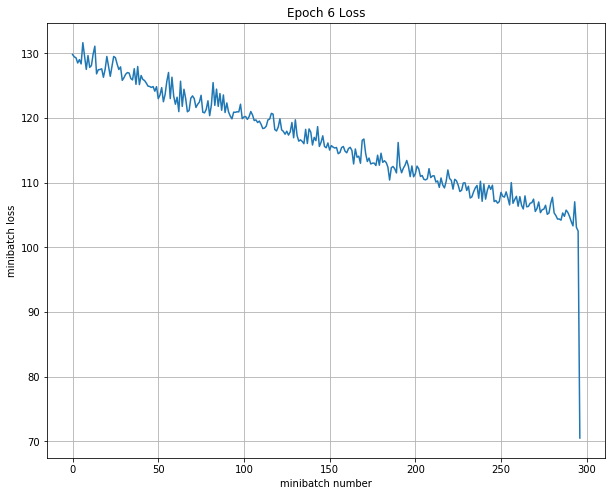

Iteration 1800: with minibatch training loss = 16.9 and accuracy of 0.67
Iteration 1900: with minibatch training loss = 16 and accuracy of 0.5
Iteration 2000: with minibatch training loss = 15.1 and accuracy of 0.67
Epoch 7, Overall loss = 15.8 and accuracy of 0.382


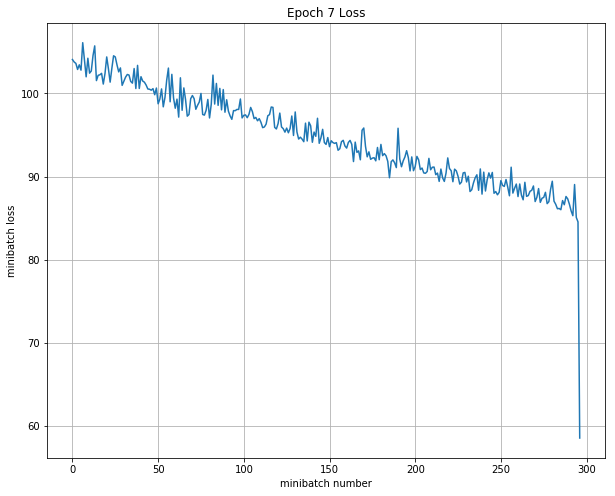

Iteration 2100: with minibatch training loss = 14.2 and accuracy of 0.17
Iteration 2200: with minibatch training loss = 13.7 and accuracy of 0
Iteration 2300: with minibatch training loss = 12.8 and accuracy of 0.67
Epoch 8, Overall loss = 13.3 and accuracy of 0.39


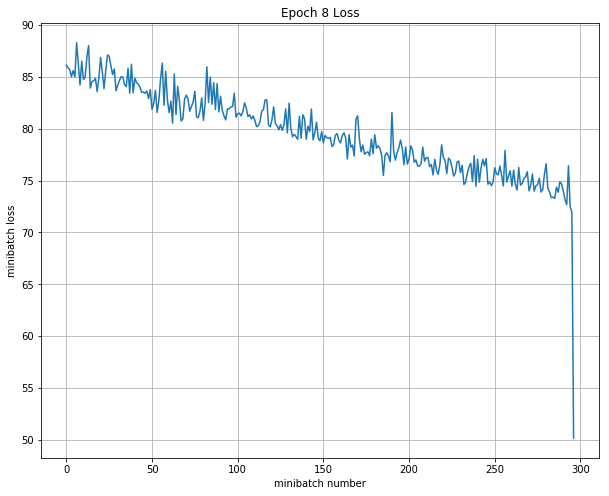

Iteration 2400: with minibatch training loss = 12.5 and accuracy of 0.33
Iteration 2500: with minibatch training loss = 11.5 and accuracy of 0.33
Iteration 2600: with minibatch training loss = 11.2 and accuracy of 0.33
Epoch 9, Overall loss = 11.5 and accuracy of 0.393


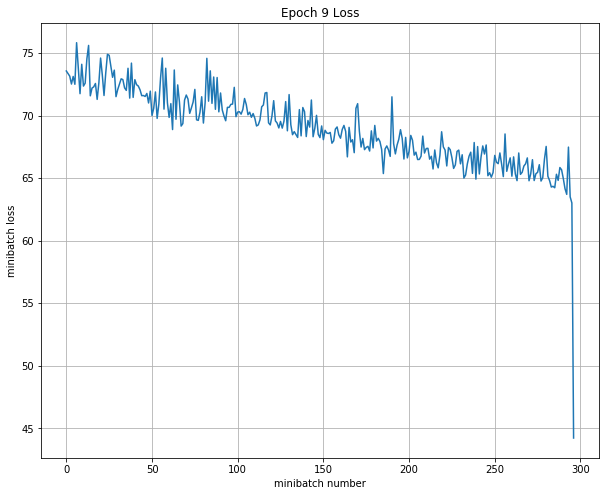

Iteration 2700: with minibatch training loss = 10.7 and accuracy of 0.33
Iteration 2800: with minibatch training loss = 10.3 and accuracy of 0.67
Iteration 2900: with minibatch training loss = 9.84 and accuracy of 0.33
Epoch 10, Overall loss = 10.2 and accuracy of 0.396


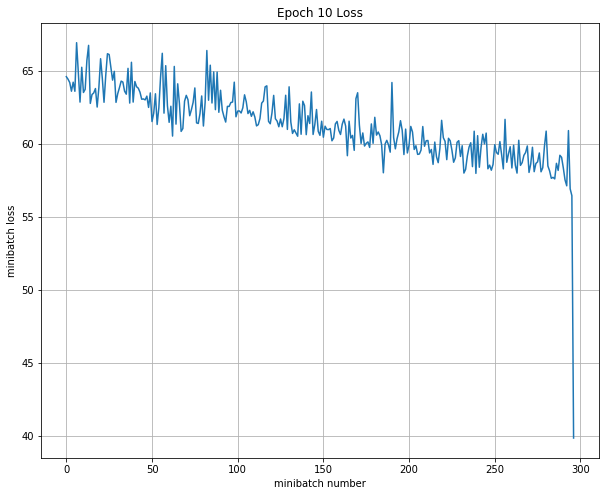

Train all layer
Iteration 0: with minibatch training loss = 9.48 and accuracy of 0.67
Iteration 100: with minibatch training loss = 9.32 and accuracy of 0.83
Iteration 200: with minibatch training loss = 9.19 and accuracy of 0.33
Epoch 1, Overall loss = 9.24 and accuracy of 0.415


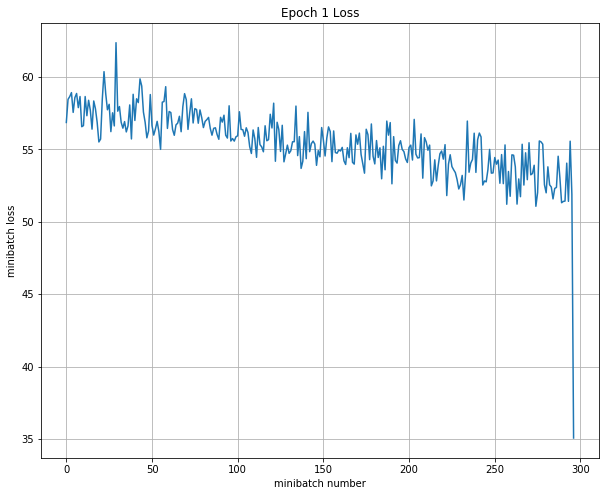

Iteration 300: with minibatch training loss = 8.86 and accuracy of 0.67
Iteration 400: with minibatch training loss = 8.6 and accuracy of 0.5
Iteration 500: with minibatch training loss = 8.85 and accuracy of 0
Epoch 2, Overall loss = 8.43 and accuracy of 0.515


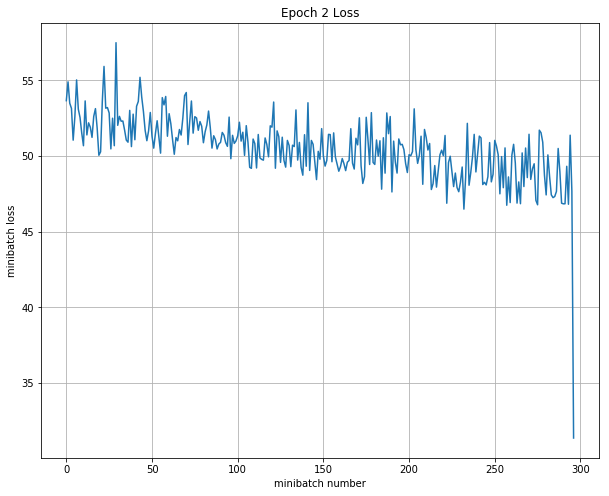

Iteration 600: with minibatch training loss = 8.78 and accuracy of 0.17
Iteration 700: with minibatch training loss = 7.74 and accuracy of 1
Iteration 800: with minibatch training loss = 7.74 and accuracy of 0.33
Epoch 3, Overall loss = 7.76 and accuracy of 0.576


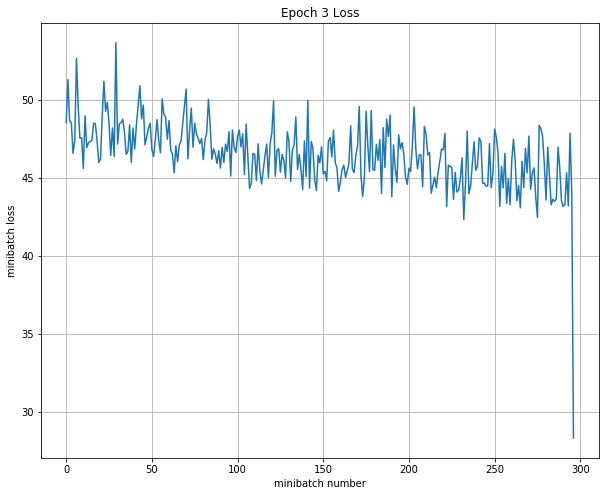

Iteration 900: with minibatch training loss = 7.37 and accuracy of 0.5
Iteration 1000: with minibatch training loss = 7.11 and accuracy of 0.67
Iteration 1100: with minibatch training loss = 7.5 and accuracy of 0.5
Epoch 4, Overall loss = 7.2 and accuracy of 0.638


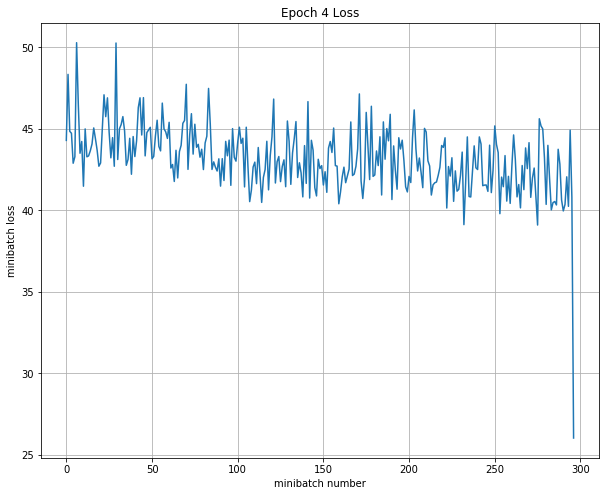

Iteration 1200: with minibatch training loss = 6.71 and accuracy of 0.83
Iteration 1300: with minibatch training loss = 6.87 and accuracy of 0.83
Iteration 1400: with minibatch training loss = 6.55 and accuracy of 0.83
Epoch 5, Overall loss = 6.73 and accuracy of 0.68


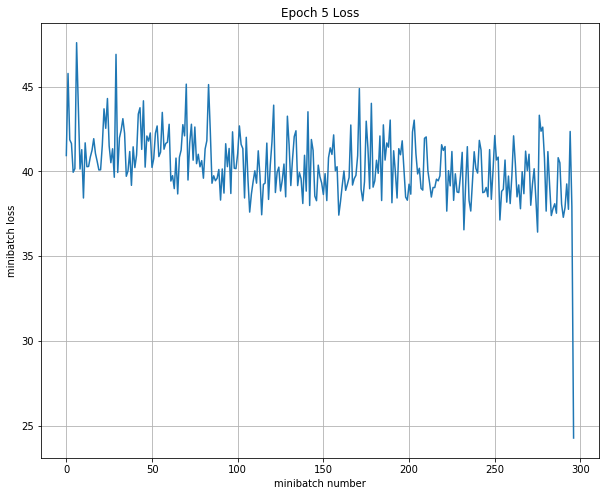

Iteration 1500: with minibatch training loss = 6.49 and accuracy of 0.67
Iteration 1600: with minibatch training loss = 6.14 and accuracy of 0.83
Iteration 1700: with minibatch training loss = 6.15 and accuracy of 1
Epoch 6, Overall loss = 6.33 and accuracy of 0.729


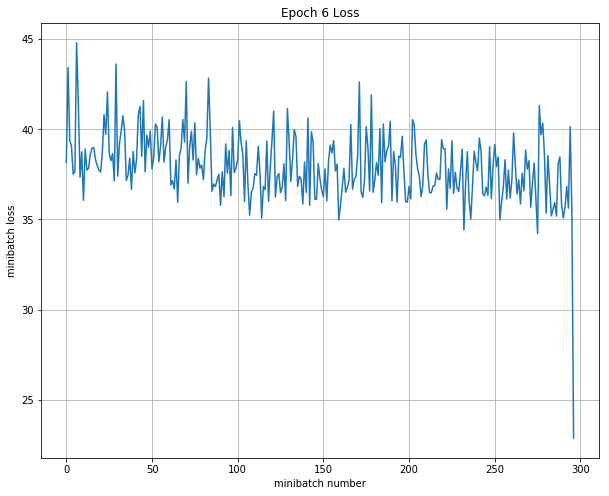

Iteration 1800: with minibatch training loss = 5.98 and accuracy of 0.83
Iteration 1900: with minibatch training loss = 5.68 and accuracy of 1
Iteration 2000: with minibatch training loss = 5.84 and accuracy of 1
Epoch 7, Overall loss = 5.98 and accuracy of 0.754


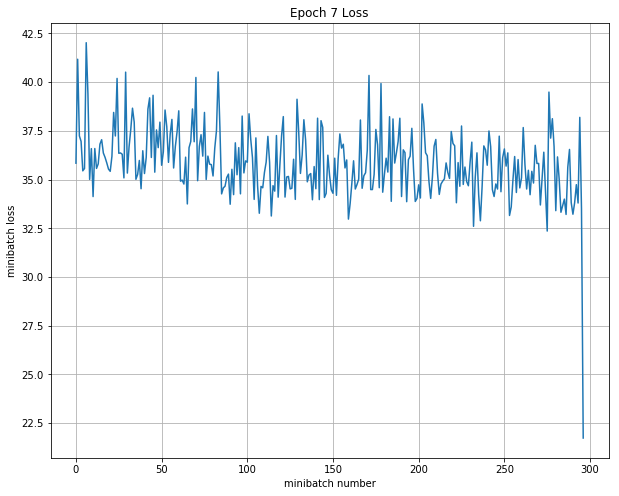

Iteration 2100: with minibatch training loss = 5.68 and accuracy of 0.83
Iteration 2200: with minibatch training loss = 5.94 and accuracy of 0.67
Iteration 2300: with minibatch training loss = 5.8 and accuracy of 0.5
Epoch 8, Overall loss = 5.68 and accuracy of 0.784


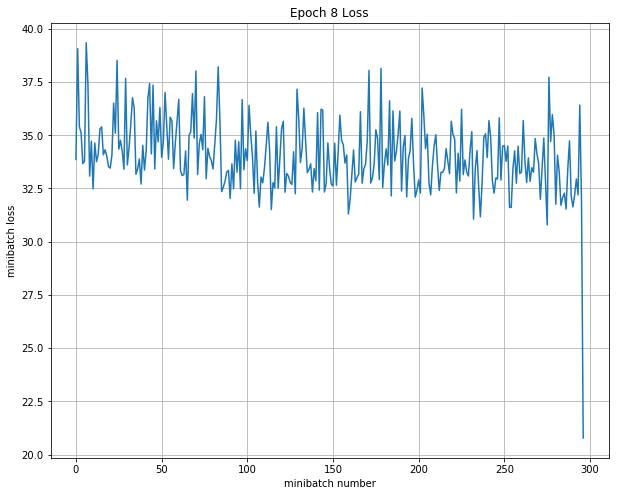

Iteration 2400: with minibatch training loss = 6.16 and accuracy of 0.33
Iteration 2500: with minibatch training loss = 5.22 and accuracy of 1
Iteration 2600: with minibatch training loss = 5.21 and accuracy of 0.83
Epoch 9, Overall loss = 5.41 and accuracy of 0.81


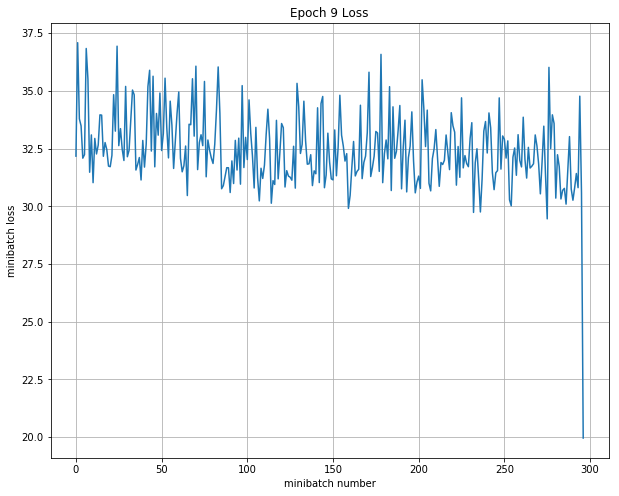

Iteration 2700: with minibatch training loss = 5.16 and accuracy of 1
Iteration 2800: with minibatch training loss = 5.19 and accuracy of 0.83
Iteration 2900: with minibatch training loss = 5.11 and accuracy of 0.83
Epoch 10, Overall loss = 5.18 and accuracy of 0.84


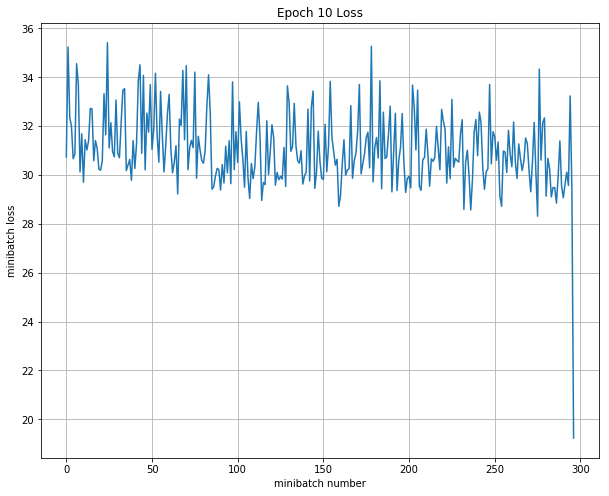

Validation
Epoch 1, Overall loss = 5.21 and accuracy of 0.8
Test
Epoch 1, Overall loss = 5.07 and accuracy of 0.84

--------------------------------------------------------------------------------
Trial number: 10
--------------------------------------------------------------------------------
reg: 8.365439, lr: 0.000018, dr: 0.895442, dc: 525, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 870 and accuracy of 0.33
Iteration 100: with minibatch training loss = 200 and accuracy of 0
Iteration 200: with minibatch training loss = 57.2 and accuracy of 0.67
Epoch 1, Overall loss = 207 and accuracy of 0.31


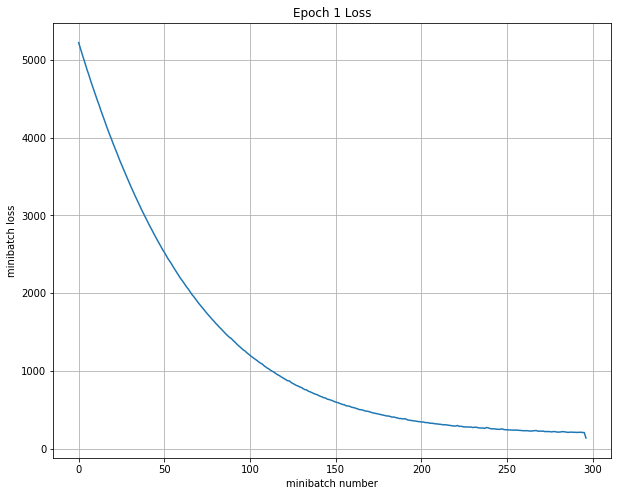

Iteration 300: with minibatch training loss = 35 and accuracy of 0.33
Iteration 400: with minibatch training loss = 31.6 and accuracy of 0.17
Iteration 500: with minibatch training loss = 30.2 and accuracy of 0.17
Epoch 2, Overall loss = 31.1 and accuracy of 0.308


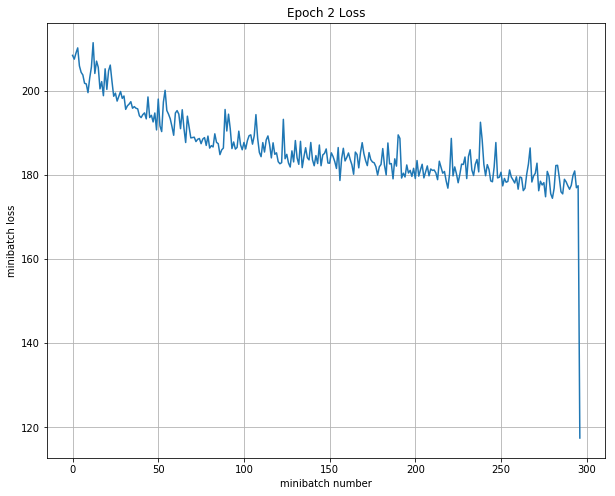

Iteration 600: with minibatch training loss = 29.4 and accuracy of 0.17
Iteration 700: with minibatch training loss = 29.4 and accuracy of 0.17
Iteration 800: with minibatch training loss = 28.2 and accuracy of 0.33
Epoch 3, Overall loss = 28.7 and accuracy of 0.308


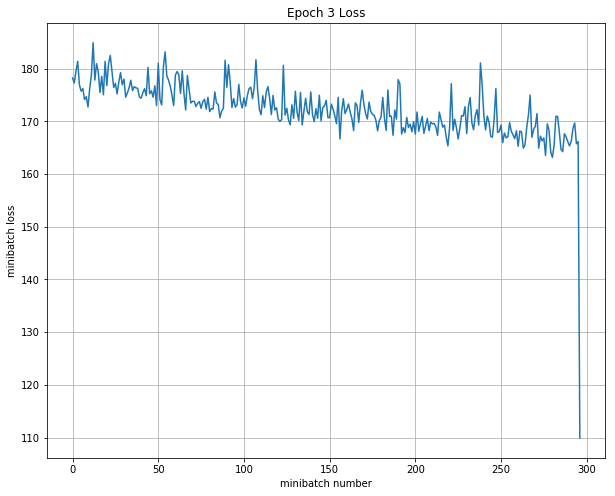

Iteration 900: with minibatch training loss = 26.9 and accuracy of 0.67
Iteration 1000: with minibatch training loss = 26.9 and accuracy of 0.33
Iteration 1100: with minibatch training loss = 26.5 and accuracy of 0.17
Epoch 4, Overall loss = 26.9 and accuracy of 0.308


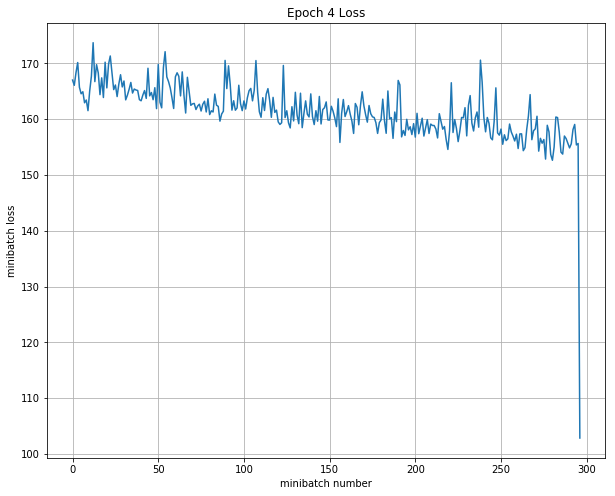

Iteration 1200: with minibatch training loss = 27.2 and accuracy of 0.33
Iteration 1300: with minibatch training loss = 25.2 and accuracy of 0.5
Iteration 1400: with minibatch training loss = 24.7 and accuracy of 0.33
Epoch 5, Overall loss = 25.2 and accuracy of 0.308


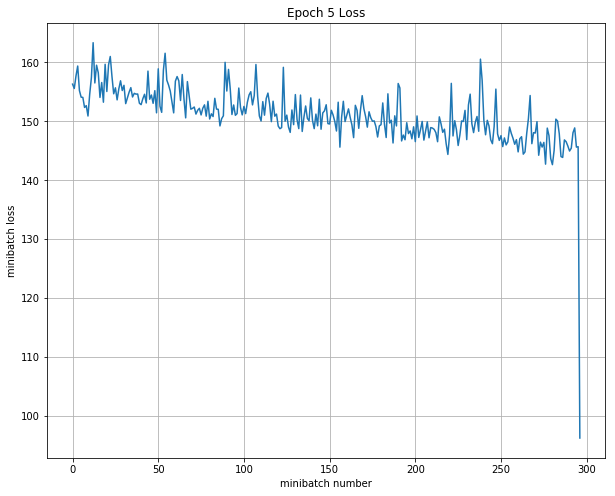

Iteration 1500: with minibatch training loss = 24.8 and accuracy of 0.17
Iteration 1600: with minibatch training loss = 23.8 and accuracy of 0.17
Iteration 1700: with minibatch training loss = 23.4 and accuracy of 0.17
Epoch 6, Overall loss = 23.6 and accuracy of 0.308


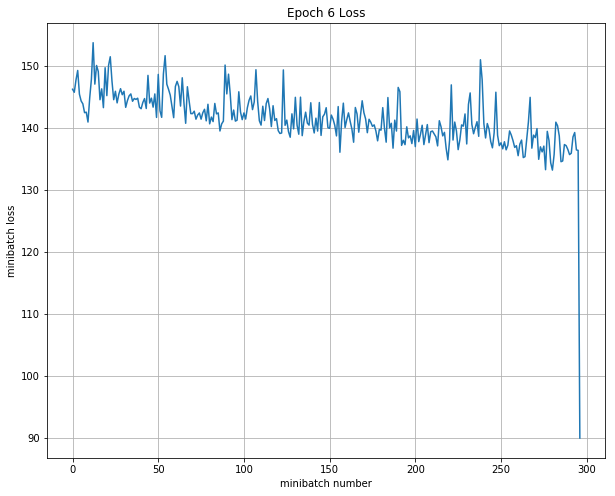

Iteration 1800: with minibatch training loss = 22.3 and accuracy of 0.67
Iteration 1900: with minibatch training loss = 22 and accuracy of 0.17
Iteration 2000: with minibatch training loss = 21.3 and accuracy of 0.5
Epoch 7, Overall loss = 22.1 and accuracy of 0.316


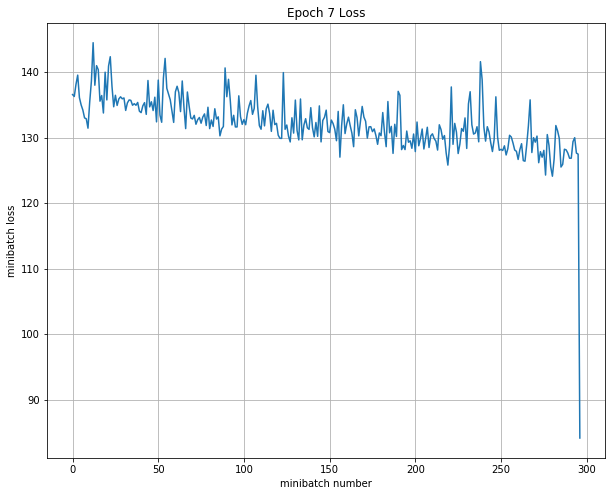

Iteration 2100: with minibatch training loss = 22 and accuracy of 0.17
Iteration 2200: with minibatch training loss = 20.2 and accuracy of 0.67
Iteration 2300: with minibatch training loss = 21.5 and accuracy of 0.17
Epoch 8, Overall loss = 20.6 and accuracy of 0.315


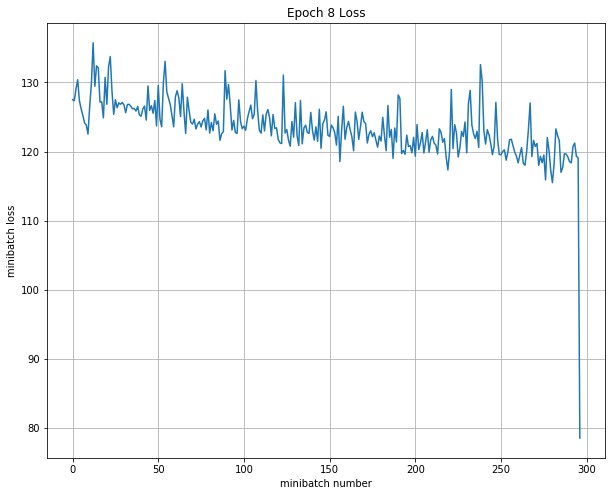

Iteration 2400: with minibatch training loss = 19.4 and accuracy of 0.17
Iteration 2500: with minibatch training loss = 19.1 and accuracy of 0.5
Iteration 2600: with minibatch training loss = 19.2 and accuracy of 0.17
Epoch 9, Overall loss = 19.2 and accuracy of 0.314


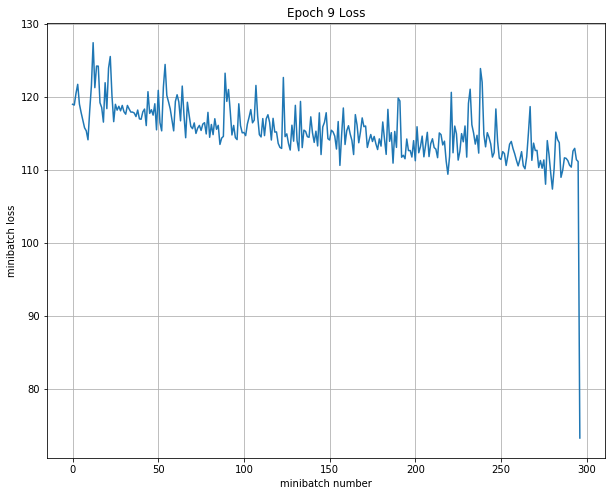

Iteration 2700: with minibatch training loss = 18.5 and accuracy of 0.17
Iteration 2800: with minibatch training loss = 17.5 and accuracy of 0.67
Iteration 2900: with minibatch training loss = 17.9 and accuracy of 0
Epoch 10, Overall loss = 17.9 and accuracy of 0.316


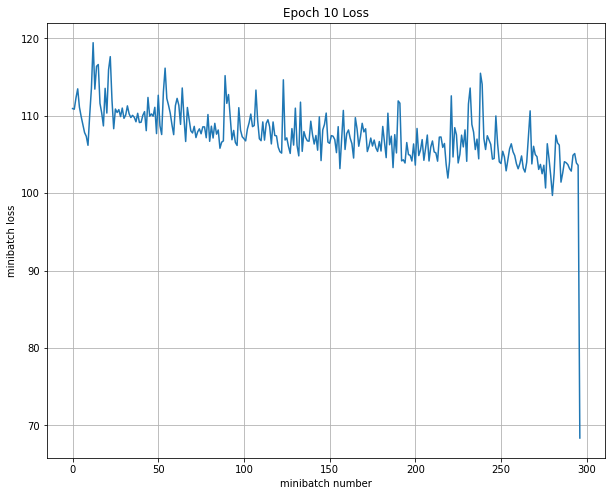

Train all layer
Iteration 0: with minibatch training loss = 17 and accuracy of 0.5
Iteration 100: with minibatch training loss = 16.8 and accuracy of 0.33
Iteration 200: with minibatch training loss = 16.2 and accuracy of 0.5
Epoch 1, Overall loss = 16.6 and accuracy of 0.306


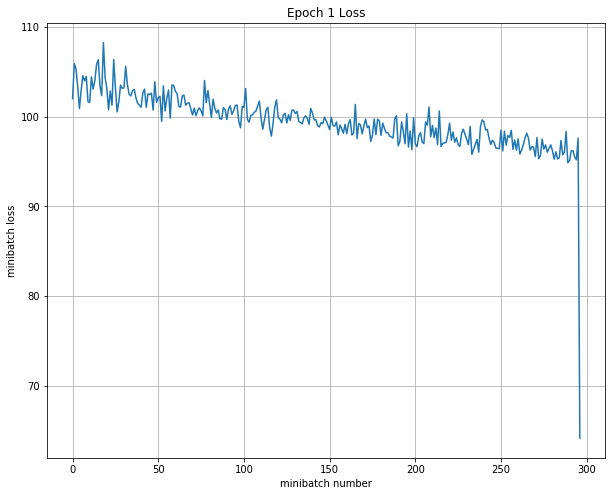

Iteration 300: with minibatch training loss = 16 and accuracy of 0.33
Iteration 400: with minibatch training loss = 15.5 and accuracy of 0.17
Iteration 500: with minibatch training loss = 15.2 and accuracy of 0.33
Epoch 2, Overall loss = 15.4 and accuracy of 0.342


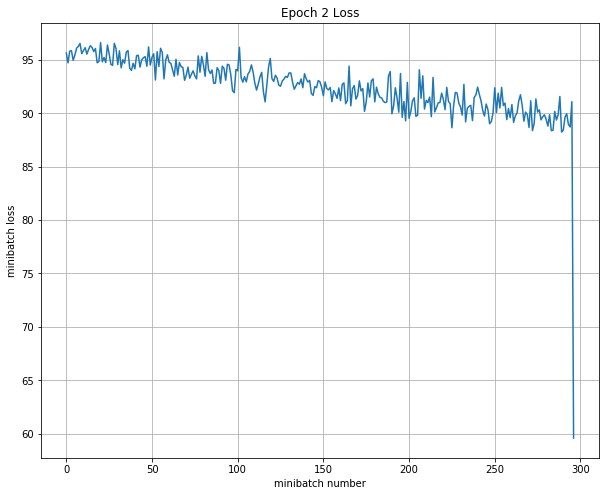

Iteration 600: with minibatch training loss = 14.9 and accuracy of 0.17
Iteration 700: with minibatch training loss = 14.4 and accuracy of 0.5
Iteration 800: with minibatch training loss = 15 and accuracy of 0.17
Epoch 3, Overall loss = 14.3 and accuracy of 0.409


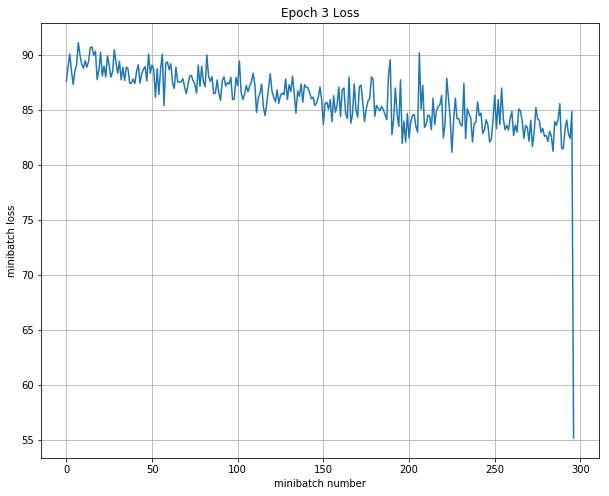

Iteration 900: with minibatch training loss = 13.7 and accuracy of 0.67
Iteration 1000: with minibatch training loss = 13.7 and accuracy of 0.17
Iteration 1100: with minibatch training loss = 12.9 and accuracy of 0.67
Epoch 4, Overall loss = 13.3 and accuracy of 0.469


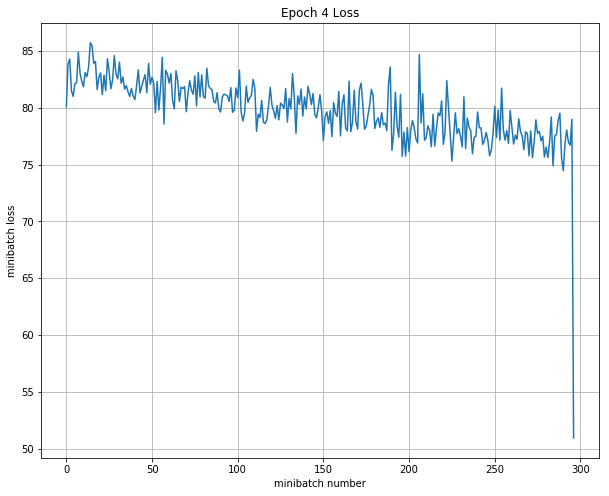

Iteration 1200: with minibatch training loss = 12.8 and accuracy of 0.5
Iteration 1300: with minibatch training loss = 12.1 and accuracy of 0.67
Iteration 1400: with minibatch training loss = 12 and accuracy of 0.67
Epoch 5, Overall loss = 12.3 and accuracy of 0.511


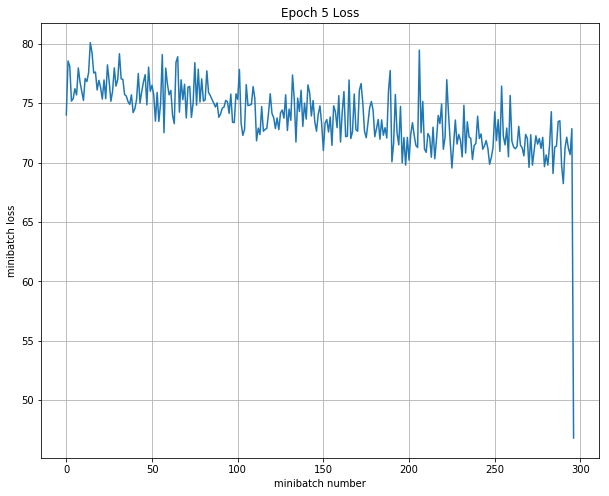

Iteration 1500: with minibatch training loss = 12.3 and accuracy of 0.5
Iteration 1600: with minibatch training loss = 11.1 and accuracy of 0.67
Iteration 1700: with minibatch training loss = 10.7 and accuracy of 1
Epoch 6, Overall loss = 11.4 and accuracy of 0.556


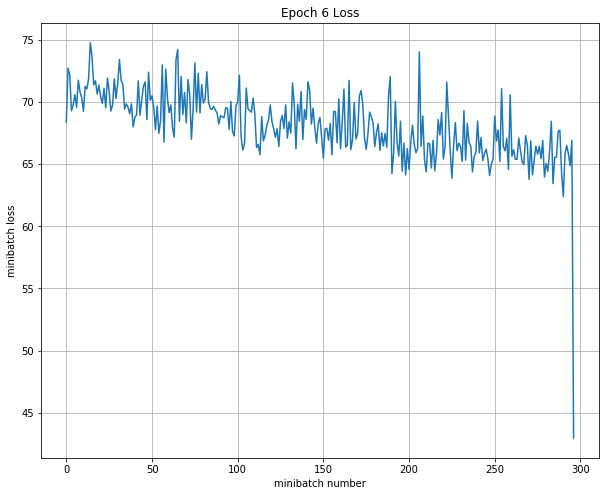

Iteration 1800: with minibatch training loss = 10.9 and accuracy of 0.67
Iteration 1900: with minibatch training loss = 10.5 and accuracy of 0.67
Iteration 2000: with minibatch training loss = 10.2 and accuracy of 0.33
Epoch 7, Overall loss = 10.5 and accuracy of 0.588


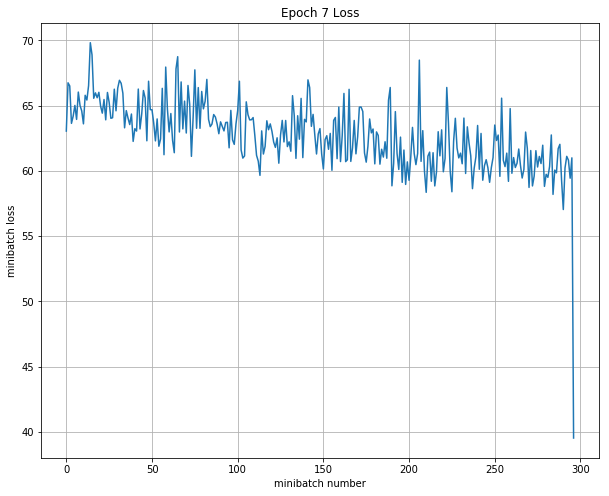

Iteration 2100: with minibatch training loss = 9.9 and accuracy of 0.5
Iteration 2200: with minibatch training loss = 9.55 and accuracy of 0.83
Iteration 2300: with minibatch training loss = 9.22 and accuracy of 0.83
Epoch 8, Overall loss = 9.57 and accuracy of 0.642


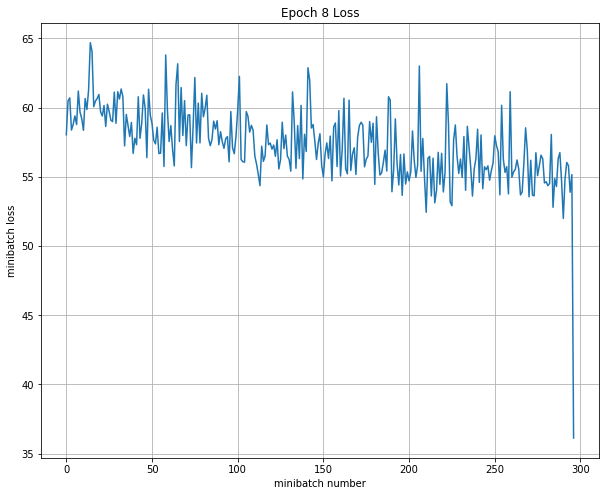

Iteration 2400: with minibatch training loss = 9.12 and accuracy of 0.5
Iteration 2500: with minibatch training loss = 8.48 and accuracy of 0.83
Iteration 2600: with minibatch training loss = 7.97 and accuracy of 1
Epoch 9, Overall loss = 8.69 and accuracy of 0.698


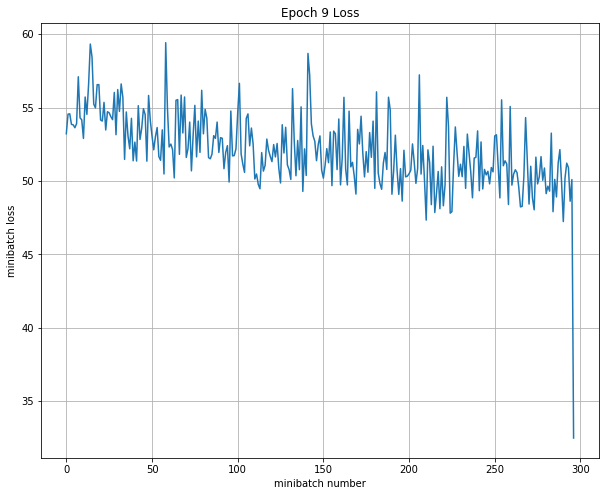

Iteration 2700: with minibatch training loss = 8.27 and accuracy of 0.5
Iteration 2800: with minibatch training loss = 7.78 and accuracy of 0.67
Iteration 2900: with minibatch training loss = 8.04 and accuracy of 0.5
Epoch 10, Overall loss = 7.87 and accuracy of 0.73


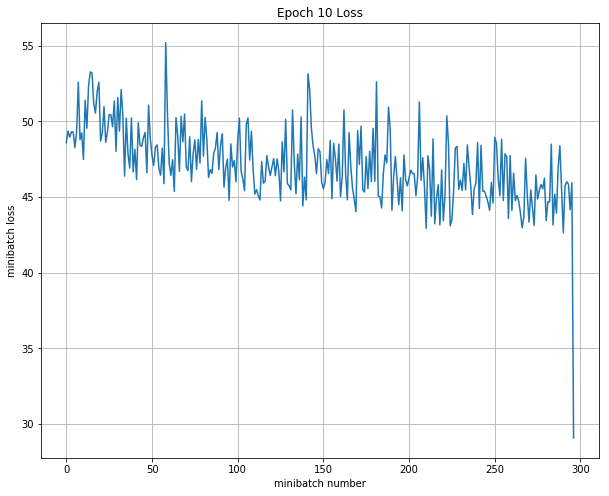

Validation
Epoch 1, Overall loss = 7.65 and accuracy of 0.7
Test
Epoch 1, Overall loss = 7.54 and accuracy of 0.78

--------------------------------------------------------------------------------
Trial number: 11
--------------------------------------------------------------------------------
reg: 0.486435, lr: 0.004598, dr: 0.962531, dc: 570, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 51.6 and accuracy of 0.17
Iteration 100: with minibatch training loss = 13.8 and accuracy of 0.17
Iteration 200: with minibatch training loss = 3.21 and accuracy of 0
Epoch 1, Overall loss = 27 and accuracy of 0.285


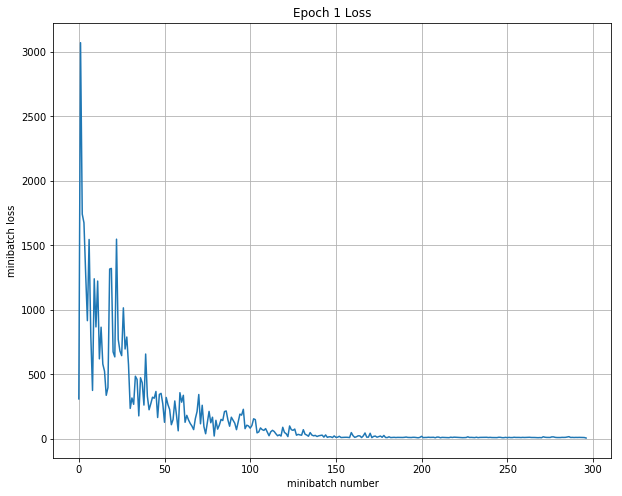

Iteration 300: with minibatch training loss = 1.9 and accuracy of 0.33
Iteration 400: with minibatch training loss = 1.77 and accuracy of 0.17
Iteration 500: with minibatch training loss = 1.62 and accuracy of 0.33
Epoch 2, Overall loss = 1.66 and accuracy of 0.331


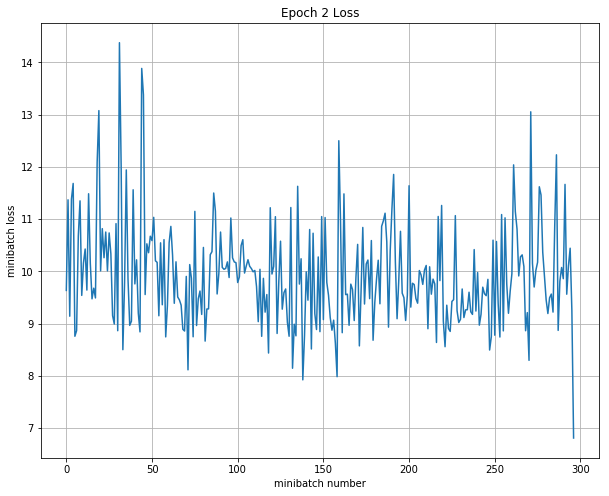

Iteration 600: with minibatch training loss = 1.48 and accuracy of 0.5
Iteration 700: with minibatch training loss = 1.67 and accuracy of 0.33
Iteration 800: with minibatch training loss = 1.61 and accuracy of 0.33
Epoch 3, Overall loss = 1.56 and accuracy of 0.342


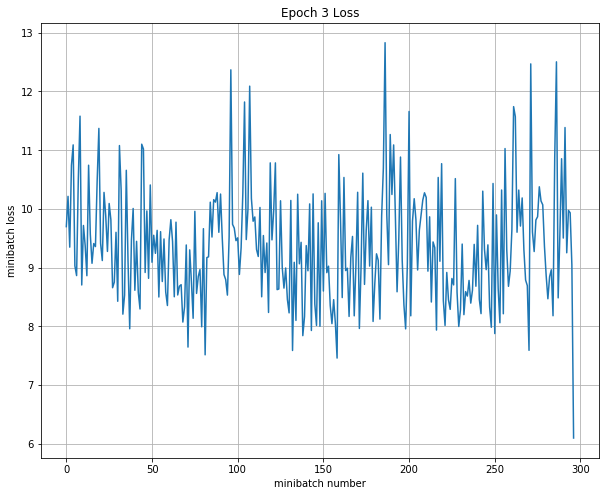

Iteration 900: with minibatch training loss = 1.44 and accuracy of 0.5
Iteration 1000: with minibatch training loss = 1.62 and accuracy of 0.33
Iteration 1100: with minibatch training loss = 1.66 and accuracy of 0.17
Epoch 4, Overall loss = 1.5 and accuracy of 0.335


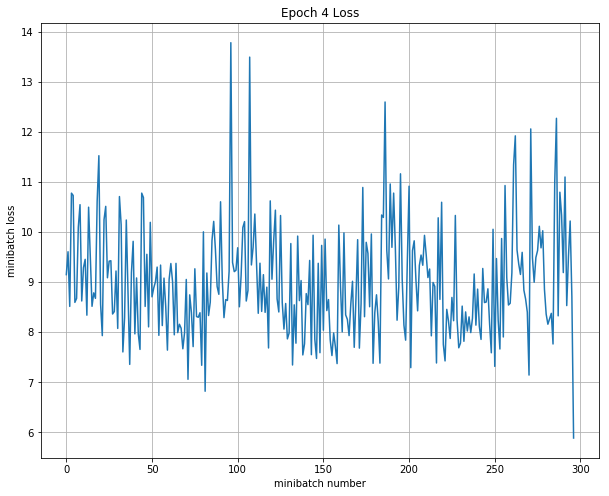

Iteration 1200: with minibatch training loss = 1.44 and accuracy of 0.17
Iteration 1300: with minibatch training loss = 1.47 and accuracy of 0.17
Iteration 1400: with minibatch training loss = 1.77 and accuracy of 0.33
Epoch 5, Overall loss = 1.65 and accuracy of 0.331


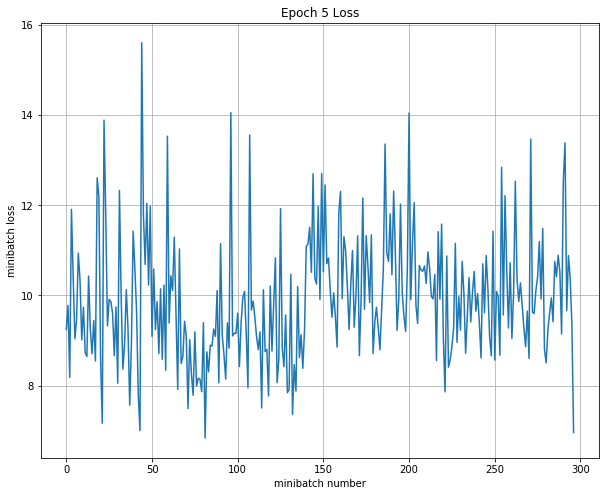

Iteration 1500: with minibatch training loss = 1.66 and accuracy of 0.17
Iteration 1600: with minibatch training loss = 2.21 and accuracy of 0.33
Iteration 1700: with minibatch training loss = 3.39 and accuracy of 0.33
Epoch 6, Overall loss = 2.08 and accuracy of 0.289


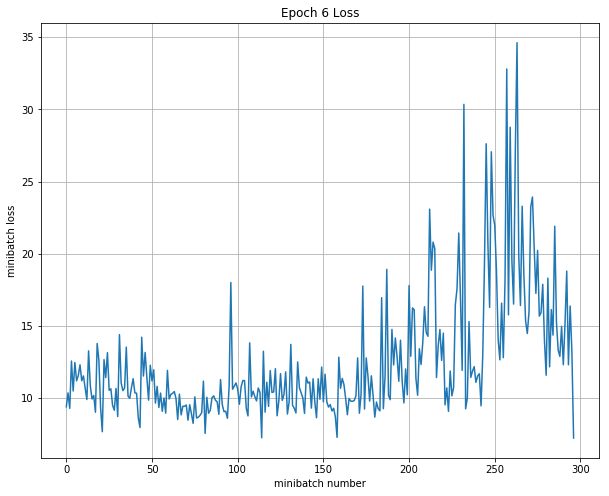

Iteration 1800: with minibatch training loss = 2.54 and accuracy of 0.17
Iteration 1900: with minibatch training loss = 1.51 and accuracy of 0.67
Iteration 2000: with minibatch training loss = 2.83 and accuracy of 0.17
Epoch 7, Overall loss = 1.88 and accuracy of 0.312


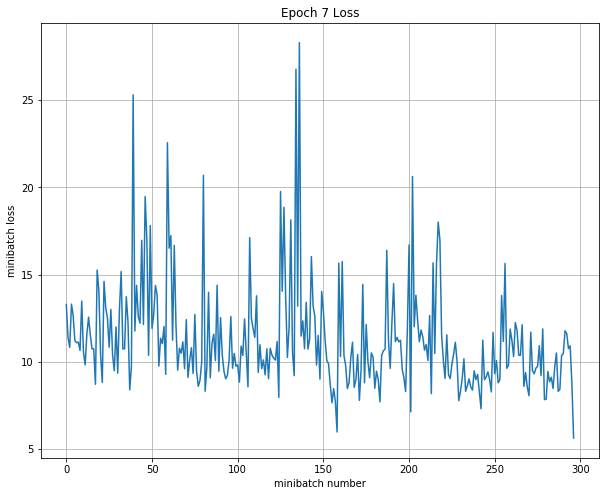

Iteration 2100: with minibatch training loss = 1.47 and accuracy of 0.67
Iteration 2200: with minibatch training loss = 2.54 and accuracy of 0
Iteration 2300: with minibatch training loss = 15.5 and accuracy of 0.67
Epoch 8, Overall loss = 13.2 and accuracy of 0.282


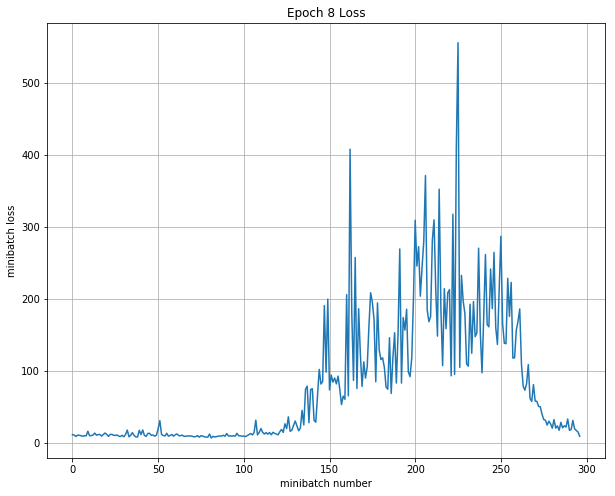

Iteration 2400: with minibatch training loss = 1.61 and accuracy of 0.5
Iteration 2500: with minibatch training loss = 1.74 and accuracy of 0
Iteration 2600: with minibatch training loss = 1.3 and accuracy of 0.5
Epoch 9, Overall loss = 1.6 and accuracy of 0.331


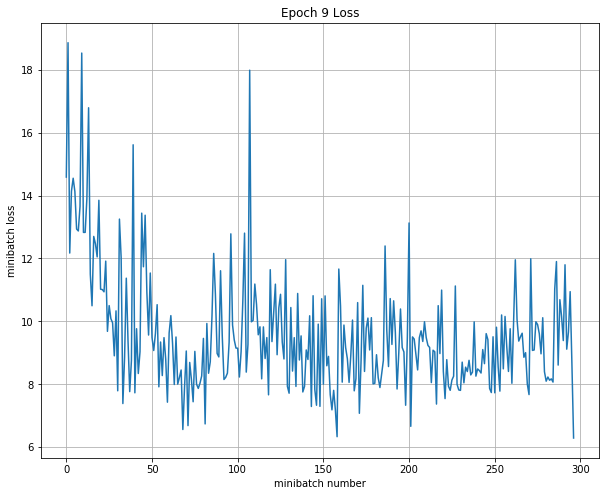

Iteration 2700: with minibatch training loss = 1.72 and accuracy of 0.33
Iteration 2800: with minibatch training loss = 1.4 and accuracy of 0.5
Iteration 2900: with minibatch training loss = 1.65 and accuracy of 0.17
Epoch 10, Overall loss = 1.54 and accuracy of 0.339


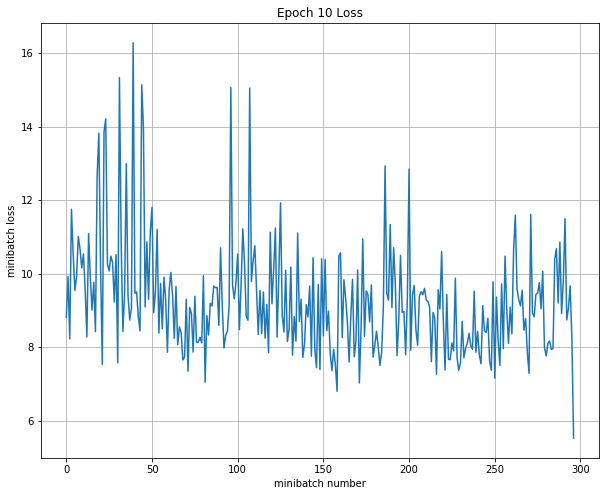

Train all layer
Iteration 0: with minibatch training loss = 1.7 and accuracy of 0.5
Iteration 100: with minibatch training loss = 13.1 and accuracy of 0.5
Iteration 200: with minibatch training loss = 3.51 and accuracy of 0.5
Epoch 1, Overall loss = 469 and accuracy of 0.329


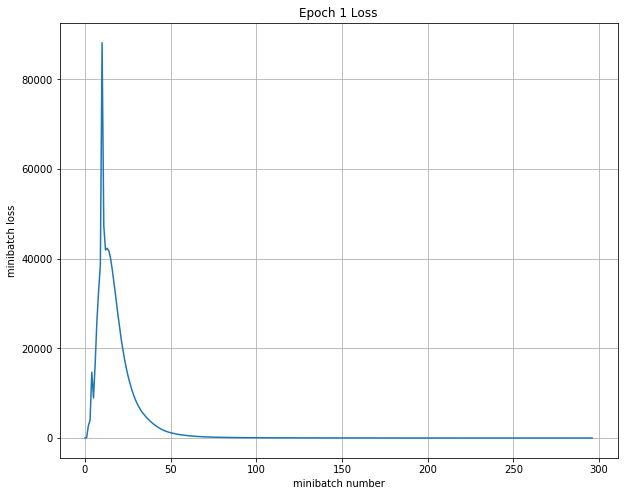

Iteration 300: with minibatch training loss = 2.87 and accuracy of 0.33
Iteration 400: with minibatch training loss = 2.61 and accuracy of 0.5
Iteration 500: with minibatch training loss = 2.78 and accuracy of 0.17
Epoch 2, Overall loss = 2.73 and accuracy of 0.337


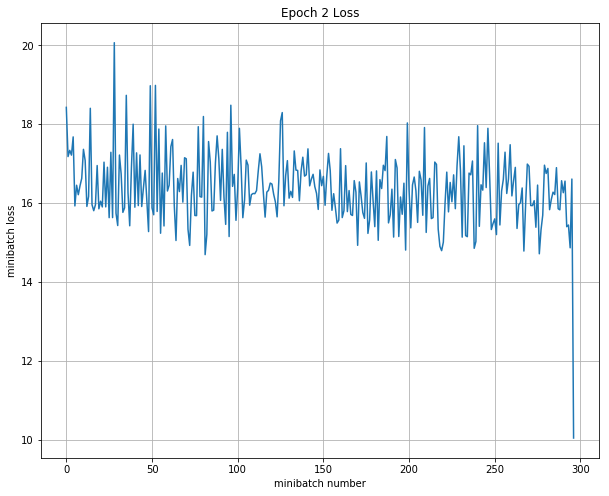

Iteration 600: with minibatch training loss = 2.61 and accuracy of 0.17
Iteration 700: with minibatch training loss = 2.75 and accuracy of 0.17
Iteration 800: with minibatch training loss = 2.72 and accuracy of 0.17
Epoch 3, Overall loss = 2.64 and accuracy of 0.338


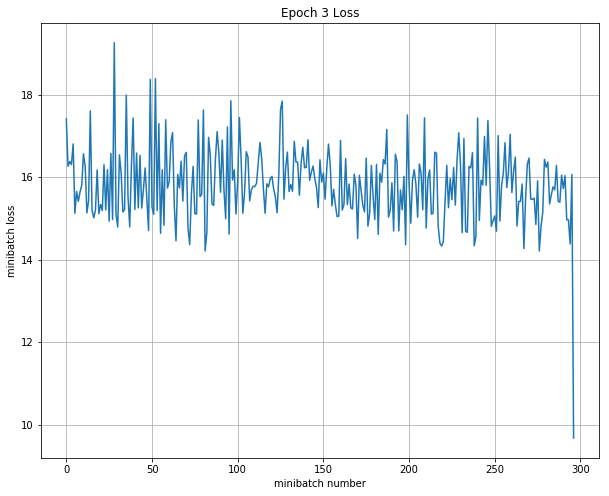

Iteration 900: with minibatch training loss = 2.56 and accuracy of 0.33
Iteration 1000: with minibatch training loss = 2.53 and accuracy of 0.5
Iteration 1100: with minibatch training loss = 2.82 and accuracy of 0
Epoch 4, Overall loss = 2.55 and accuracy of 0.337


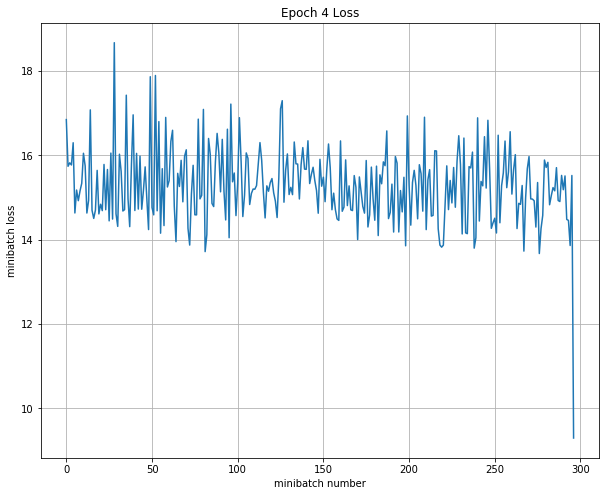

Iteration 1200: with minibatch training loss = 2.35 and accuracy of 0.5
Iteration 1300: with minibatch training loss = 2.55 and accuracy of 0.17
Iteration 1400: with minibatch training loss = 2.53 and accuracy of 0
Epoch 5, Overall loss = 2.47 and accuracy of 0.338


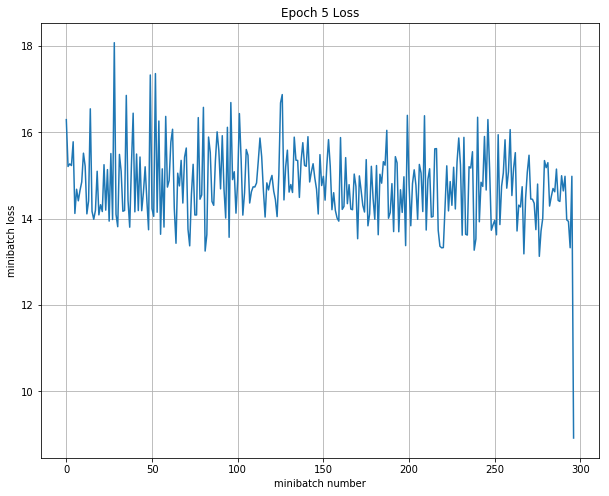

Iteration 1500: with minibatch training loss = 2.27 and accuracy of 0.33
Iteration 1600: with minibatch training loss = 2.34 and accuracy of 0.17
Iteration 1700: with minibatch training loss = 2.51 and accuracy of 0.33
Epoch 6, Overall loss = 2.37 and accuracy of 0.334


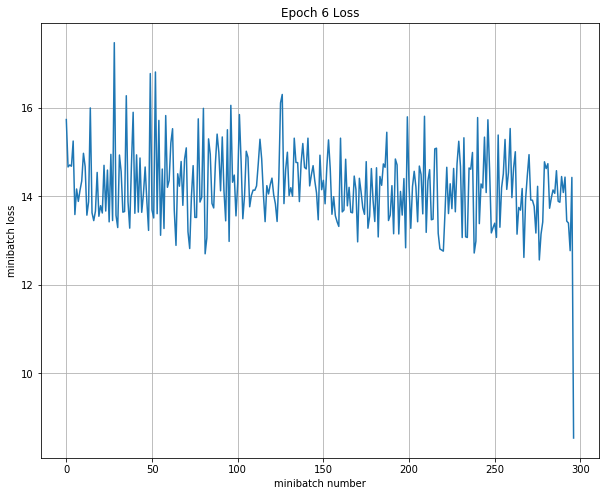

Iteration 1800: with minibatch training loss = 2.33 and accuracy of 0.67
Iteration 1900: with minibatch training loss = 2.26 and accuracy of 0.33
Iteration 2000: with minibatch training loss = 2.05 and accuracy of 0.5
Epoch 7, Overall loss = 2.28 and accuracy of 0.334


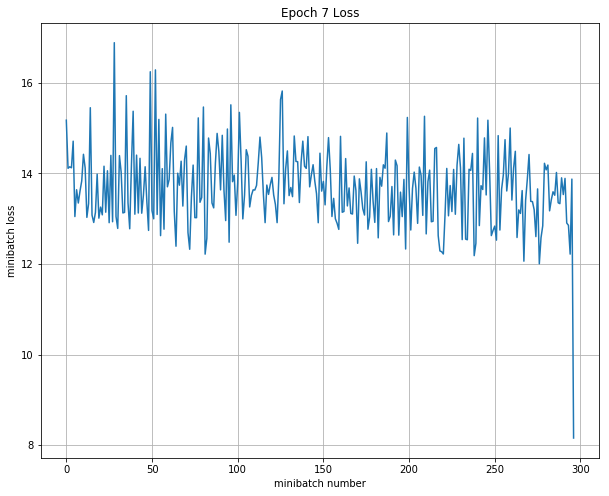

Iteration 2100: with minibatch training loss = 2.09 and accuracy of 0.33
Iteration 2200: with minibatch training loss = 2.15 and accuracy of 0.17
Iteration 2300: with minibatch training loss = 2.09 and accuracy of 0.17
Epoch 8, Overall loss = 2.19 and accuracy of 0.338


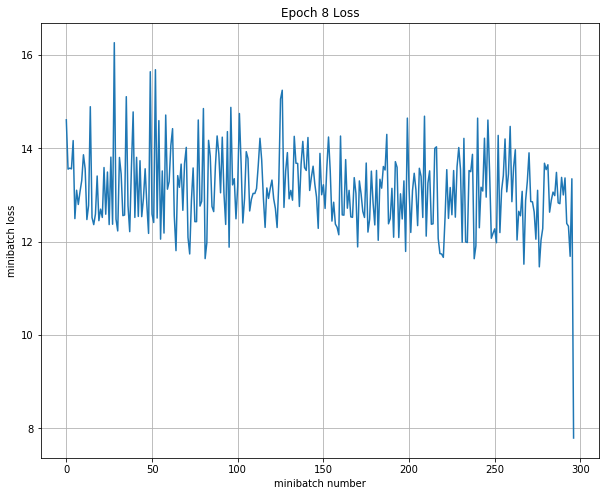

Iteration 2400: with minibatch training loss = 2.16 and accuracy of 0.67
Iteration 2500: with minibatch training loss = 2.13 and accuracy of 0
Iteration 2600: with minibatch training loss = 2.1 and accuracy of 0
Epoch 9, Overall loss = 2.1 and accuracy of 0.339


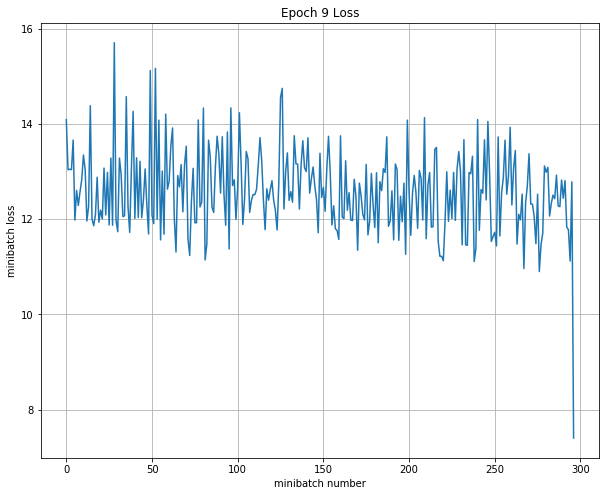

Iteration 2700: with minibatch training loss = 1.88 and accuracy of 0.5
Iteration 2800: with minibatch training loss = 1.94 and accuracy of 0.67
Iteration 2900: with minibatch training loss = 1.91 and accuracy of 0.33
Epoch 10, Overall loss = 2.01 and accuracy of 0.342


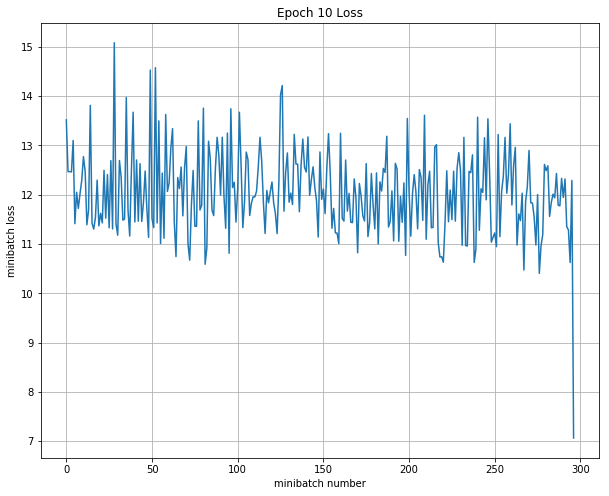

Validation
Epoch 1, Overall loss = 1.98 and accuracy of 0.3
Test
Epoch 1, Overall loss = 1.98 and accuracy of 0.36

--------------------------------------------------------------------------------
Trial number: 12
--------------------------------------------------------------------------------
reg: 0.003865, lr: 0.000003, dr: 0.970914, dc: 911, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 1.85 and accuracy of 0.17
Iteration 100: with minibatch training loss = 1.82 and accuracy of 0.33
Iteration 200: with minibatch training loss = 1.52 and accuracy of 0.67
Epoch 1, Overall loss = 1.69 and accuracy of 0.349


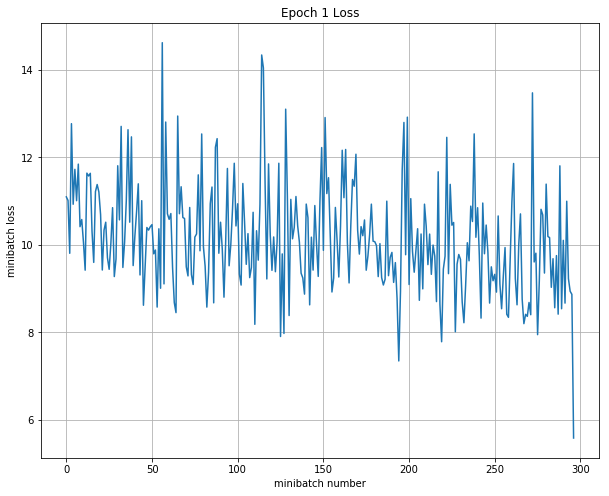

Iteration 300: with minibatch training loss = 1.47 and accuracy of 0.33
Iteration 400: with minibatch training loss = 1.76 and accuracy of 0
Iteration 500: with minibatch training loss = 1.38 and accuracy of 0.33
Epoch 2, Overall loss = 1.56 and accuracy of 0.408


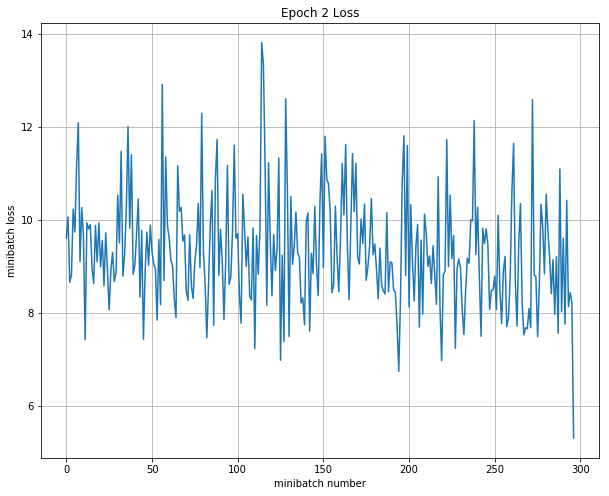

Iteration 600: with minibatch training loss = 1.71 and accuracy of 0.17
Iteration 700: with minibatch training loss = 1.53 and accuracy of 0.33
Iteration 800: with minibatch training loss = 1.16 and accuracy of 0.67
Epoch 3, Overall loss = 1.47 and accuracy of 0.444


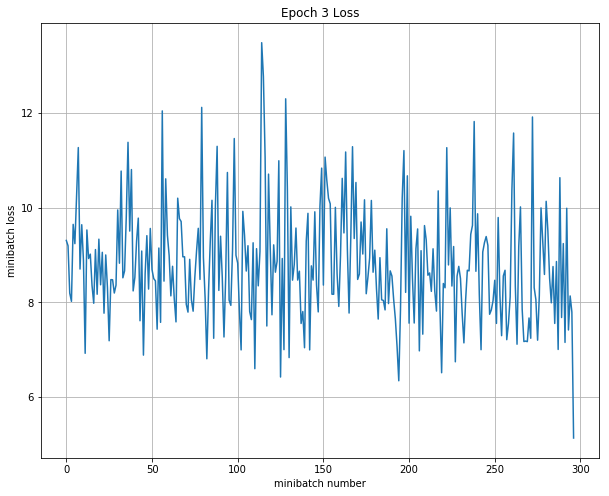

Iteration 900: with minibatch training loss = 1.53 and accuracy of 0.33
Iteration 1000: with minibatch training loss = 1.48 and accuracy of 0.17
Iteration 1100: with minibatch training loss = 1.55 and accuracy of 0.33
Epoch 4, Overall loss = 1.41 and accuracy of 0.476


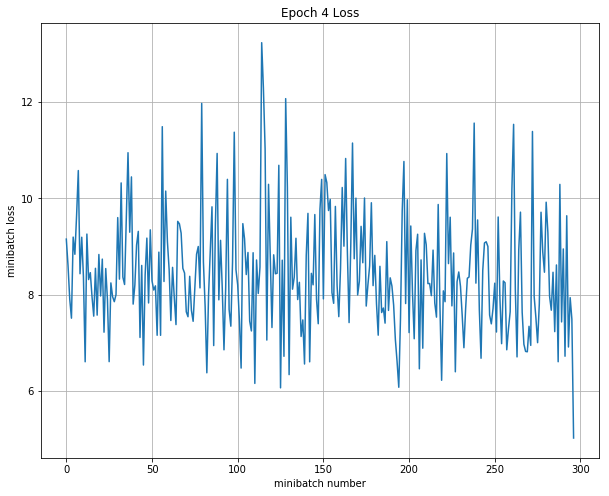

Iteration 1200: with minibatch training loss = 1.51 and accuracy of 0.17
Iteration 1300: with minibatch training loss = 1.3 and accuracy of 0.5
Iteration 1400: with minibatch training loss = 1.33 and accuracy of 0.5
Epoch 5, Overall loss = 1.36 and accuracy of 0.501


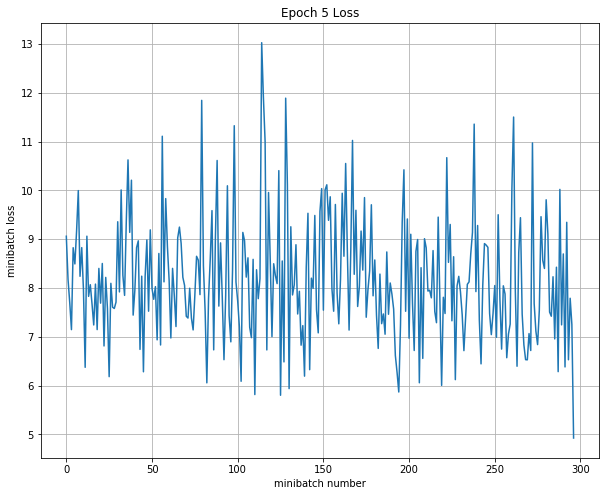

Iteration 1500: with minibatch training loss = 1.24 and accuracy of 0.5
Iteration 1600: with minibatch training loss = 1.93 and accuracy of 0
Iteration 1700: with minibatch training loss = 1.21 and accuracy of 0.5
Epoch 6, Overall loss = 1.33 and accuracy of 0.527


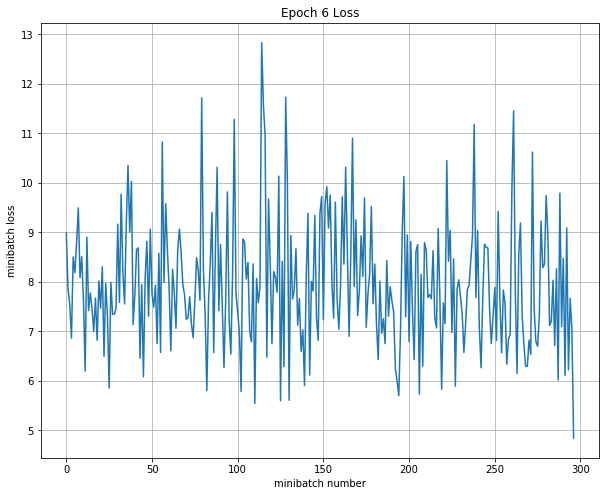

Iteration 1800: with minibatch training loss = 1.09 and accuracy of 0.67
Iteration 1900: with minibatch training loss = 1.57 and accuracy of 0.33
Iteration 2000: with minibatch training loss = 1.27 and accuracy of 0.67
Epoch 7, Overall loss = 1.29 and accuracy of 0.552


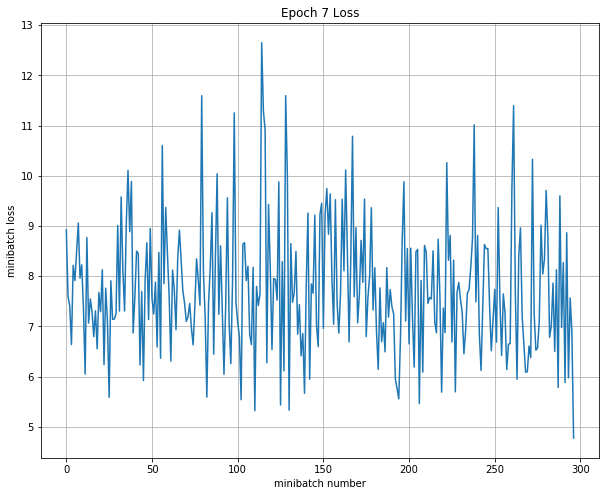

Iteration 2100: with minibatch training loss = 1.33 and accuracy of 0.5
Iteration 2200: with minibatch training loss = 1.29 and accuracy of 0.33
Iteration 2300: with minibatch training loss = 1.1 and accuracy of 0.67
Epoch 8, Overall loss = 1.26 and accuracy of 0.566


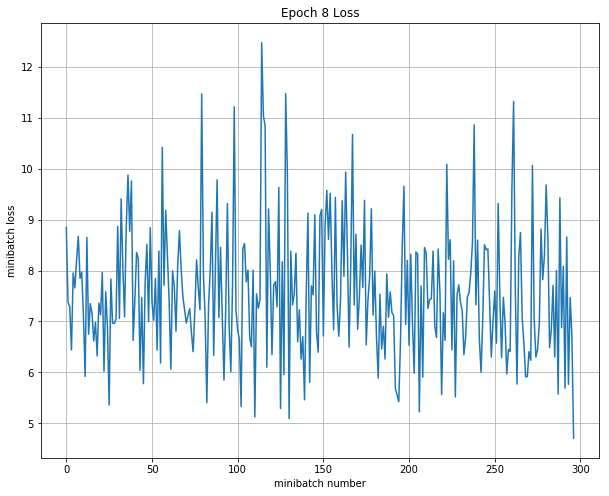

Iteration 2400: with minibatch training loss = 1.12 and accuracy of 0.83
Iteration 2500: with minibatch training loss = 1.57 and accuracy of 0.17
Iteration 2600: with minibatch training loss = 1.4 and accuracy of 0.33
Epoch 9, Overall loss = 1.24 and accuracy of 0.579


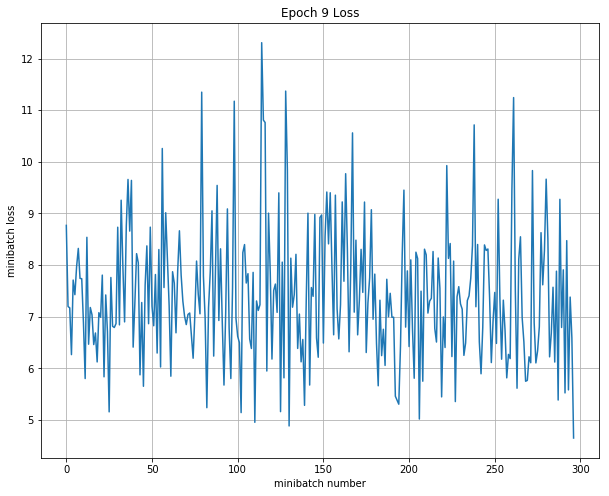

Iteration 2700: with minibatch training loss = 1.11 and accuracy of 0.67
Iteration 2800: with minibatch training loss = 0.948 and accuracy of 0.67
Iteration 2900: with minibatch training loss = 0.869 and accuracy of 0.83
Epoch 10, Overall loss = 1.21 and accuracy of 0.597


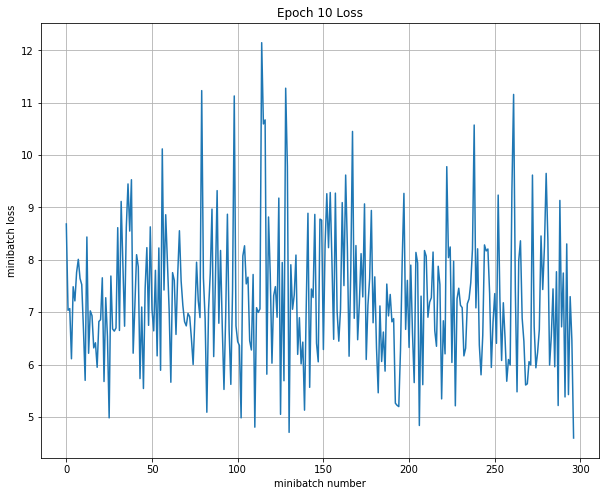

Train all layer
Iteration 0: with minibatch training loss = 0.956 and accuracy of 0.83
Iteration 100: with minibatch training loss = 1.06 and accuracy of 0.67
Iteration 200: with minibatch training loss = 1.31 and accuracy of 0.5
Epoch 1, Overall loss = 1.11 and accuracy of 0.648


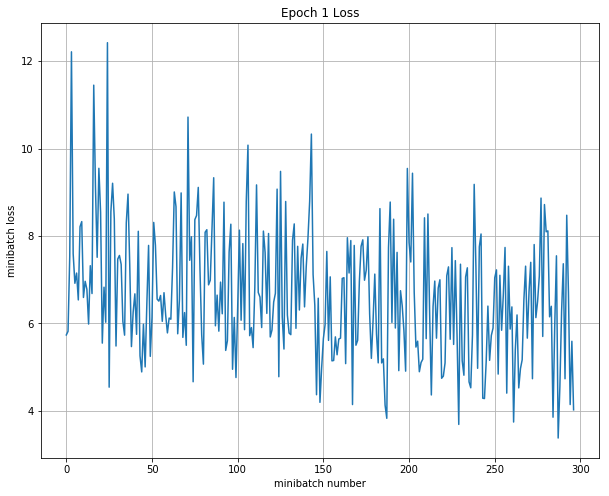

Iteration 300: with minibatch training loss = 1.43 and accuracy of 0.33
Iteration 400: with minibatch training loss = 1.24 and accuracy of 0.67
Iteration 500: with minibatch training loss = 1.01 and accuracy of 0.83
Epoch 2, Overall loss = 0.996 and accuracy of 0.716


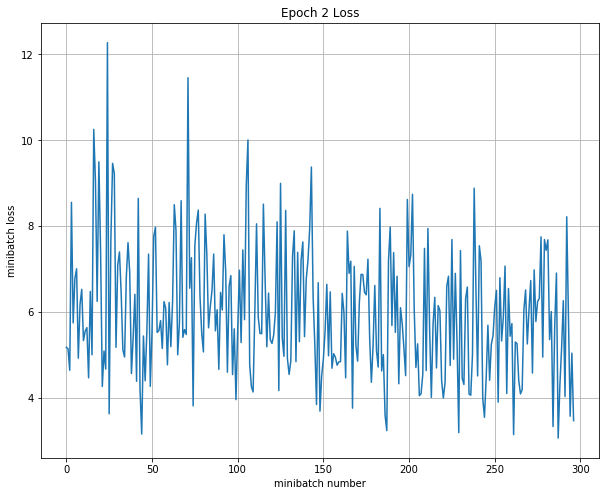

Iteration 600: with minibatch training loss = 1.08 and accuracy of 0.67
Iteration 700: with minibatch training loss = 1.53 and accuracy of 0.17
Iteration 800: with minibatch training loss = 0.564 and accuracy of 1
Epoch 3, Overall loss = 0.898 and accuracy of 0.761


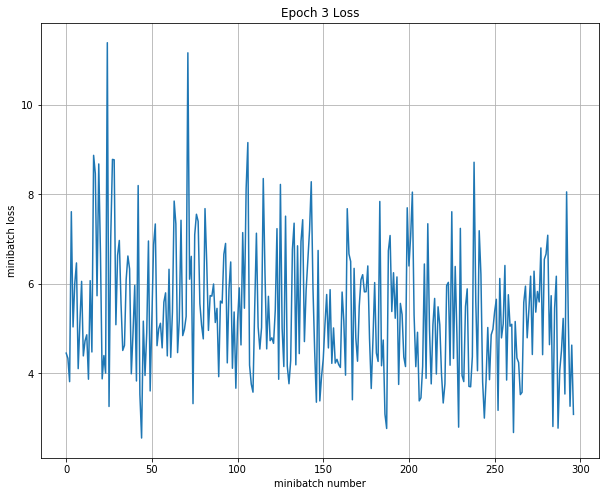

Iteration 900: with minibatch training loss = 0.936 and accuracy of 0.67
Iteration 1000: with minibatch training loss = 0.547 and accuracy of 0.83
Iteration 1100: with minibatch training loss = 0.915 and accuracy of 0.83
Epoch 4, Overall loss = 0.806 and accuracy of 0.797


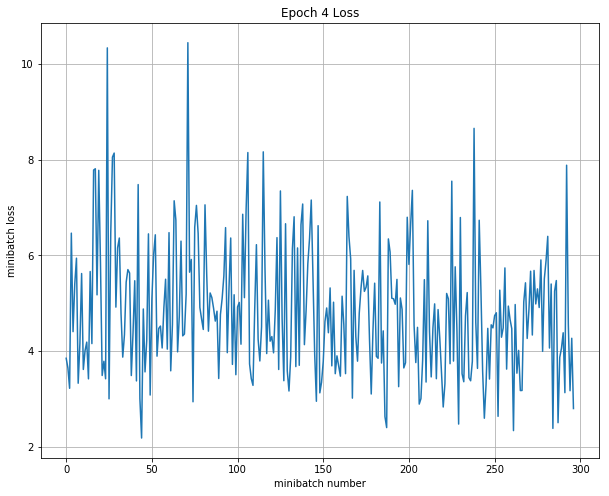

Iteration 1200: with minibatch training loss = 0.607 and accuracy of 1
Iteration 1300: with minibatch training loss = 0.589 and accuracy of 1
Iteration 1400: with minibatch training loss = 0.642 and accuracy of 1
Epoch 5, Overall loss = 0.721 and accuracy of 0.835


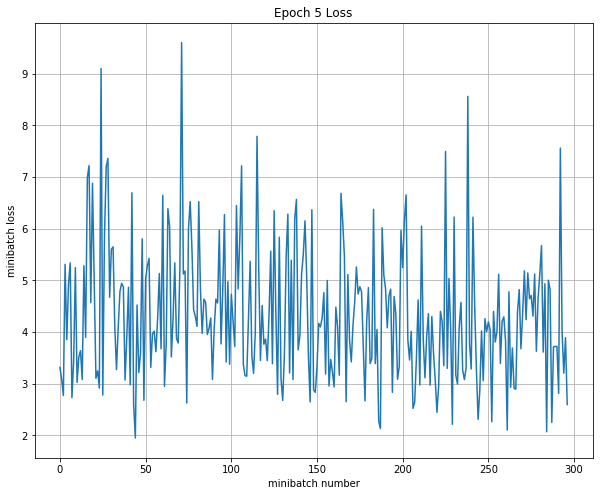

Iteration 1500: with minibatch training loss = 0.606 and accuracy of 0.83
Iteration 1600: with minibatch training loss = 1.19 and accuracy of 0.5
Iteration 1700: with minibatch training loss = 0.633 and accuracy of 0.83
Epoch 6, Overall loss = 0.646 and accuracy of 0.868


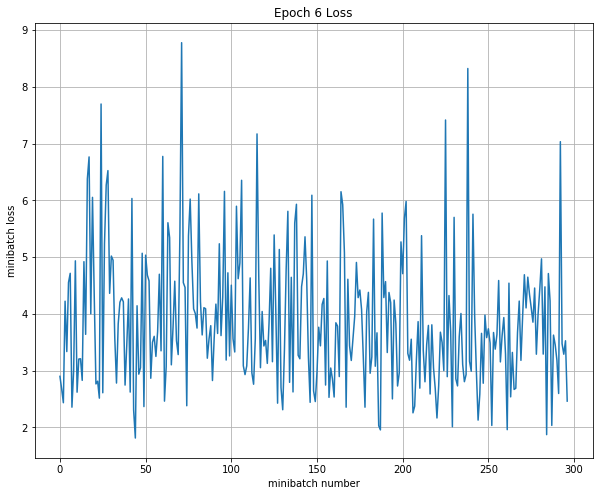

Iteration 1800: with minibatch training loss = 0.577 and accuracy of 1
Iteration 1900: with minibatch training loss = 0.609 and accuracy of 1
Iteration 2000: with minibatch training loss = 0.436 and accuracy of 1
Epoch 7, Overall loss = 0.582 and accuracy of 0.9


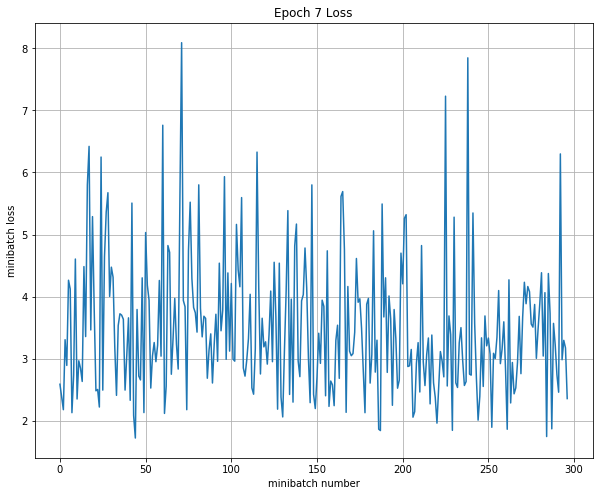

Iteration 2100: with minibatch training loss = 0.375 and accuracy of 1
Iteration 2200: with minibatch training loss = 0.459 and accuracy of 1
Iteration 2300: with minibatch training loss = 0.398 and accuracy of 1
Epoch 8, Overall loss = 0.527 and accuracy of 0.922


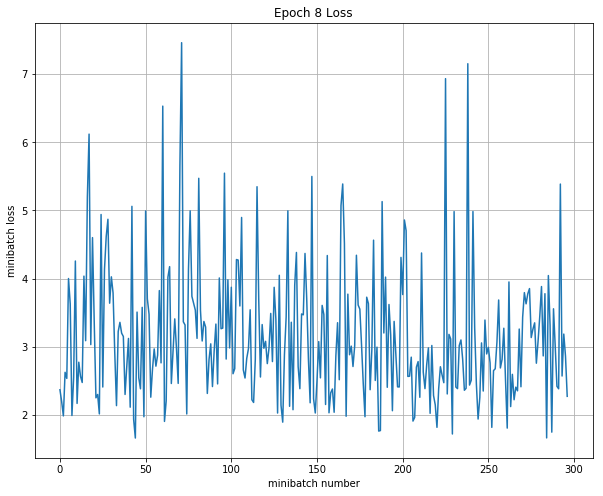

Iteration 2400: with minibatch training loss = 0.651 and accuracy of 0.83
Iteration 2500: with minibatch training loss = 0.441 and accuracy of 1
Iteration 2600: with minibatch training loss = 0.381 and accuracy of 1
Epoch 9, Overall loss = 0.479 and accuracy of 0.939


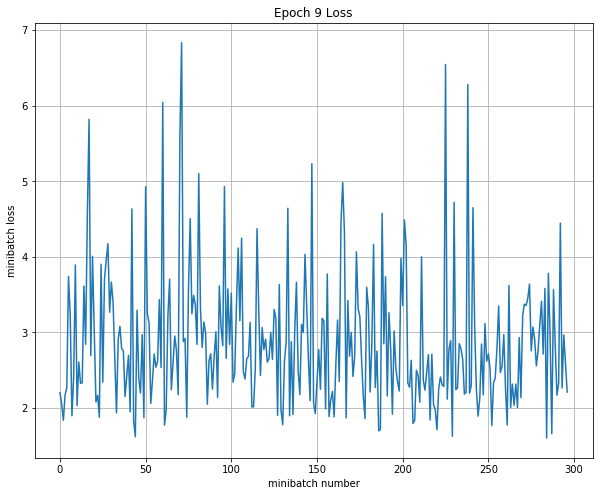

Iteration 2700: with minibatch training loss = 0.568 and accuracy of 0.83
Iteration 2800: with minibatch training loss = 0.3 and accuracy of 1
Iteration 2900: with minibatch training loss = 0.41 and accuracy of 1
Epoch 10, Overall loss = 0.438 and accuracy of 0.956


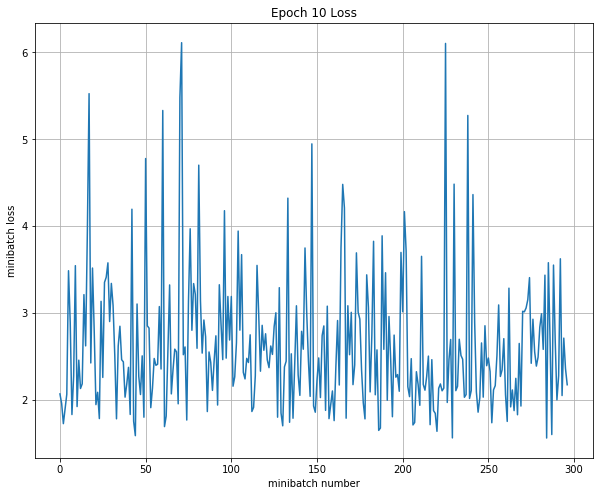

Validation
Epoch 1, Overall loss = 0.533 and accuracy of 0.94
Test
Epoch 1, Overall loss = 0.526 and accuracy of 0.92

--------------------------------------------------------------------------------
Trial number: 13
--------------------------------------------------------------------------------
reg: 0.027082, lr: 0.000042, dr: 0.891485, dc: 986, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 4.47 and accuracy of 0.17
Iteration 100: with minibatch training loss = 3.05 and accuracy of 0
Iteration 200: with minibatch training loss = 3.17 and accuracy of 0.33
Epoch 1, Overall loss = 3.2 and accuracy of 0.327


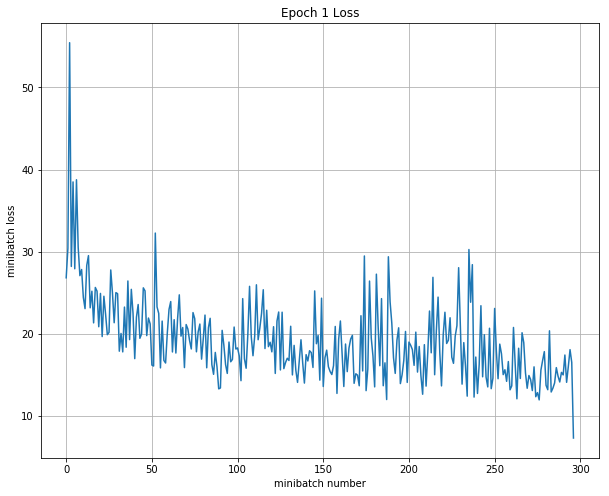

Iteration 300: with minibatch training loss = 2.96 and accuracy of 0
Iteration 400: with minibatch training loss = 3.28 and accuracy of 0
Iteration 500: with minibatch training loss = 2.52 and accuracy of 0.5
Epoch 2, Overall loss = 2.62 and accuracy of 0.389


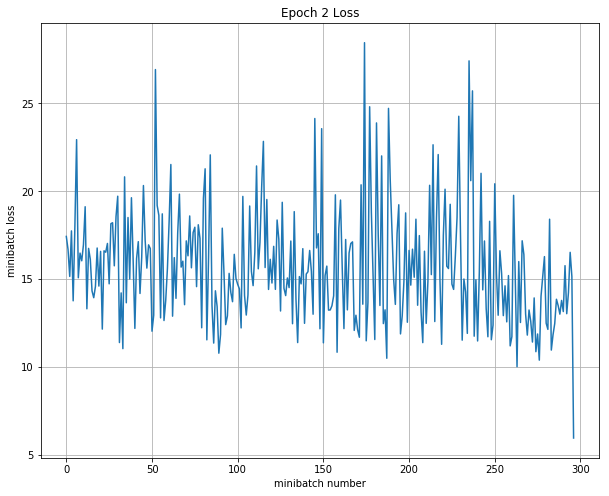

Iteration 600: with minibatch training loss = 3.77 and accuracy of 0.17
Iteration 700: with minibatch training loss = 2.02 and accuracy of 0.33
Iteration 800: with minibatch training loss = 2.71 and accuracy of 0.33
Epoch 3, Overall loss = 2.38 and accuracy of 0.42


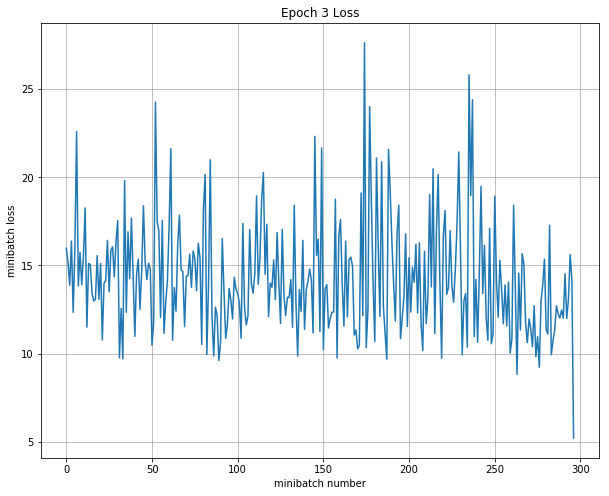

Iteration 900: with minibatch training loss = 2.1 and accuracy of 0.17
Iteration 1000: with minibatch training loss = 2.09 and accuracy of 0.5
Iteration 1100: with minibatch training loss = 2.55 and accuracy of 0.5
Epoch 4, Overall loss = 2.21 and accuracy of 0.436


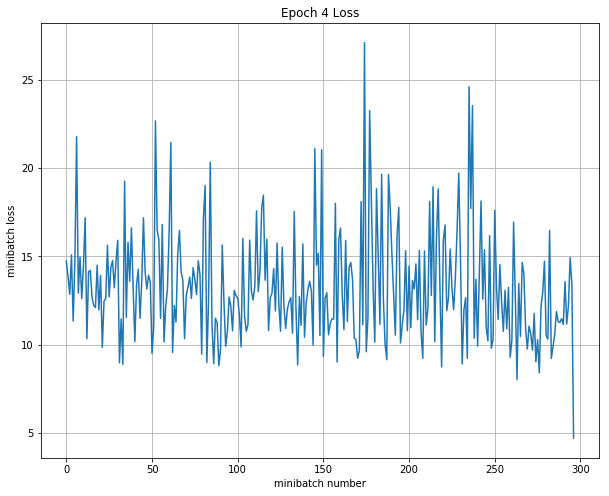

Iteration 1200: with minibatch training loss = 1.59 and accuracy of 0.83
Iteration 1300: with minibatch training loss = 2.07 and accuracy of 0.33
Iteration 1400: with minibatch training loss = 2.9 and accuracy of 0.5
Epoch 5, Overall loss = 2.09 and accuracy of 0.453


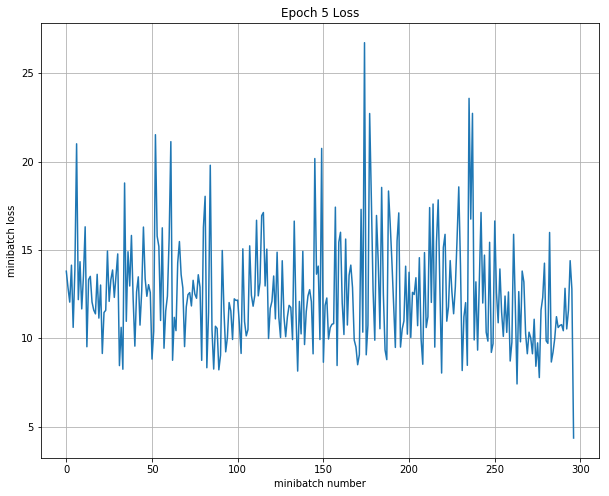

Iteration 1500: with minibatch training loss = 1.92 and accuracy of 0.5
Iteration 1600: with minibatch training loss = 2.67 and accuracy of 0.5
Iteration 1700: with minibatch training loss = 1.5 and accuracy of 0.67
Epoch 6, Overall loss = 1.99 and accuracy of 0.466


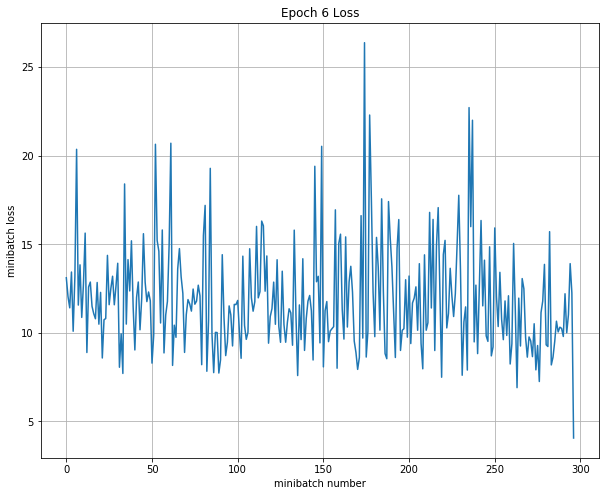

Iteration 1800: with minibatch training loss = 2.03 and accuracy of 0.17
Iteration 1900: with minibatch training loss = 1.5 and accuracy of 0.83
Iteration 2000: with minibatch training loss = 1.94 and accuracy of 0.17
Epoch 7, Overall loss = 1.9 and accuracy of 0.474


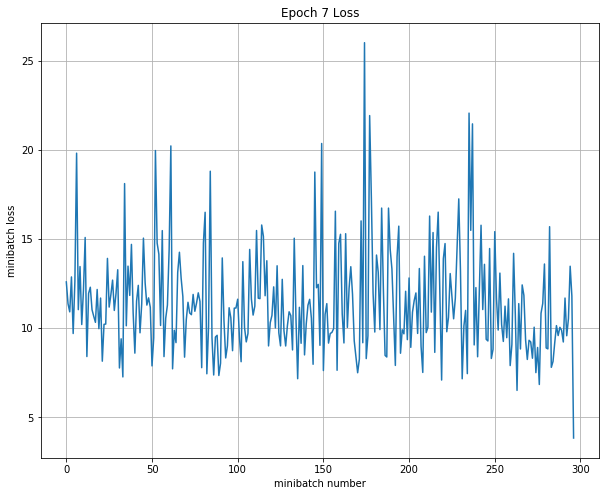

Iteration 2100: with minibatch training loss = 1.3 and accuracy of 0.83
Iteration 2200: with minibatch training loss = 1.98 and accuracy of 0.17
Iteration 2300: with minibatch training loss = 2.4 and accuracy of 0.33
Epoch 8, Overall loss = 1.84 and accuracy of 0.483


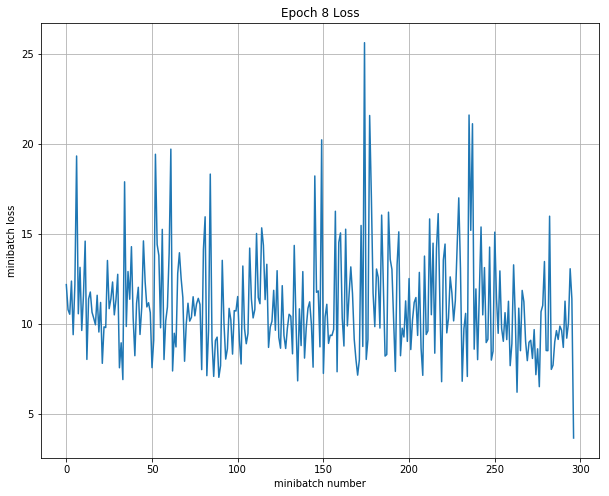

Iteration 2400: with minibatch training loss = 2.19 and accuracy of 0
Iteration 2500: with minibatch training loss = 1.47 and accuracy of 0.83
Iteration 2600: with minibatch training loss = 2.04 and accuracy of 0.17
Epoch 9, Overall loss = 1.78 and accuracy of 0.486


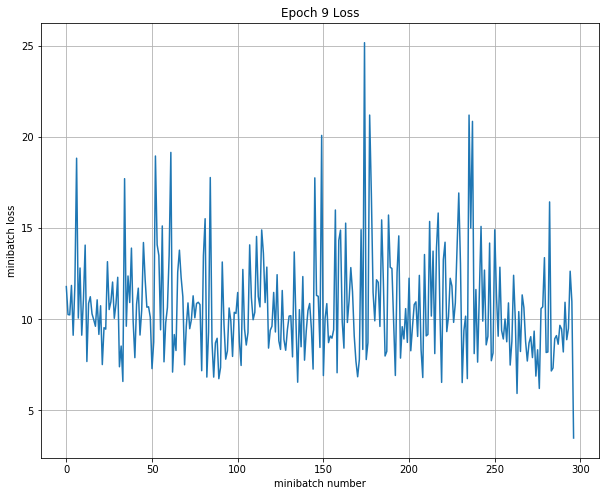

Iteration 2700: with minibatch training loss = 1.98 and accuracy of 0.5
Iteration 2800: with minibatch training loss = 1.42 and accuracy of 0.83
Iteration 2900: with minibatch training loss = 1.75 and accuracy of 0.5
Epoch 10, Overall loss = 1.74 and accuracy of 0.492


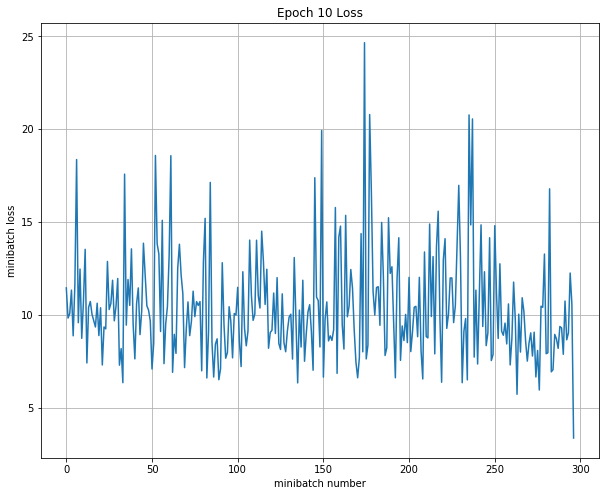

Train all layer
Iteration 0: with minibatch training loss = 2.38 and accuracy of 0.17
Iteration 100: with minibatch training loss = 1.23 and accuracy of 0.67
Iteration 200: with minibatch training loss = 1.07 and accuracy of 0.83
Epoch 1, Overall loss = 1.42 and accuracy of 0.633


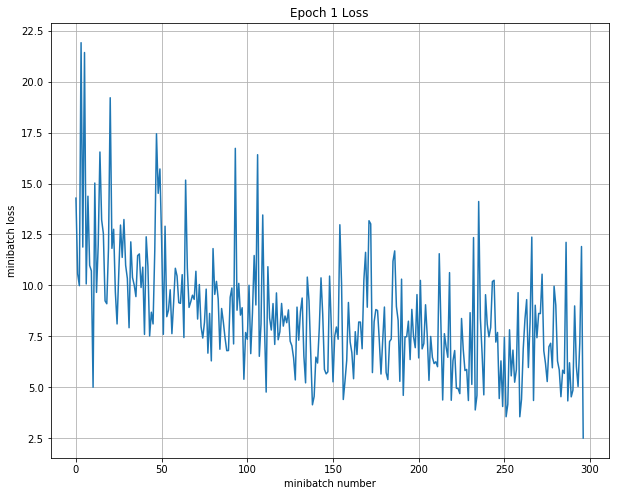

Iteration 300: with minibatch training loss = 0.982 and accuracy of 0.83
Iteration 400: with minibatch training loss = 0.875 and accuracy of 0.83
Iteration 500: with minibatch training loss = 1.26 and accuracy of 0.5
Epoch 2, Overall loss = 0.916 and accuracy of 0.838


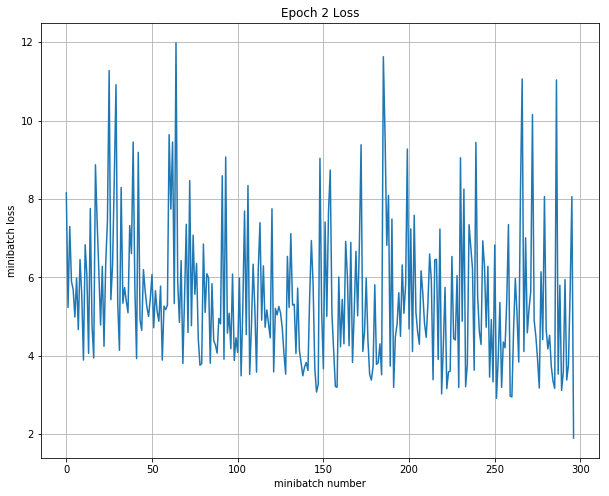

Iteration 600: with minibatch training loss = 0.684 and accuracy of 0.83
Iteration 700: with minibatch training loss = 0.987 and accuracy of 0.67
Iteration 800: with minibatch training loss = 0.59 and accuracy of 1
Epoch 3, Overall loss = 0.691 and accuracy of 0.907


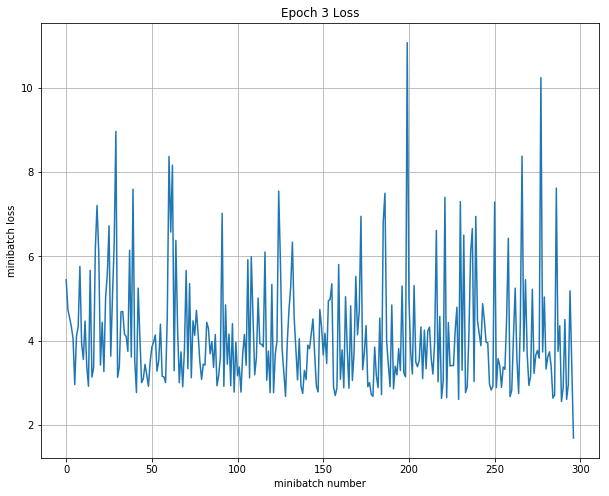

Iteration 900: with minibatch training loss = 0.531 and accuracy of 1
Iteration 1000: with minibatch training loss = 0.66 and accuracy of 0.83
Iteration 1100: with minibatch training loss = 0.587 and accuracy of 0.83
Epoch 4, Overall loss = 0.553 and accuracy of 0.949


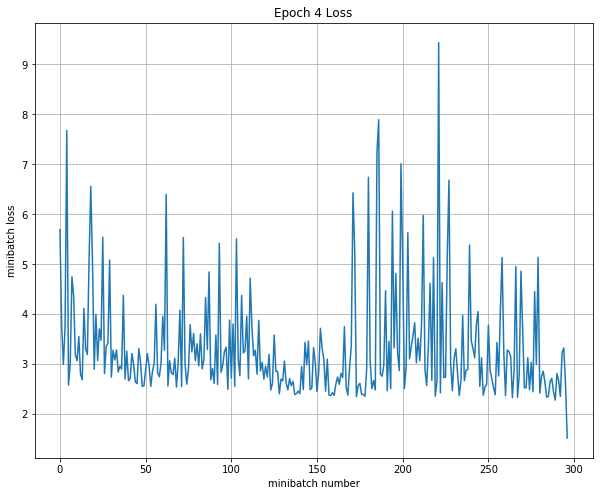

Iteration 1200: with minibatch training loss = 0.405 and accuracy of 1
Iteration 1300: with minibatch training loss = 0.456 and accuracy of 1
Iteration 1400: with minibatch training loss = 0.467 and accuracy of 1
Epoch 5, Overall loss = 0.485 and accuracy of 0.958


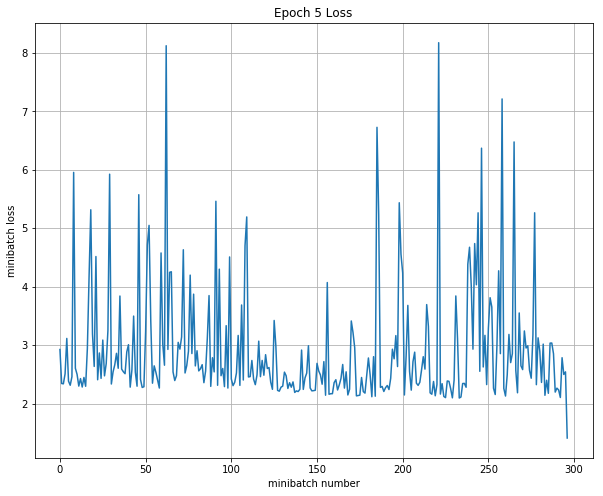

Iteration 1500: with minibatch training loss = 0.347 and accuracy of 1
Iteration 1600: with minibatch training loss = 0.357 and accuracy of 1
Iteration 1700: with minibatch training loss = 0.511 and accuracy of 0.83
Epoch 6, Overall loss = 0.432 and accuracy of 0.97


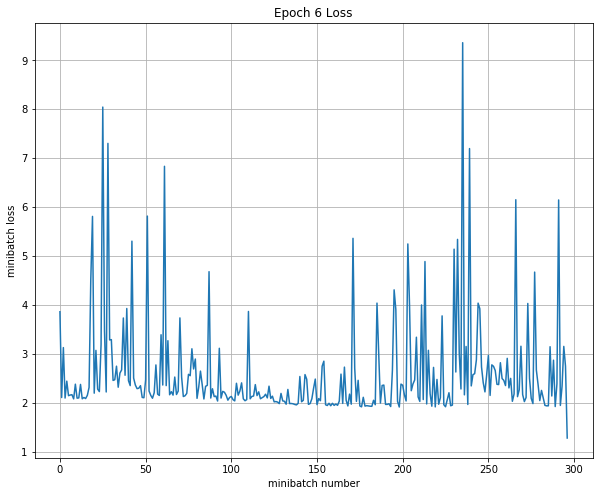

Iteration 1800: with minibatch training loss = 0.496 and accuracy of 1
Iteration 1900: with minibatch training loss = 0.312 and accuracy of 1
Iteration 2000: with minibatch training loss = 0.558 and accuracy of 0.83
Epoch 7, Overall loss = 0.397 and accuracy of 0.972


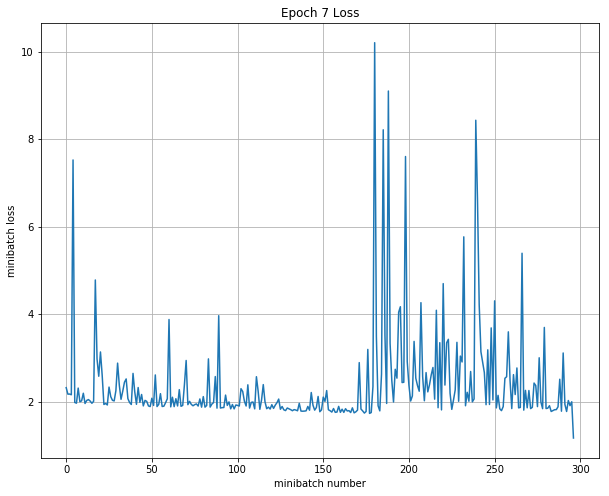

Iteration 2100: with minibatch training loss = 0.925 and accuracy of 0.67
Iteration 2200: with minibatch training loss = 0.285 and accuracy of 1
Iteration 2300: with minibatch training loss = 0.359 and accuracy of 1
Epoch 8, Overall loss = 0.343 and accuracy of 0.979


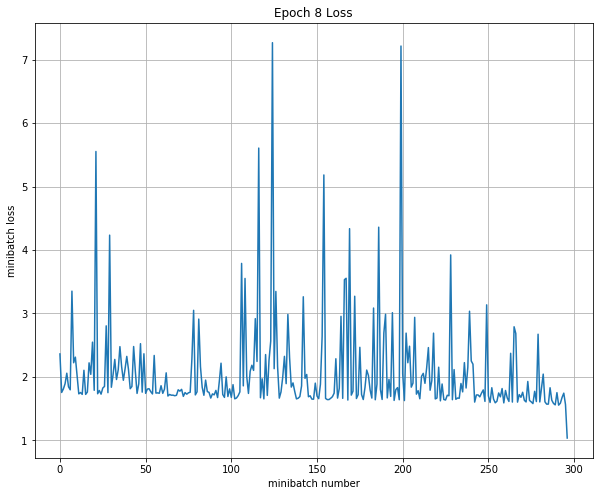

Iteration 2400: with minibatch training loss = 0.253 and accuracy of 1
Iteration 2500: with minibatch training loss = 0.244 and accuracy of 1
Iteration 2600: with minibatch training loss = 0.247 and accuracy of 1
Epoch 9, Overall loss = 0.29 and accuracy of 0.983


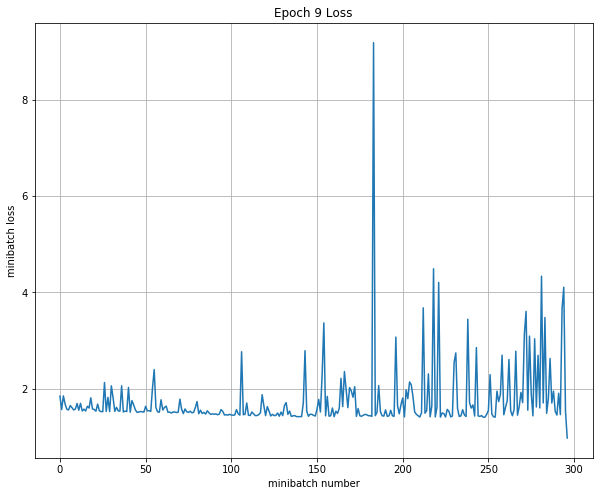

Iteration 2700: with minibatch training loss = 0.243 and accuracy of 1
Iteration 2800: with minibatch training loss = 0.241 and accuracy of 1
Iteration 2900: with minibatch training loss = 0.258 and accuracy of 1
Epoch 10, Overall loss = 0.311 and accuracy of 0.976


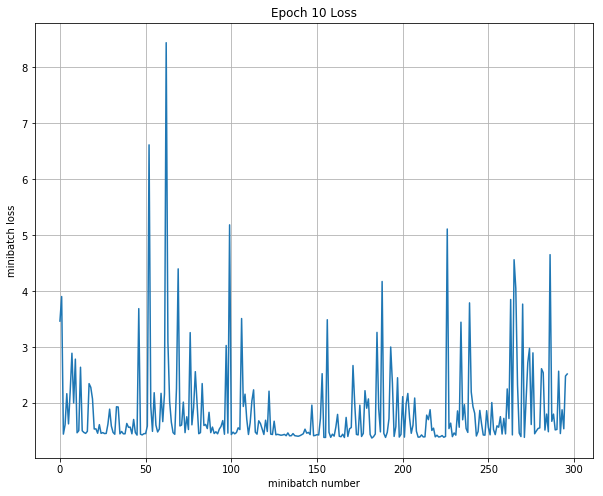

Validation
Epoch 1, Overall loss = 0.468 and accuracy of 0.92
Test
Epoch 1, Overall loss = 0.298 and accuracy of 0.98

--------------------------------------------------------------------------------
Trial number: 14
--------------------------------------------------------------------------------
reg: 0.310457, lr: 0.000007, dr: 0.856410, dc: 824, FC_size: 100 
INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


INFO:tensorflow:Restoring parameters from cs231n/datasets/squeezenet.ckpt


Train last layer
Iteration 0: with minibatch training loss = 33.5 and accuracy of 0.33
Iteration 100: with minibatch training loss = 24 and accuracy of 0.33
Iteration 200: with minibatch training loss = 17.7 and accuracy of 0.17
Epoch 1, Overall loss = 21.5 and accuracy of 0.333


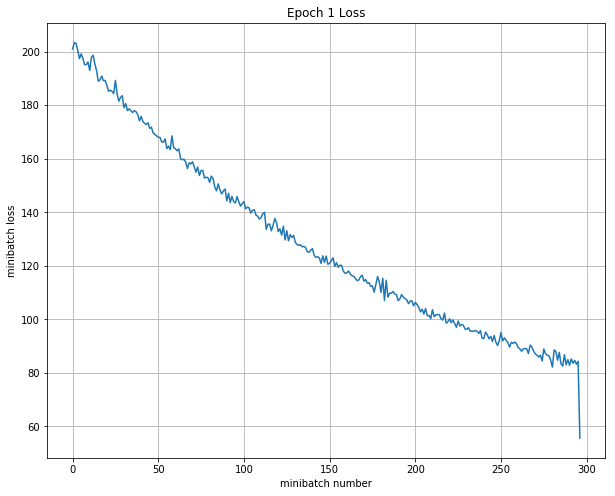

Iteration 300: with minibatch training loss = 13.4 and accuracy of 0.83
Iteration 400: with minibatch training loss = 11.3 and accuracy of 0.33
Iteration 500: with minibatch training loss = 9.39 and accuracy of 0.5
Epoch 2, Overall loss = 10.7 and accuracy of 0.372


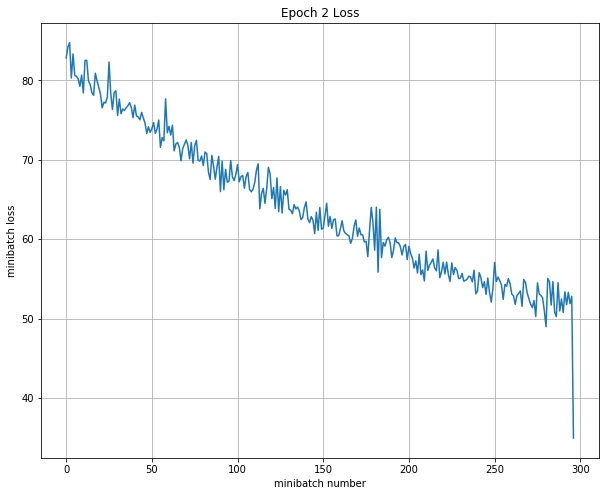

Iteration 600: with minibatch training loss = 8.39 and accuracy of 0.5
Iteration 700: with minibatch training loss = 7.94 and accuracy of 0.17
Iteration 800: with minibatch training loss = 7.2 and accuracy of 0.5
Epoch 3, Overall loss = 7.5 and accuracy of 0.397


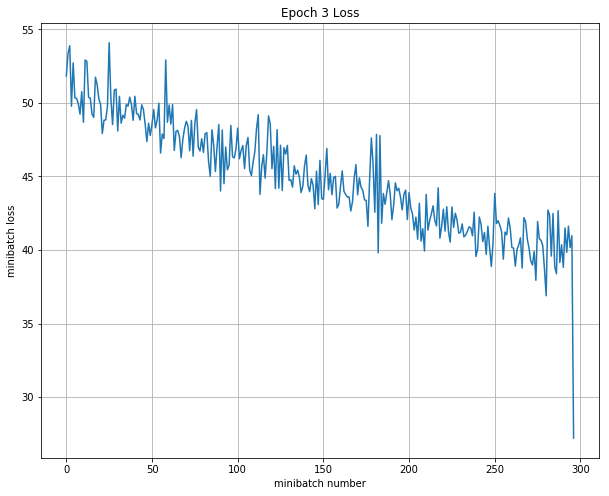

Iteration 900: with minibatch training loss = 6.56 and accuracy of 0.5
Iteration 1000: with minibatch training loss = 6.14 and accuracy of 0.33
Iteration 1100: with minibatch training loss = 5.37 and accuracy of 0.83
Epoch 4, Overall loss = 6.04 and accuracy of 0.412


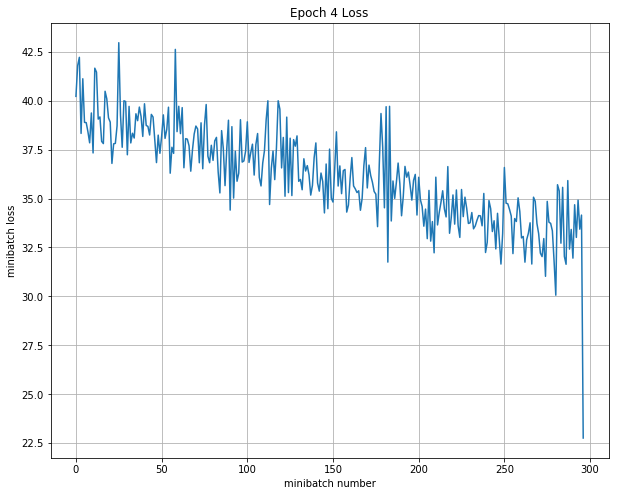

Iteration 1200: with minibatch training loss = 5.81 and accuracy of 0.33
Iteration 1300: with minibatch training loss = 5.7 and accuracy of 0
Iteration 1400: with minibatch training loss = 4.87 and accuracy of 0.83
Epoch 5, Overall loss = 5.11 and accuracy of 0.42


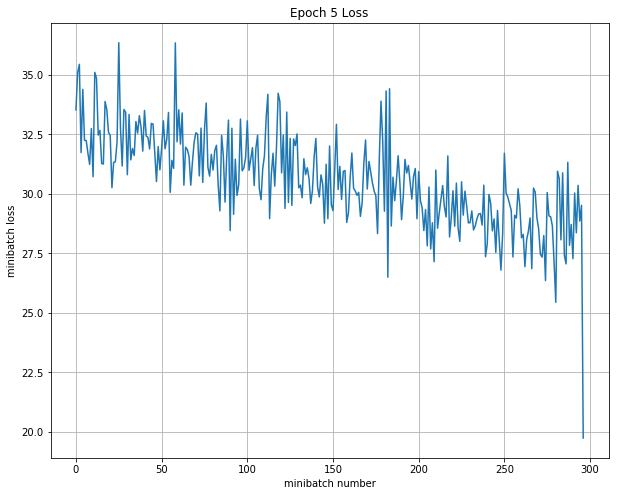

Iteration 1500: with minibatch training loss = 4.45 and accuracy of 0.5
Iteration 1600: with minibatch training loss = 4.62 and accuracy of 0.5
Iteration 1700: with minibatch training loss = 4.31 and accuracy of 0.17
Epoch 6, Overall loss = 4.46 and accuracy of 0.424


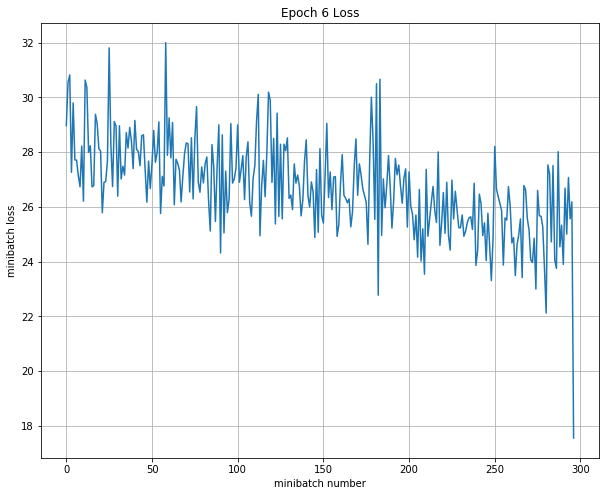

Iteration 1800: with minibatch training loss = 4.3 and accuracy of 0.33
Iteration 1900: with minibatch training loss = 4.54 and accuracy of 0.33
Iteration 2000: with minibatch training loss = 3.65 and accuracy of 0.33
Epoch 7, Overall loss = 3.98 and accuracy of 0.428


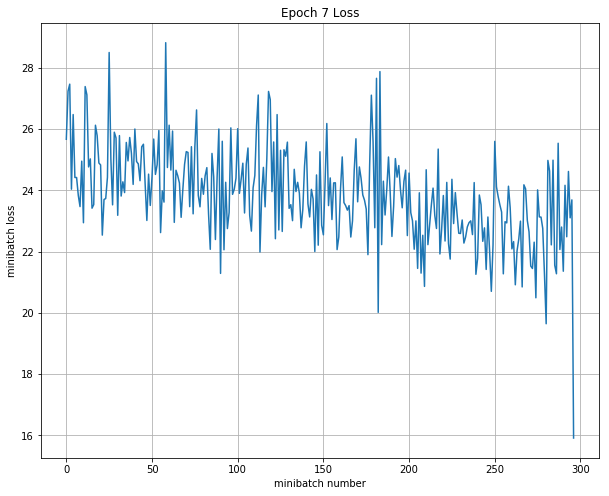

Iteration 2100: with minibatch training loss = 3.35 and accuracy of 0.67
Iteration 2200: with minibatch training loss = 3.89 and accuracy of 0.33
Iteration 2300: with minibatch training loss = 3.38 and accuracy of 0.33
Epoch 8, Overall loss = 3.62 and accuracy of 0.431


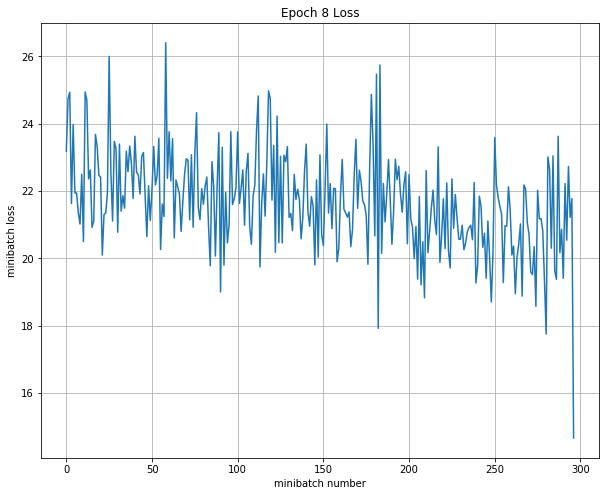

Iteration 2400: with minibatch training loss = 3.35 and accuracy of 0.33
Iteration 2500: with minibatch training loss = 3.12 and accuracy of 0.67
Iteration 2600: with minibatch training loss = 3.02 and accuracy of 0.83
Epoch 9, Overall loss = 3.33 and accuracy of 0.437


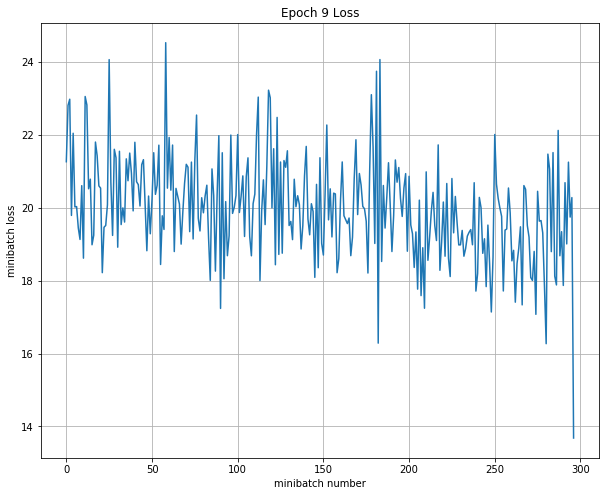

Iteration 2700: with minibatch training loss = 2.96 and accuracy of 0.83
Iteration 2800: with minibatch training loss = 3.32 and accuracy of 0.33
Iteration 2900: with minibatch training loss = 3.17 and accuracy of 0.33
Epoch 10, Overall loss = 3.11 and accuracy of 0.438


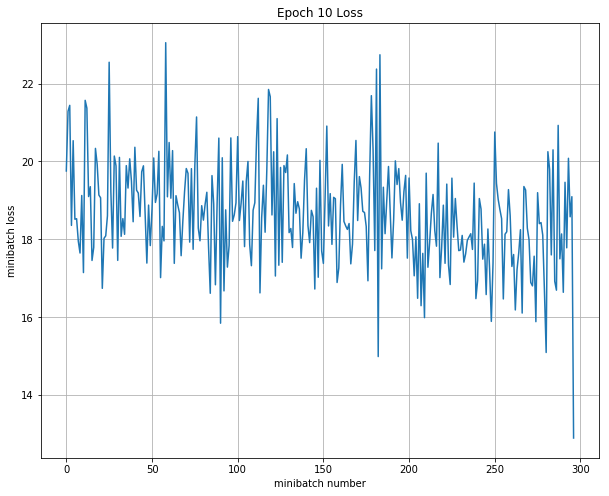

Train all layer
Iteration 0: with minibatch training loss = 2.94 and accuracy of 0.67
Iteration 100: with minibatch training loss = 3.04 and accuracy of 0.5
Iteration 200: with minibatch training loss = 2.33 and accuracy of 0.67
Epoch 1, Overall loss = 2.77 and accuracy of 0.553


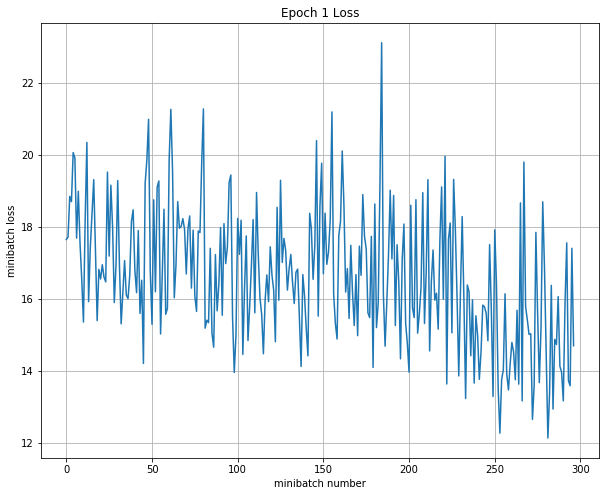

Iteration 300: with minibatch training loss = 2.47 and accuracy of 0.5
Iteration 400: with minibatch training loss = 1.93 and accuracy of 1
Iteration 500: with minibatch training loss = 2.22 and accuracy of 0.83
Epoch 2, Overall loss = 2.39 and accuracy of 0.69


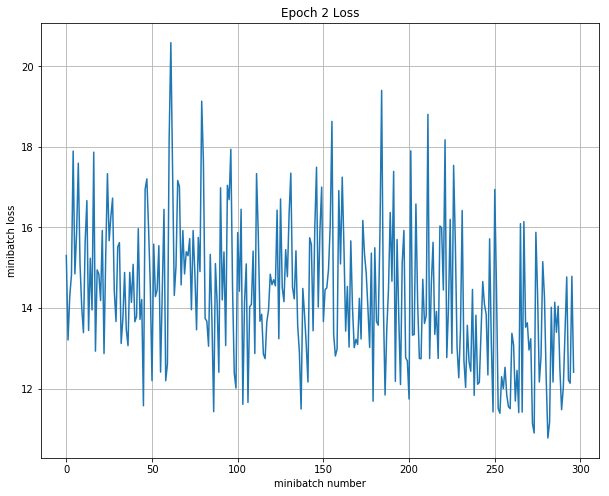

Iteration 600: with minibatch training loss = 2.4 and accuracy of 0.67
Iteration 700: with minibatch training loss = 1.68 and accuracy of 1
Iteration 800: with minibatch training loss = 1.95 and accuracy of 0.83
Epoch 3, Overall loss = 2.1 and accuracy of 0.777


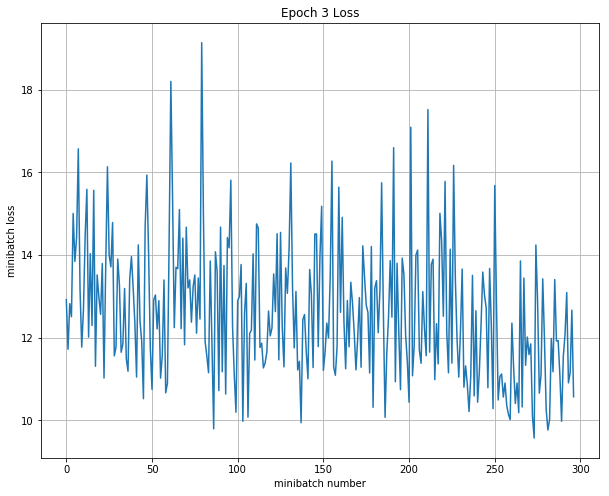

Iteration 900: with minibatch training loss = 1.76 and accuracy of 1
Iteration 1000: with minibatch training loss = 2.04 and accuracy of 0.67
Iteration 1100: with minibatch training loss = 1.81 and accuracy of 0.83
Epoch 4, Overall loss = 1.89 and accuracy of 0.831


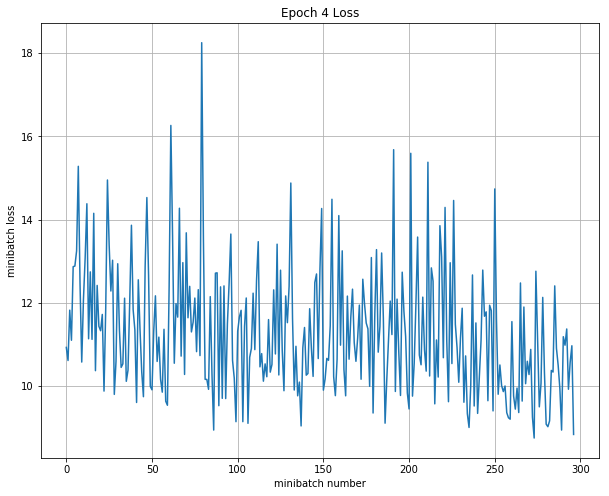

Iteration 1200: with minibatch training loss = 2.2 and accuracy of 0.5
Iteration 1300: with minibatch training loss = 2.06 and accuracy of 0.83
Iteration 1400: with minibatch training loss = 1.52 and accuracy of 1
Epoch 5, Overall loss = 1.71 and accuracy of 0.866


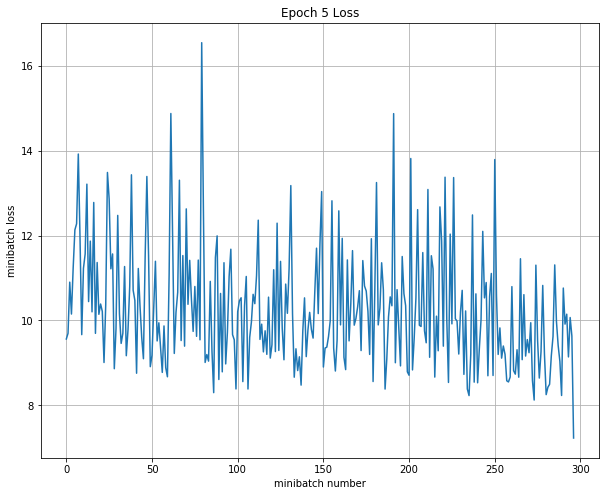

Iteration 1500: with minibatch training loss = 1.57 and accuracy of 1
Iteration 1600: with minibatch training loss = 1.43 and accuracy of 0.83
Iteration 1700: with minibatch training loss = 1.33 and accuracy of 1
Epoch 6, Overall loss = 1.57 and accuracy of 0.893


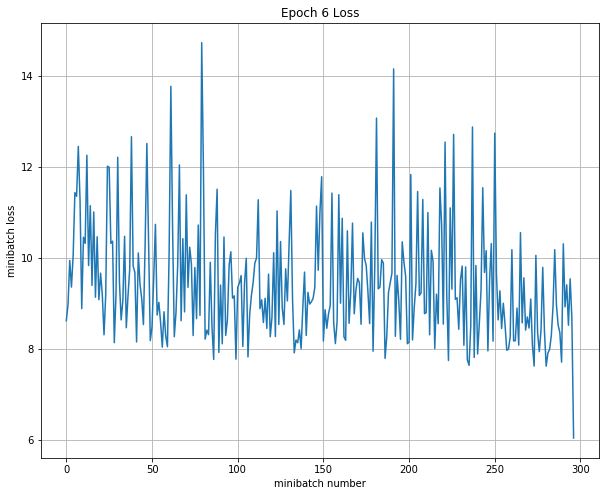

Iteration 1800: with minibatch training loss = 1.64 and accuracy of 0.83
Iteration 1900: with minibatch training loss = 1.48 and accuracy of 0.83
Iteration 2000: with minibatch training loss = 1.76 and accuracy of 0.67
Epoch 7, Overall loss = 1.45 and accuracy of 0.907


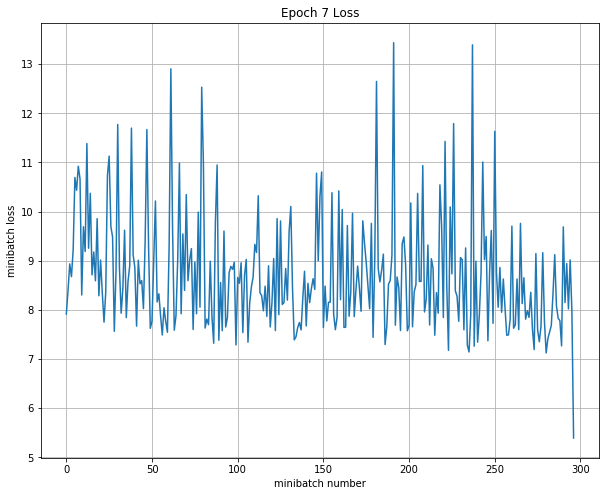

Iteration 2100: with minibatch training loss = 1.29 and accuracy of 1
Iteration 2200: with minibatch training loss = 1.36 and accuracy of 0.83
Iteration 2300: with minibatch training loss = 1.74 and accuracy of 0.67
Epoch 8, Overall loss = 1.36 and accuracy of 0.924


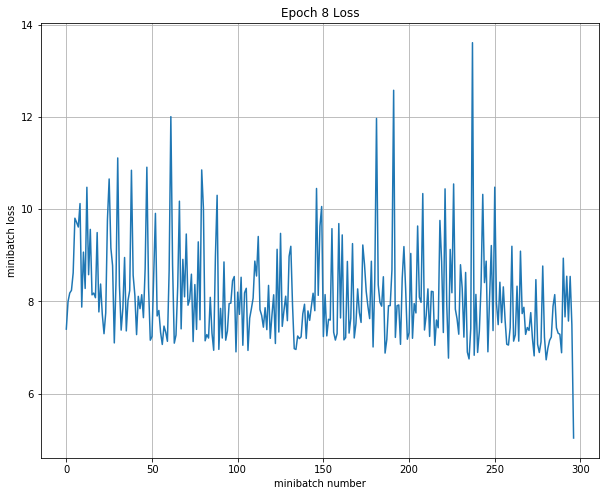

Iteration 2400: with minibatch training loss = 1.54 and accuracy of 0.83
Iteration 2500: with minibatch training loss = 1.14 and accuracy of 1
Iteration 2600: with minibatch training loss = 1.4 and accuracy of 0.83
Epoch 9, Overall loss = 1.28 and accuracy of 0.935


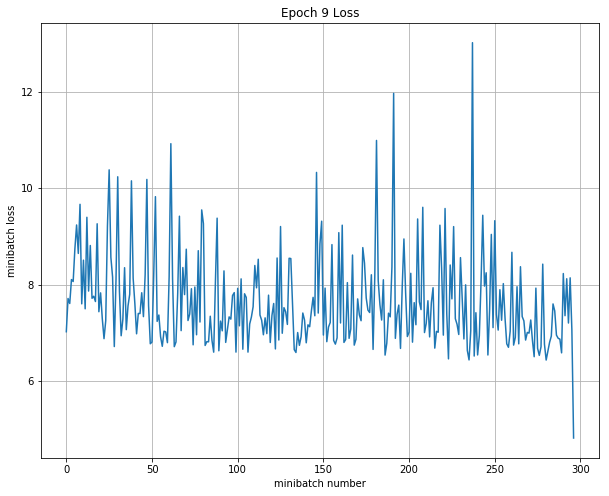

Iteration 2700: with minibatch training loss = 1.27 and accuracy of 1
Iteration 2800: with minibatch training loss = 1.17 and accuracy of 1
Iteration 2900: with minibatch training loss = 1.12 and accuracy of 1
Epoch 10, Overall loss = 1.21 and accuracy of 0.947


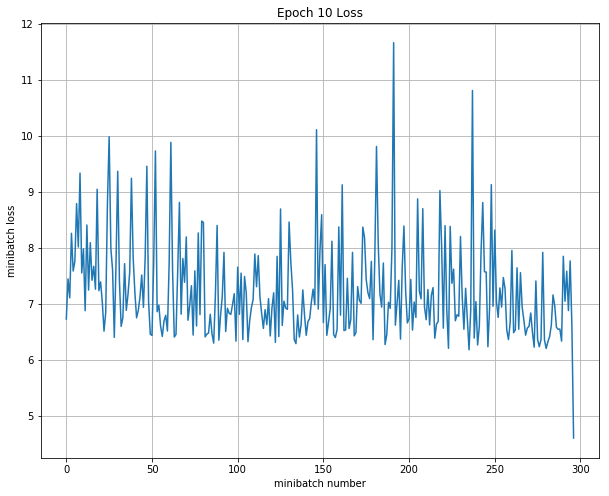

Validation
Epoch 1, Overall loss = 1.49 and accuracy of 0.9
Test
Epoch 1, Overall loss = 1.34 and accuracy of 0.92

--------------------------------------------------------------------------------
Conslusion
--------------------------------------------------------------------------------
Best hyperparam for rg, lr, dr, dc, FC_size is
[0.5950272302273748, 1.3960753002582258e-05, 0.7678194485920209, 614, 100]
Best validation accuracy is 0.940000
Best test accuracy is 0.840000


In [6]:
best_acc = 0
test_acc = 0
best_sess = None
best_hyper = None
best_model = None
best_mean_loss = None
with tf.device("/gpu:0") as dev:
    for i in range(15):
        rg = 10**np.random.uniform(-3,1) # regularization
        lr = 10**np.random.uniform(-6,-2) # learning rate
        dr = np.random.uniform(0.75,1) # decay rate
        dc = np.random.randint(500,1000) # decay cut
        FC_size = 100
        # FC_size = np.random.randint(100,150) # decay cut
        print ('')
        print ('-'*80)
        print ('Trial number: %d' %i)
        print ('-'*80)
        print ('reg: %f, lr: %f, dr: %f, dc: %d, FC_size: %d ' %(rg, lr, dr, dc, FC_size))
        sess, model, mean_loss, train_step_last_layer, train_step_all_layer = my_model(rg, lr, dr, dc, FC_size)
        sess.run(tf.global_variables_initializer())
        print('Train last layer')
        run_model(sess,model,mean_loss,x_train,y_train,10,6,100,train_step_last_layer,True)
        print('Train all layer')
        run_model(sess,model,mean_loss,x_train,y_train,10,6,100,train_step_all_layer,True)
        print('Validation')
        _, val_acc = run_model(sess,model,mean_loss,x_val,y_val,1,200)
        print('Test')
        _, test_acc = run_model(sess,model,mean_loss,x_test,y_test,1,200) 
        if val_acc > best_acc:
            best_sess = sess
            best_model = model
            best_mean_loss = mean_loss
            best_acc = val_acc
            best_hyper = [rg, lr, dr, dc, FC_size] 
            test_under_best_val = test_acc
    print ('')
    print ('-'*80)
    print ('Conslusion')
    print ('-'*80)
    print ('Best hyperparam for rg, lr, dr, dc, FC_size is')
    print (best_hyper)
    print ('Best validation accuracy is %f' %best_acc)
    print ('Best test accuracy is %f' %test_under_best_val)
    

# test result

In [ ]:
print('Test')
_, test_acc = run_model(best_sess,best_model,best_mean_loss,x_test,y_test,1,200) 